<a href="https://colab.research.google.com/github/thuc-github/MIS710-T12023/blob/main/Week%204/MIS710_Lab_4_Logistic_Reg-Solution.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **1. Logistic Regression**



## **1.1 Import Libraries**

In [ ]:
# Import libraries
import pandas as pd #for data manipulation and analysis
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for model evaluation
from sklearn.metrics import precision_recall_curve, precision_recall_curve, classification_report
from sklearn.metrics import classification_report, confusion_matrix

## **1.2 Load and Inspect Data**


1.   Load the dataset
2.   Explore the data



In [ ]:
# prompt: connect with my drive

from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# load dataset
records = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/dataset/LA4Schools.csv')

# explore the dataset
print(records)

      StudentID  TextLevel-01-SOY  TextLevel-01-MOY  TextLevel-01-EOY  \
0     384710734                16                18                25   
1     504699264                 8                12                17   
2     332227462                 8                12                18   
3     245262793                11                16                25   
4     331173944                 9                12                17   
...         ...               ...               ...               ...   
1995  206621792                11                12                21   
1996  580634396                25                23                29   
1997  292318865                12                13                27   
1998  980825152                12                18                26   
1999  586342941                 5                 5                18   

      TextLevel-02-SOY  TextLevel-02-MOY  TextLevel-02-EOY  \
0                   25                30                32   

In [ ]:
# What does the following code do?
print(records[50:70])

    StudentID  TextLevel-01-SOY  TextLevel-01-MOY  TextLevel-01-EOY  \
50  557220837                16                20                24   
51  207631062                12                13                22   
52  262159897                 3                 9                22   
53  348103590                13                13                19   
54  822164884                10                18                27   
55  224234970                 1                17                17   
56  743427649                 4                 9                16   
57  272747057                 5                14                22   
58  521348728                 1                19                18   
59  807668599                12                15                24   
60  990255653                 9                13                22   
61  722093877                15                15                18   
62  272470697                 1                10                13   
63  26

In [ ]:
##write your code to inspect the dataset shape, variables and data types.
records.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   StudentID                       2000 non-null   int64  
 1   TextLevel-01-SOY                2000 non-null   int64  
 2   TextLevel-01-MOY                2000 non-null   int64  
 3   TextLevel-01-EOY                2000 non-null   int64  
 4   TextLevel-02-SOY                2000 non-null   int64  
 5   TextLevel-02-MOY                2000 non-null   int64  
 6   TextLevel-02-EOY                2000 non-null   int64  
 7   WritingVocab-01-SOY             2000 non-null   int64  
 8   HRSIW-01-SOY                    2000 non-null   int64  
 9   Counting-01                     2000 non-null   int64  
 10  Counting-02                     2000 non-null   int64  
 11  Place Value-01                  2000 non-null   int64  
 12  Place Value-02                  20

### **Inspect missing data**

In [ ]:
##write your code to inspect missing data
records.isnull().sum()

,0
StudentID,0
TextLevel-01-SOY,0
TextLevel-01-MOY,0
TextLevel-01-EOY,0
TextLevel-02-SOY,0
TextLevel-02-MOY,0
TextLevel-02-EOY,0
WritingVocab-01-SOY,0
HRSIW-01-SOY,0
Counting-01,0


In [ ]:
#What does the code below do?
print('Sample size:', records.shape[0])
print('Number of columns:', records.shape[1])


Sample size: 2000
Number of columns: 34


In [ ]:
##write your code to view descriptive statistics of all numeric variables, hint: use describe()
records.describe()

,StudentID,TextLevel-01-SOY,TextLevel-01-MOY,TextLevel-01-EOY,TextLevel-02-SOY,TextLevel-02-MOY,TextLevel-02-EOY,WritingVocab-01-SOY,HRSIW-01-SOY,Counting-01,...,Disability_SocialEmotional,NCCD-Funded,NumSibling,SiblingOrder,01.SES,02.SES,NumAbvYear9,NumAbvDiploma,NumProf,Year_02
count,2.000000e+03,2000.00000,2000.000000,2000.0000,2000.000000,2000.00000,2000.000000,2000.000000,2000.000000,2000.000000,...,2000.000000,2000.000000,2000.000000,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,5.459580e+08,10.69900,15.001500,21.1300,21.786500,24.07300,26.998500,22.018500,30.508000,1.758000,...,0.036500,0.089000,2.356500,1.748500,102.9415,102.117500,1.564000,0.886500,0.766500,2018.640000
std,2.580928e+08,6.10082,5.489496,4.5786,5.220205,4.69134,3.765314,12.679098,10.020686,0.935881,...,0.187578,0.284815,0.993932,0.865229,9.3859,9.150167,0.725374,0.837836,0.811977,1.664568
min,1.006692e+08,-4.00000,0.000000,4.0000,2.000000,5.00000,5.000000,0.000000,-3.000000,0.000000,...,0.000000,0.000000,1.000000,1.000000,78.0000,78.000000,0.000000,0.000000,0.000000,2016.000000
25%,3.163839e+08,6.00000,11.000000,18.0000,18.000000,21.00000,25.000000,13.000000,25.000000,1.000000,...,0.000000,0.000000,2.000000,1.000000,95.0000,95.000000,1.000000,0.000000,0.000000,2017.000000
50%,5.469370e+08,10.00000,14.000000,21.0000,22.000000,24.00000,28.000000,20.000000,32.000000,2.000000,...,0.000000,0.000000,2.000000,2.000000,101.0000,101.000000,2.000000,1.000000,1.000000,2018.000000
75%,7.670611e+08,14.00000,18.000000,24.0000,25.000000,28.00000,30.000000,29.000000,37.000000,2.000000,...,0.000000,0.000000,3.000000,2.000000,113.0000,109.000000,2.000000,2.000000,1.000000,2020.000000
max,9.998723e+08,34.00000,33.000000,34.0000,36.000000,34.00000,33.000000,95.000000,58.000000,5.000000,...,1.000000,1.000000,7.000000,6.000000,120.0000,120.000000,3.000000,2.000000,2.000000,2021.000000


In [ ]:
#What does the below show?
records

,StudentID,TextLevel-01-SOY,TextLevel-01-MOY,TextLevel-01-EOY,TextLevel-02-SOY,TextLevel-02-MOY,TextLevel-02-EOY,WritingVocab-01-SOY,HRSIW-01-SOY,Counting-01,...,NCCD-Funded,NumSibling,SiblingOrder,01.SES,02.SES,NumAbvYear9,NumAbvDiploma,NumProf,Year_02,At_Risk_Numeracy
0,384710734,16,18,25,25,30,32,20,49,4,...,0,3,3,104,104,2,1,2,2020,False
1,504699264,8,12,17,19,18,21,40,37,2,...,0,2,2,112,112,2,2,2,2018,False
2,332227462,8,12,18,18,23,22,6,30,2,...,0,2,2,120,109,2,0,0,2021,False
3,245262793,11,16,25,27,26,31,41,30,2,...,0,2,1,95,93,0,0,0,2021,False
4,331173944,9,12,17,21,24,26,26,32,2,...,0,1,1,98,98,2,0,0,2021,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,206621792,11,12,21,21,26,27,42,32,1,...,0,2,1,114,114,2,1,0,2016,True
1996,580634396,25,23,29,34,31,31,51,45,2,...,0,1,1,95,93,0,0,0,2021,False
1997,292318865,12,13,27,30,30,30,29,33,1,...,0,3,2,101,101,2,0,0,2016,False
1998,980825152,12,18,26,22,27,31,44,35,2,...,0,3,1,117,108,2,2,2,2021,False


In [ ]:
#What does the code below do? Why should we do it?

records = records.drop(['StudentID'], axis=1)
records.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 33 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   TextLevel-01-SOY                2000 non-null   int64  
 1   TextLevel-01-MOY                2000 non-null   int64  
 2   TextLevel-01-EOY                2000 non-null   int64  
 3   TextLevel-02-SOY                2000 non-null   int64  
 4   TextLevel-02-MOY                2000 non-null   int64  
 5   TextLevel-02-EOY                2000 non-null   int64  
 6   WritingVocab-01-SOY             2000 non-null   int64  
 7   HRSIW-01-SOY                    2000 non-null   int64  
 8   Counting-01                     2000 non-null   int64  
 9   Counting-02                     2000 non-null   int64  
 10  Place Value-01                  2000 non-null   int64  
 11  Place Value-02                  2000 non-null   int64  
 12  Addition and Subtraction-01     20

In [ ]:
# Calculate the average of specified columns
records['Average of Literacy Y1'] = records[['TextLevel-01-SOY', 'TextLevel-01-MOY', 'TextLevel-01-EOY', 'WritingVocab-01-SOY','HRSIW-01-SOY']].mean(axis=1)
records['Average of Literacy Y2'] = records[['TextLevel-02-SOY', 'TextLevel-02-MOY', 'TextLevel-02-EOY']].mean(axis=1)
records['Average of Numeracy Y1'] = records[['Counting-01', 'Place Value-01', 'Addition and Subtraction-01', 'Multiplication and Division-01']].mean(axis=1)
records['Average of Numeracy Y2'] = records[['Counting-02', 'Place Value-02', 'Addition and Subtraction-02', 'Multiplication and Division-02']].mean(axis=1)
records['Average of Family Education'] = records[['NumAbvYear9', 'NumAbvDiploma','NumProf']].mean(axis=1)
records['Average of Disability'] = records[['Disability_Non-disable', 'Disability_Cognitive', 'Disability_Physical', 'Disability_Sensory', 'Disability_SocialEmotional']].mean(axis=1)



In [ ]:
records.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 39 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   TextLevel-01-SOY                2000 non-null   int64  
 1   TextLevel-01-MOY                2000 non-null   int64  
 2   TextLevel-01-EOY                2000 non-null   int64  
 3   TextLevel-02-SOY                2000 non-null   int64  
 4   TextLevel-02-MOY                2000 non-null   int64  
 5   TextLevel-02-EOY                2000 non-null   int64  
 6   WritingVocab-01-SOY             2000 non-null   int64  
 7   HRSIW-01-SOY                    2000 non-null   int64  
 8   Counting-01                     2000 non-null   int64  
 9   Counting-02                     2000 non-null   int64  
 10  Place Value-01                  2000 non-null   int64  
 11  Place Value-02                  2000 non-null   int64  
 12  Addition and Subtraction-01     20

In [ ]:
records.head()

,TextLevel-01-SOY,TextLevel-01-MOY,TextLevel-01-EOY,TextLevel-02-SOY,TextLevel-02-MOY,TextLevel-02-EOY,WritingVocab-01-SOY,HRSIW-01-SOY,Counting-01,Counting-02,...,NumAbvDiploma,NumProf,Year_02,At_Risk_Numeracy,Average of Literacy Y1,Average of Literacy Y2,Average of Numeracy Y1,Average of Numeracy Y2,Average of Family Education,Average of Disability
0,16,18,25,25,30,32,20,49,4,5,...,1,2,2020,False,25.6,29.000000,2.50,3.25,1.666667,0.2
1,8,12,17,19,18,21,40,37,2,1,...,2,2,2018,False,22.8,19.333333,1.25,1.75,2.000000,0.2
2,8,12,18,18,23,22,6,30,2,1,...,0,0,2021,False,14.8,21.000000,1.75,1.25,0.666667,0.2
3,11,16,25,27,26,31,41,30,2,3,...,0,0,2021,False,24.6,28.000000,1.50,3.00,0.000000,0.2
4,9,12,17,21,24,26,26,32,2,4,...,0,0,2021,False,19.2,23.666667,1.75,2.75,0.666667,0.2


### **Convert categorical data to numeric**


In [ ]:
records['At_Risk_Numeracy'] = records['At_Risk_Numeracy'].astype(int)


In [ ]:
#Convert categorical variables to numeric
#Define the custom mapping
diagnosis_mapping = {
    'FALSE': 0,
    'TRUE': 1,
}
# Convert the categories to numerical values using replace()
records['At_Risk_Numeracy'] = records['At_Risk_Numeracy'].replace(diagnosis_mapping)

In [ ]:
#Convert categorical variables to numeric
#Define the custom mapping
diagnosis_mapping = {
    'Male': 0,
    'Female': 1,
}
# Convert the categories to numerical values using replace()
records['Gender'] = records['Gender'].replace(diagnosis_mapping)

<ipython-input-264-b7a0a0dce65d>:8: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  records['Gender'] = records['Gender'].replace(diagnosis_mapping)


In [ ]:
print(records.sample(10))

      TextLevel-01-SOY  TextLevel-01-MOY  TextLevel-01-EOY  TextLevel-02-SOY  \
1022                11                19                22                25   
99                  31                30                31                31   
793                  6                17                24                25   
1052                 7                 9                19                16   
1309                 8                 9                17                18   
1685                 5                10                20                21   
702                 19                24                25                26   
1386                10                14                21                19   
203                 15                15                20                23   
453                 16                16                23                18   

      TextLevel-02-MOY  TextLevel-02-EOY  WritingVocab-01-SOY  HRSIW-01-SOY  \
1022                25                30

In [ ]:
print(records['At_Risk_Numeracy'].unique())


[0 1]


In [ ]:
#alternatively, you can convert categorical data to numerical as follows
# def coding_diagnosis(x):
#     if x=='FALSE': return 1
#     if x=='TRUE': return 0

# records['At_Risk_Numeracy'] = records['At_Risk_Numeracy'].apply(coding_diagnosis)

# print(records.sample(10))


### **Outliers Handling**


## **1.3 Conduct Exploratory Data Analysis EDA**
1. Univariate analysis
2. Bivariate analysis
3. Multivariate analysis

Note:
> Numeric variables
*   Summarise data through mean, median (Q2), Q1, Q3, range, Interquartile Range (IQR), outliers, standard deviation, and variance.
*   Explore distributions using histograms, boxplots, kernel density estimates, and QQ plots of continuous variables.

> Categorical variables
*   Summarise data through mode(s), counts and percentages of unique categories.
*   Explore bar charts, pie charts, or frequency tables of categorical variables.

> Explore relationships between two or more variables  
*   Compare two continuous variables using their descriptive statistics (such as means, medians, and Inter Quartile Range (IQR), range) and explore the relationship between them using scatterplots and correlation coefficients.
*   Explore the relationship between two categorical variables using a two-way contingency table (crosstab), clustered bar charts, stacked bar charts or a mosaic plot.
*   Explore the relationship between one numeric and one categorical variable, through using and grouped boxplots, violin plots, and histograms.
*   Explore correlations among multiple (selected) numeric variables using heatmaps of the correlation matrix.


3. Convert data as needed
You can also explore logistic regression relationships between two variables.


**Univariate Analysis**

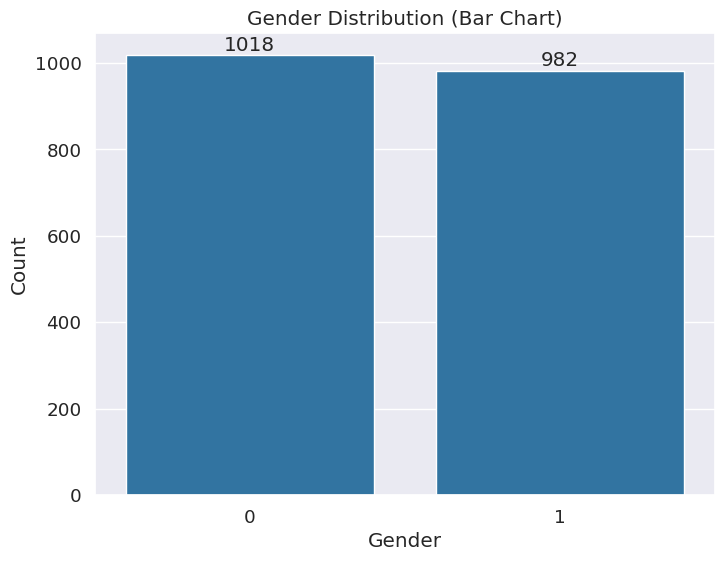

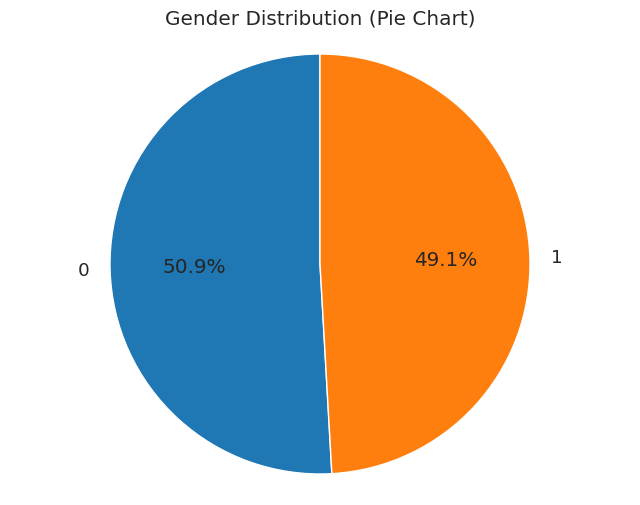

In [ ]:
# prompt: Gender: bar chart and pie chart, including data label

import pandas as pd #for data manipulation and analysis
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'records' DataFrame is already loaded as in your provided code

# Bar chart for Gender distribution
plt.figure(figsize=(8, 6))
gender_counts = records['Gender'].value_counts()
sns.barplot(x=gender_counts.index, y=gender_counts.values)
plt.title('Gender Distribution (Bar Chart)')
plt.xlabel('Gender')
plt.ylabel('Count')

# Add data labels on top of each bar
for i, v in enumerate(gender_counts.values):
    plt.text(i, v + 1, str(v), ha='center', va='bottom')

plt.show()

# Pie chart for Gender distribution
plt.figure(figsize=(8, 6))
plt.pie(gender_counts, labels=gender_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Gender Distribution (Pie Chart)')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()


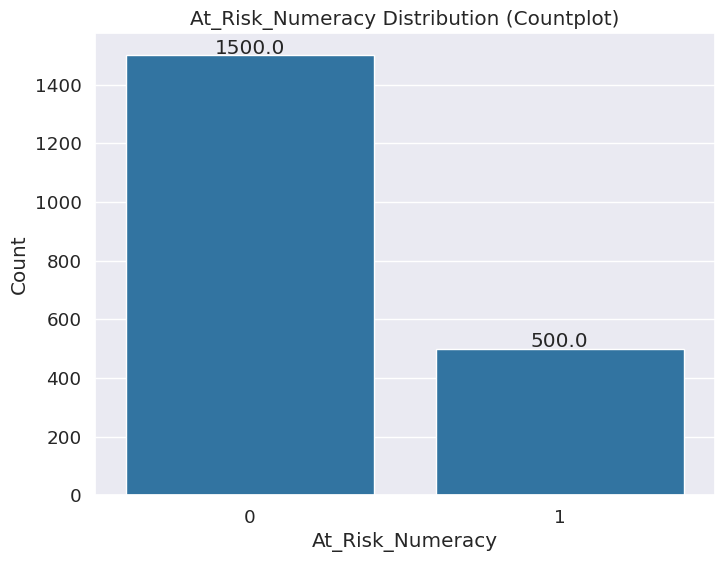

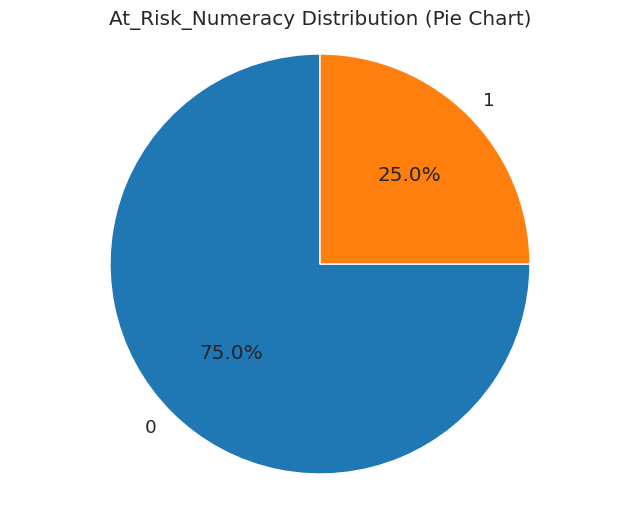

Description of At_Risk_Numeracy:
count    2000.000000
mean        0.250000
std         0.433121
min         0.000000
25%         0.000000
50%         0.000000
75%         0.250000
max         1.000000
Name: At_Risk_Numeracy, dtype: float64


In [ ]:
# prompt: create countplot and pie chart, and describe for At_Risk_Numeracy. Add the lables to charts

# Countplot for At_Risk_Numeracy
plt.figure(figsize=(8, 6))
sns.countplot(x='At_Risk_Numeracy', data=records)
plt.title('At_Risk_Numeracy Distribution (Countplot)')
plt.xlabel('At_Risk_Numeracy')
plt.ylabel('Count')

# Add labels to the bars
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                   ha='center', va='center', xytext=(0, 5), textcoords='offset points')

plt.show()

# Pie chart for At_Risk_Numeracy
plt.figure(figsize=(8, 6))
at_risk_counts = records['At_Risk_Numeracy'].value_counts()
plt.pie(at_risk_counts, labels=at_risk_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('At_Risk_Numeracy Distribution (Pie Chart)')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

# Description for At_Risk_Numeracy
print("Description of At_Risk_Numeracy:")
print(records['At_Risk_Numeracy'].describe())


In [ ]:
##write your code to summarise the diagnosis variable in terms of frequency using value_counts()
#Interprete the result
records['At_Risk_Numeracy'].value_counts()

,count
At_Risk_Numeracy,
0,1500
1,500


In [ ]:
#Summarise the diagnosis variable in terms of relative frequency value_counts(normalize=True)
#Interprete the result
records['At_Risk_Numeracy'].value_counts(normalize=True).round(4)

,proportion
At_Risk_Numeracy,
0,0.75
1,0.25


In [ ]:
#Interprete the outcome of the following code
records['At_Risk_Numeracy'].describe()

,At_Risk_Numeracy
count,2000.000000
mean,0.250000
std,0.433121
min,0.000000
25%,0.000000
50%,0.000000
75%,0.250000
max,1.000000


**Examine other variables**
Run the code and write down your observations

In [ ]:
records[records.columns[16:32]].describe()

,Kinder_Age,Gender,Disability_Non-disable,Disability_Cognitive,Disability_Physical,Disability_Sensory,Disability_SocialEmotional,NCCD-Funded,NumSibling,SiblingOrder,01.SES,02.SES,NumAbvYear9,NumAbvDiploma,NumProf,Year_02
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,5.276805,0.491000,0.690500,0.234500,0.033500,0.005000,0.036500,0.089000,2.356500,1.748500,102.9415,102.117500,1.564000,0.886500,0.766500,2018.640000
std,0.347251,0.500044,0.462403,0.423792,0.179983,0.070551,0.187578,0.284815,0.993932,0.865229,9.3859,9.150167,0.725374,0.837836,0.811977,1.664568
min,4.504110,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,78.0000,78.000000,0.000000,0.000000,0.000000,2016.000000
25%,5.015753,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,1.000000,95.0000,95.000000,1.000000,0.000000,0.000000,2017.000000
50%,5.282192,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,2.000000,101.0000,101.000000,2.000000,1.000000,1.000000,2018.000000
75%,5.534247,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,2.000000,113.0000,109.000000,2.000000,2.000000,1.000000,2020.000000
max,6.534247,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.000000,6.000000,120.0000,120.000000,3.000000,2.000000,2.000000,2021.000000


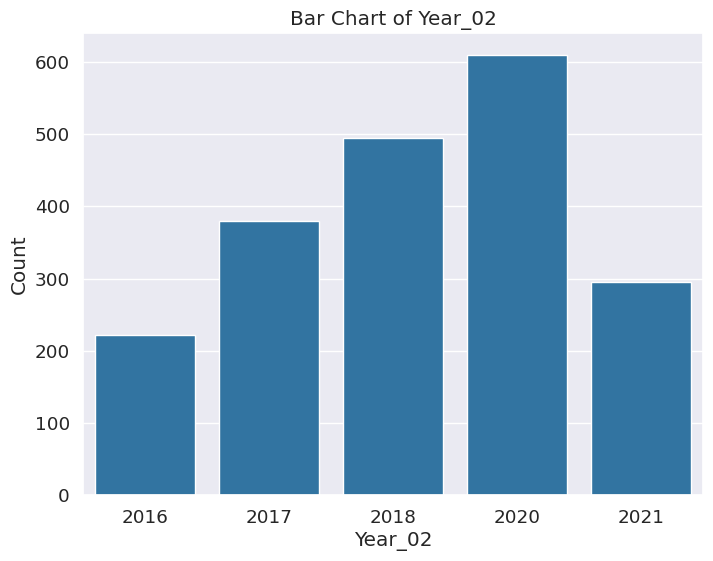

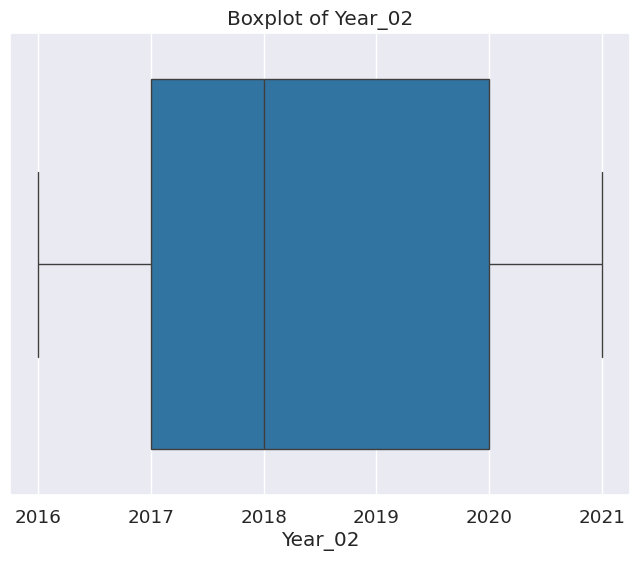

In [ ]:
# prompt: create bar chart and boxplot for Year_02

# Create a bar chart for 'Year_02'
plt.figure(figsize=(8, 6))
sns.countplot(x='Year_02', data=records)
plt.title('Bar Chart of Year_02')
plt.xlabel('Year_02')
plt.ylabel('Count')
plt.show()

# Create a boxplot for 'Year_02'
plt.figure(figsize=(8, 6))
sns.boxplot(x='Year_02', data=records)
plt.title('Boxplot of Year_02')
plt.xlabel('Year_02')
plt.show()


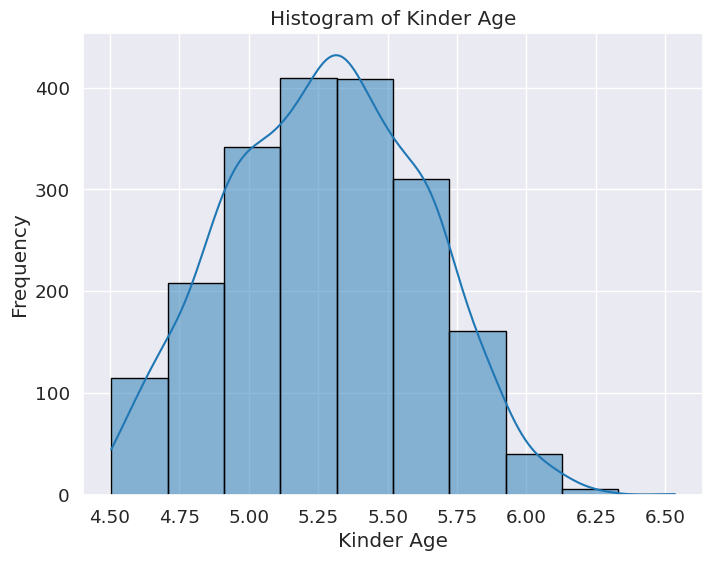

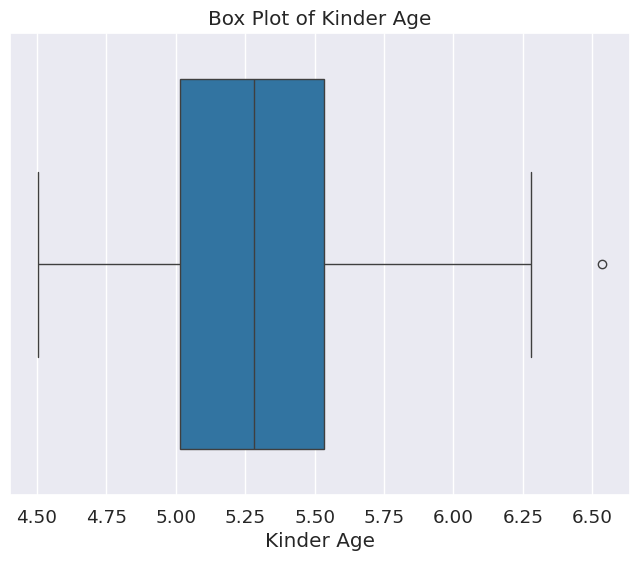

In [ ]:
# prompt: create a historam and box plot to visualize Kinder_Age

records['Kinder_Age'].describe()
# Create a histogram
plt.figure(figsize=(8, 6))
sns.histplot(records['Kinder_Age'], bins=10, kde=True, edgecolor='black')  # Adjust bins as needed
plt.xlabel('Kinder Age')
plt.ylabel('Frequency')
plt.title('Histogram of Kinder Age')
plt.show()

# Create a box plot
plt.figure(figsize=(8, 6))
sns.boxplot(x=records['Kinder_Age'])
plt.xlabel('Kinder Age')
plt.title('Box Plot of Kinder Age')
plt.show()


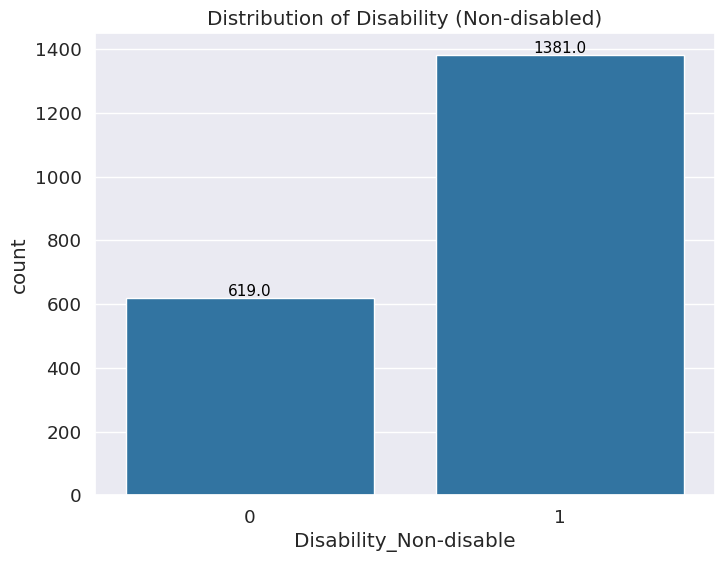

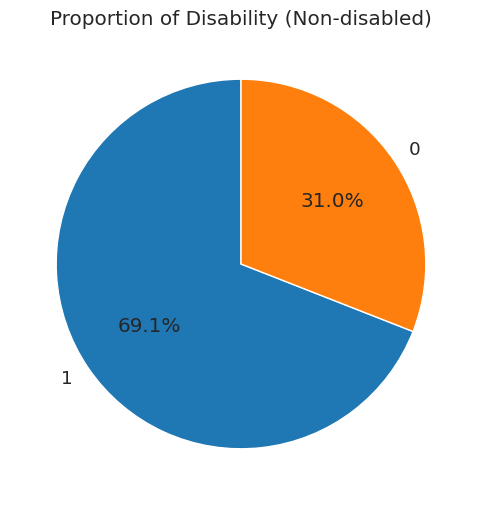

In [ ]:
# prompt: create suitable type of charts to visualize Disability_Non-disable, including data lable

import matplotlib.pyplot as plt

# Assuming 'records' DataFrame is already loaded as in your provided code.

# Count plot of Disability_Non-disable
plt.figure(figsize=(8, 6))
ax = sns.countplot(x='Disability_Non-disable', data=records)
plt.title('Distribution of Disability (Non-disabled)')

# Add data labels on top of each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=11, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()


# Pie chart of Disability_Non-disable
plt.figure(figsize=(8, 6))
records['Disability_Non-disable'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90)
plt.title('Proportion of Disability (Non-disabled)')
plt.ylabel('') # Hide the y-label
plt.show()


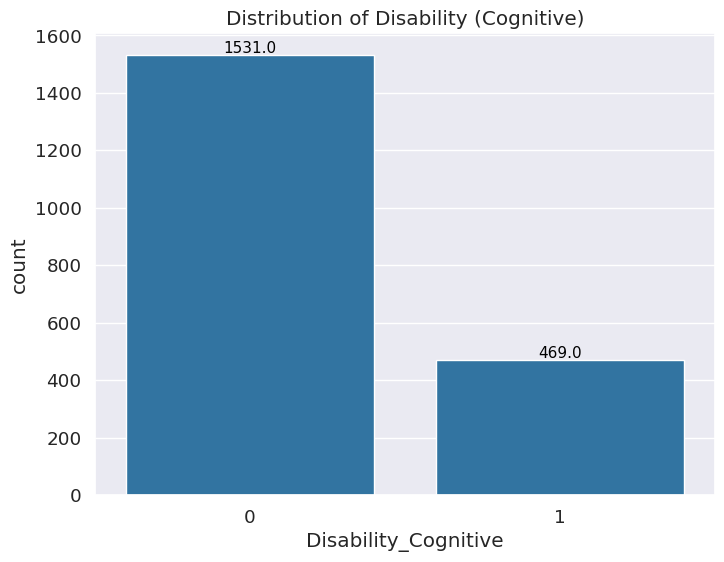

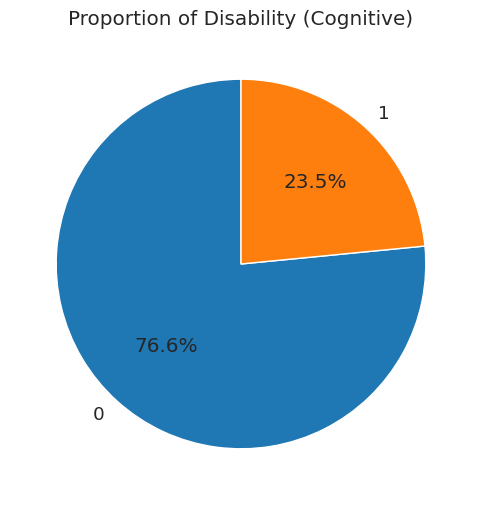

In [ ]:
# prompt: Disability_Cognitive

# Assuming 'records' DataFrame is already loaded as in your provided code.

# Count plot of Disability_Cognitive
plt.figure(figsize=(8, 6))
ax = sns.countplot(x='Disability_Cognitive', data=records)
plt.title('Distribution of Disability (Cognitive)')

# Add data labels on top of each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=11, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()


# Pie chart of Disability_Cognitive
plt.figure(figsize=(8, 6))
records['Disability_Cognitive'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90)
plt.title('Proportion of Disability (Cognitive)')
plt.ylabel('') # Hide the y-label
plt.show()


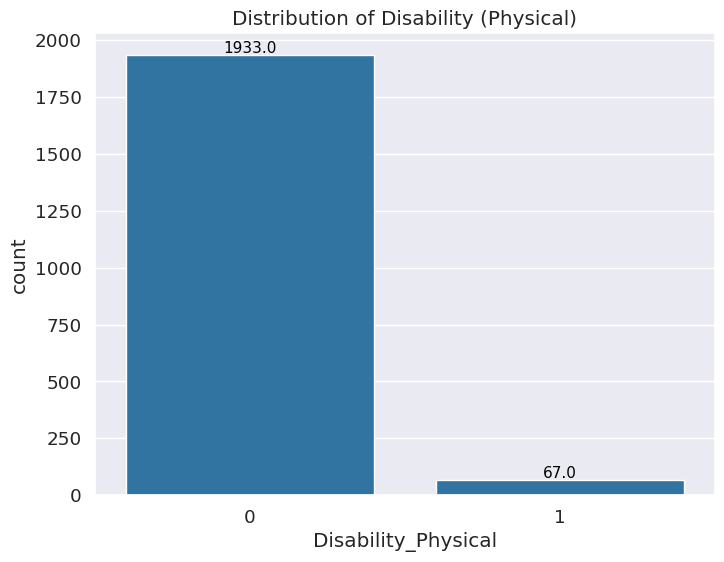

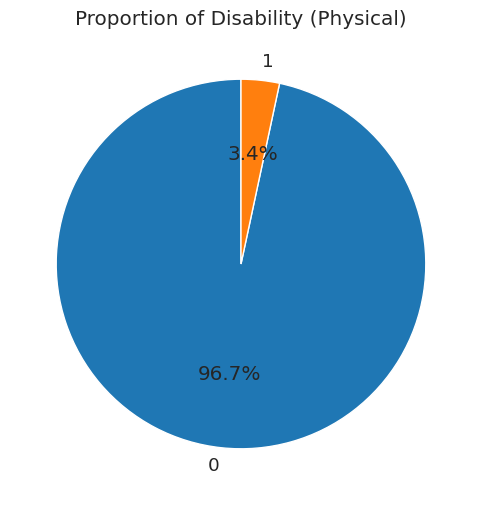

In [ ]:
# prompt: Disability_Physical

# Assuming 'records' DataFrame is already loaded as in your provided code.

# Count plot of Disability_Physical
plt.figure(figsize=(8, 6))
ax = sns.countplot(x='Disability_Physical', data=records)
plt.title('Distribution of Disability (Physical)')

# Add data labels on top of each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=11, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()


# Pie chart of Disability_Physical
plt.figure(figsize=(8, 6))
records['Disability_Physical'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90)
plt.title('Proportion of Disability (Physical)')
plt.ylabel('') # Hide the y-label
plt.show()


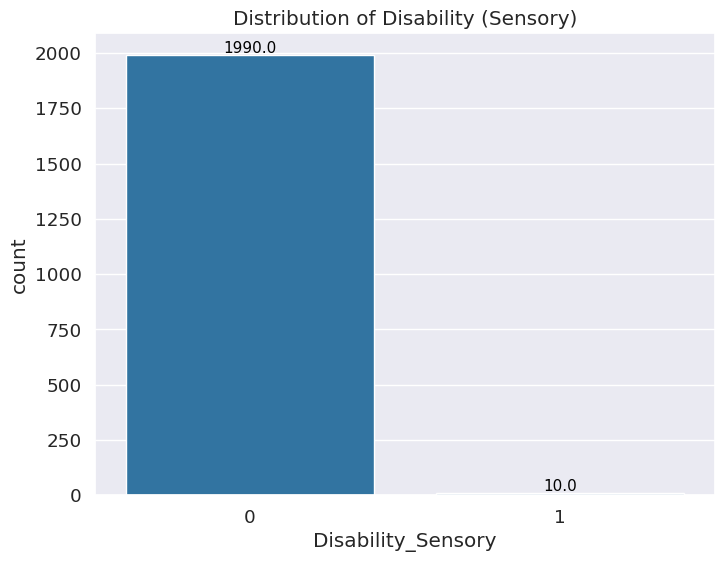

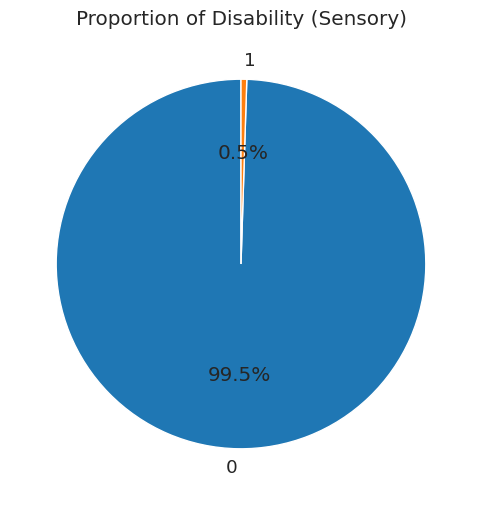

In [ ]:
# prompt: Disability_Sensory

# Assuming 'records' DataFrame is already loaded as in your provided code.

# Count plot of Disability_Sensory
plt.figure(figsize=(8, 6))
ax = sns.countplot(x='Disability_Sensory', data=records)
plt.title('Distribution of Disability (Sensory)')

# Add data labels on top of each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=11, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()


# Pie chart of Disability_Sensory
plt.figure(figsize=(8, 6))
records['Disability_Sensory'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90)
plt.title('Proportion of Disability (Sensory)')
plt.ylabel('') # Hide the y-label
plt.show()


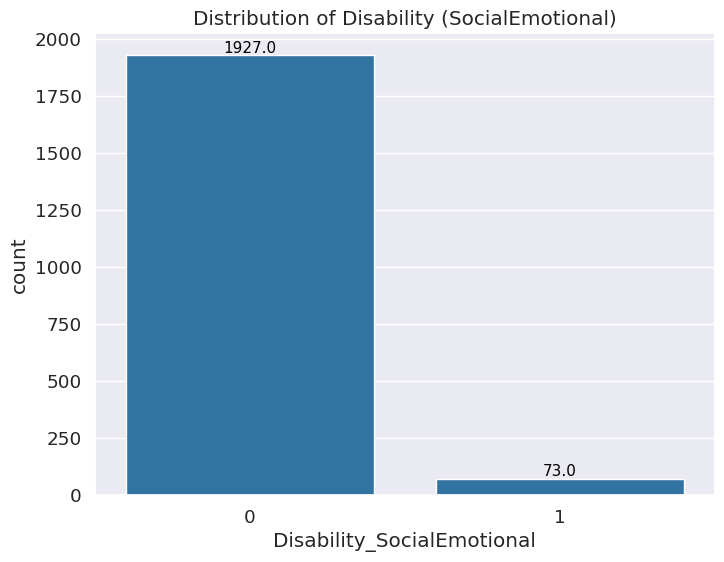

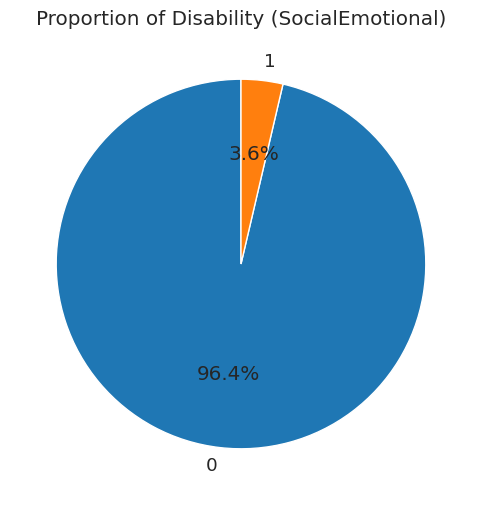

In [ ]:
# prompt: Disability_SocialEmotional

# Assuming 'records' DataFrame is already loaded as in your provided code.

# Count plot of Disability_SocialEmotional
plt.figure(figsize=(8, 6))
ax = sns.countplot(x='Disability_SocialEmotional', data=records)
plt.title('Distribution of Disability (SocialEmotional)')

# Add data labels on top of each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=11, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()


# Pie chart of Disability_SocialEmotional
plt.figure(figsize=(8, 6))
records['Disability_SocialEmotional'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90)
plt.title('Proportion of Disability (SocialEmotional)')
plt.ylabel('') # Hide the y-label
plt.show()


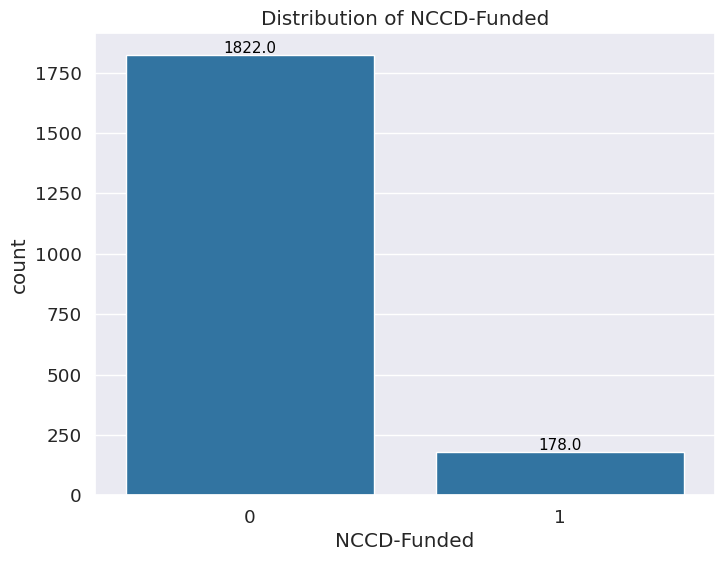

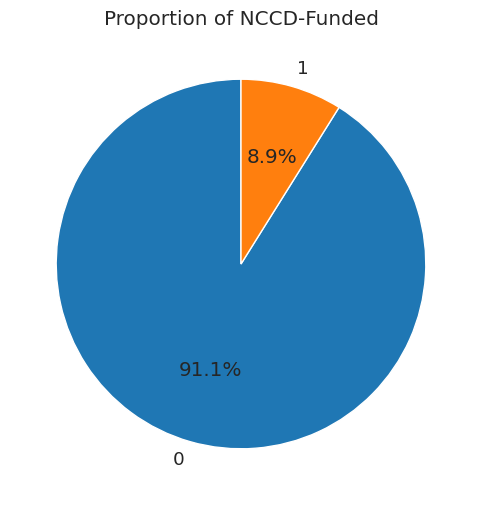

In [ ]:
# prompt: NCCD-Funded

# Assuming 'records' DataFrame is already loaded as in your provided code.

# Count plot of NCCD-Funded
plt.figure(figsize=(8, 6))
ax = sns.countplot(x='NCCD-Funded', data=records)
plt.title('Distribution of NCCD-Funded')

# Add data labels on top of each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=11, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()


# Pie chart of NCCD-Funded
plt.figure(figsize=(8, 6))
records['NCCD-Funded'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90)
plt.title('Proportion of NCCD-Funded')
plt.ylabel('') # Hide the y-label
plt.show()


In [ ]:
records[['Counting-01', 'Place Value-01', 'Addition and Subtraction-01', 'Multiplication and Division-01']].describe()


,Counting-01,Place Value-01,Addition and Subtraction-01,Multiplication and Division-01
count,2000.000000,2000.000000,2000.000000,2000.000000
mean,1.758000,1.028500,1.290500,1.075500
std,0.935881,0.529932,0.935172,0.837944
min,0.000000,0.000000,0.000000,0.000000
25%,1.000000,1.000000,1.000000,0.000000
50%,2.000000,1.000000,1.000000,1.000000
75%,2.000000,1.000000,2.000000,2.000000
max,5.000000,4.000000,5.000000,4.000000


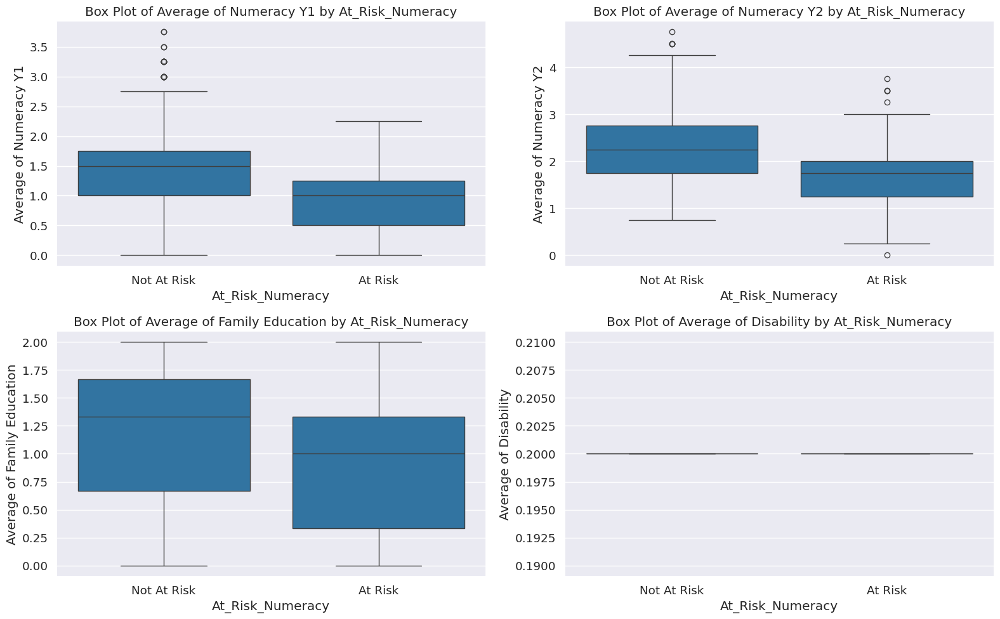

In [ ]:
# prompt: Create 4 box plots between 4 variables above \with at-risk-numeracy

# Select the variables for the box plots
variables_to_plot = ['Average of Numeracy Y1', 'Average of Numeracy Y2', 'Average of Family Education', 'Average of Disability']
target_variable = 'At_Risk_Numeracy'

# Create box plots for each variable against 'At_Risk_Numeracy'
plt.figure(figsize=(16, 10)) # Adjust the figure size as needed

for i, variable in enumerate(variables_to_plot):
    plt.subplot(2, 2, i + 1) # Create a 2x2 grid of subplots
    sns.boxplot(x=target_variable, y=variable, data=records)
    plt.title(f'Box Plot of {variable} by {target_variable}')
    plt.xlabel(target_variable)
    plt.ylabel(variable)
    plt.xticks([0, 1], ['Not At Risk', 'At Risk']) # Assuming 0 and 1 are the categories for At_Risk_Numeracy

plt.tight_layout() # Adjust layout to prevent overlapping titles/labels
plt.show()

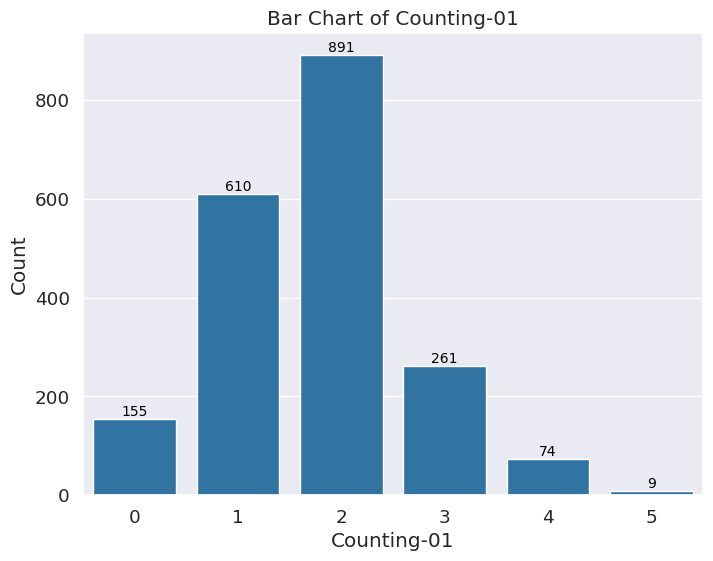

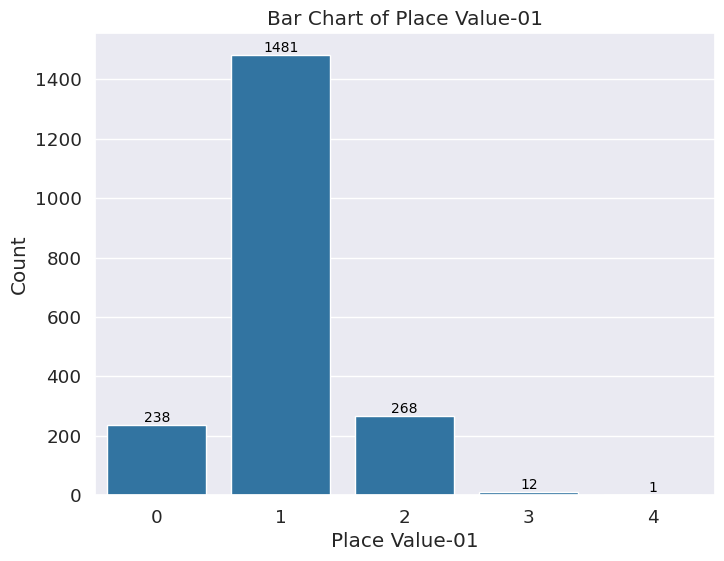

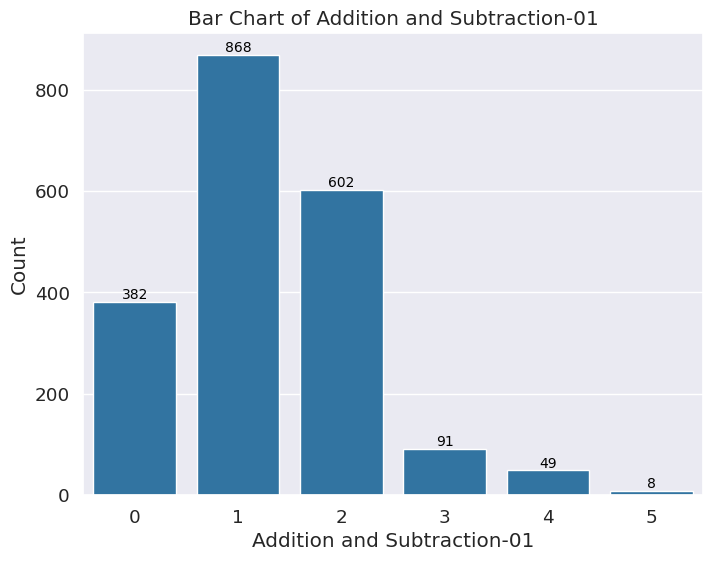

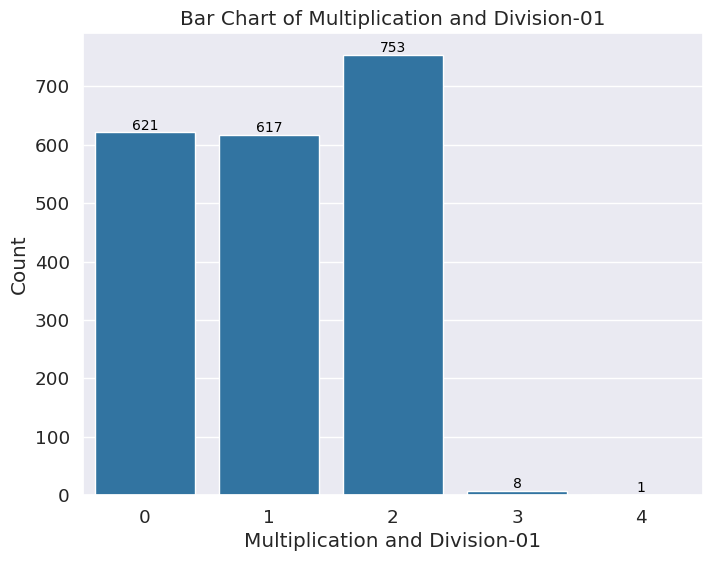

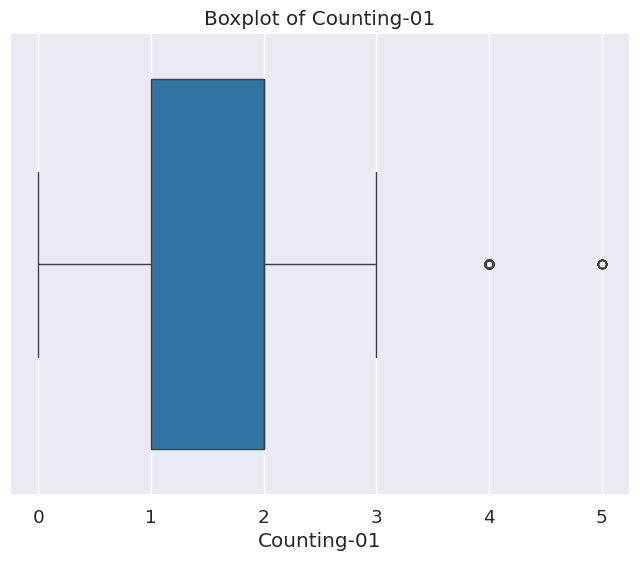

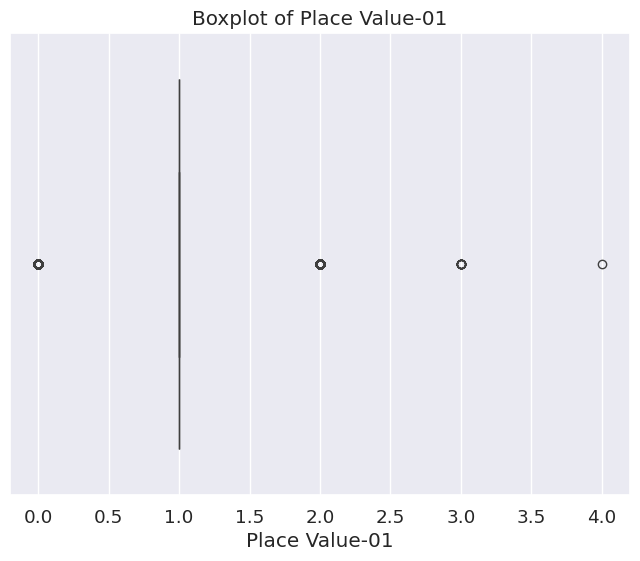

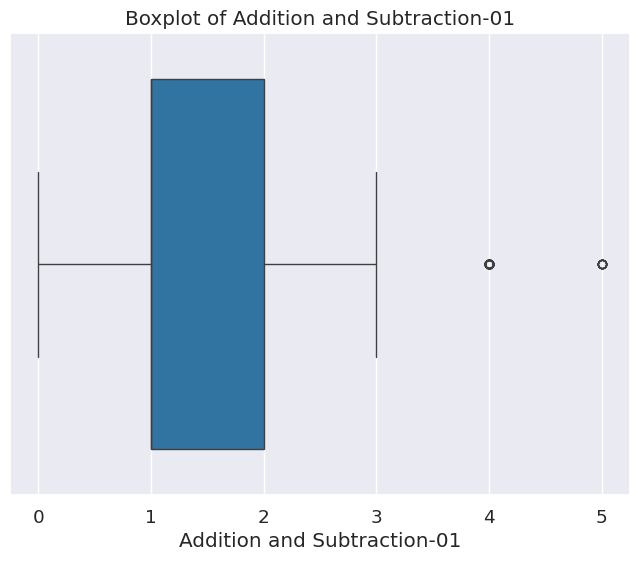

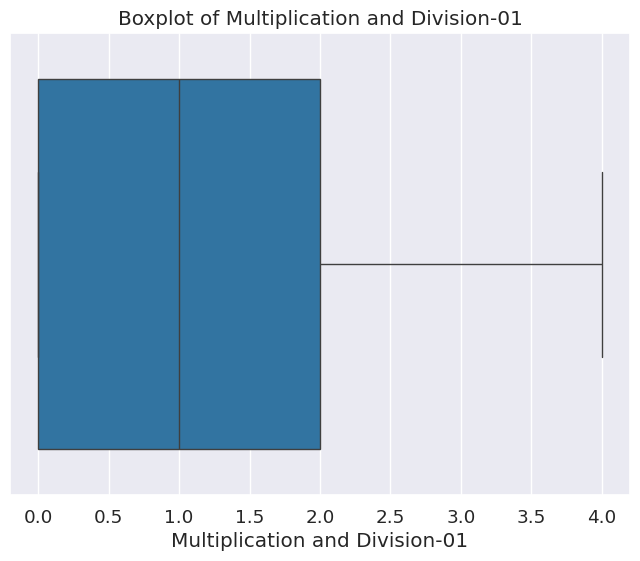

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and the numeracy columns are defined

numeracy_cols = ['Counting-01', 'Place Value-01',
                 'Addition and Subtraction-01',
                 'Multiplication and Division-01']


# Create bar charts for each numeracy variable with integer data labels
for col in numeracy_cols:
    plt.figure(figsize=(8, 6))
    ax = sns.countplot(x=col, data=records)  # Assign the plot to a variable 'ax'
    plt.title(f'Bar Chart of {col}')
    plt.xlabel(col)
    plt.ylabel('Count')

    # Add integer data labels on top of each bar
    for p in ax.patches:
        ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                    textcoords='offset points')

    plt.show()

# Create box plots for each numeracy variable (data labels are not typically used in box plots)
for col in numeracy_cols:
    plt.figure(figsize=(8, 6))
    sns.boxplot(x=col, data=records)
    plt.title(f'Boxplot of {col}')
    plt.xlabel(col)
    plt.show()

In [ ]:
records['Counting-01'].value_counts(normalize=True).round(4)


,proportion
Counting-01,
2,0.4455
1,0.3050
3,0.1305
0,0.0775
4,0.0370
5,0.0045


In [ ]:
records['Multiplication and Division-01'].value_counts(normalize=True).round(4)

,proportion
Multiplication and Division-01,
2,0.3765
0,0.3105
1,0.3085
3,0.0040
4,0.0005


In [ ]:
records['Addition and Subtraction-01'].value_counts(normalize=True).round(4)


,proportion
Addition and Subtraction-01,
1,0.4340
2,0.3010
0,0.1910
3,0.0455
4,0.0245
5,0.0040


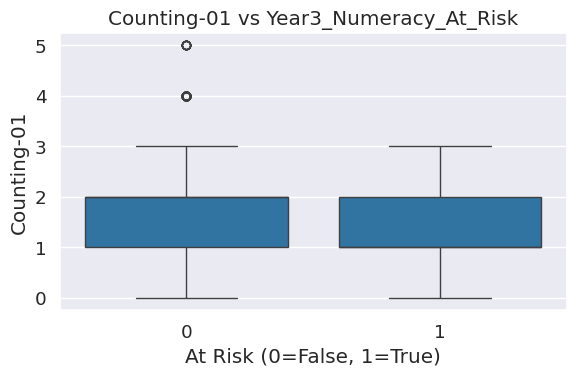

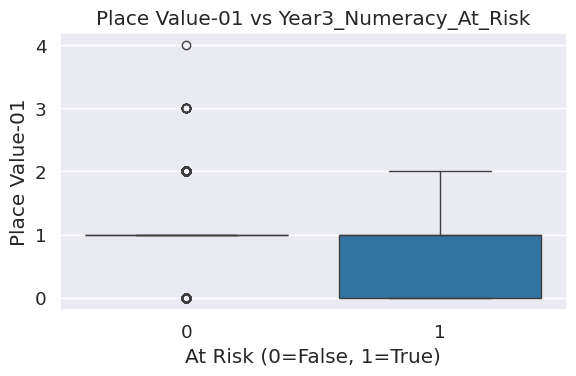

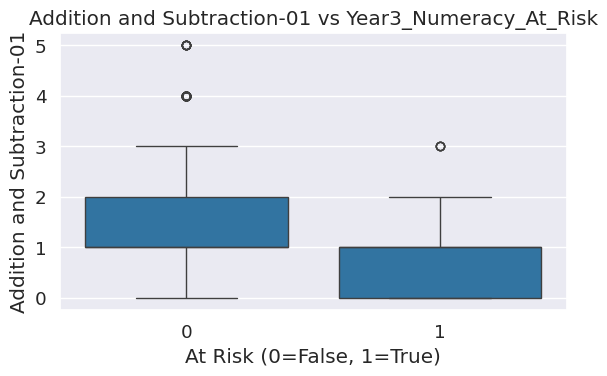

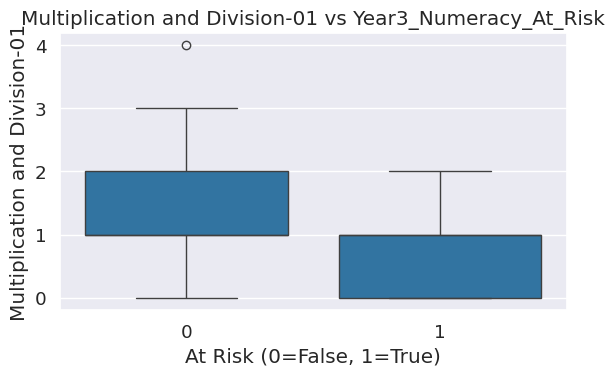

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

for col in numeracy_cols:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x='At_Risk_Numeracy', y=col, data=records)
    plt.title(f'{col} vs Year3_Numeracy_At_Risk')
    plt.xlabel('At Risk (0=False, 1=True)')
    plt.ylabel(col)
    plt.tight_layout()
    plt.show()


Descriptive statistics for TextLevel-01-SOY:
count    2000.00000
mean       10.69900
std         6.10082
min        -4.00000
25%         6.00000
50%        10.00000
75%        14.00000
max        34.00000
Name: TextLevel-01-SOY, dtype: float64


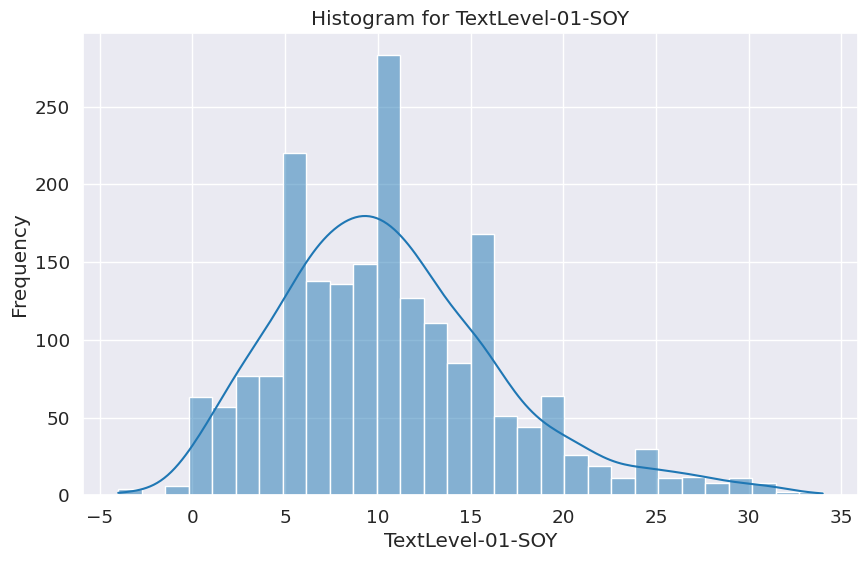

Descriptive statistics for TextLevel-01-MOY:
count    2000.000000
mean       15.001500
std         5.489496
min         0.000000
25%        11.000000
50%        14.000000
75%        18.000000
max        33.000000
Name: TextLevel-01-MOY, dtype: float64


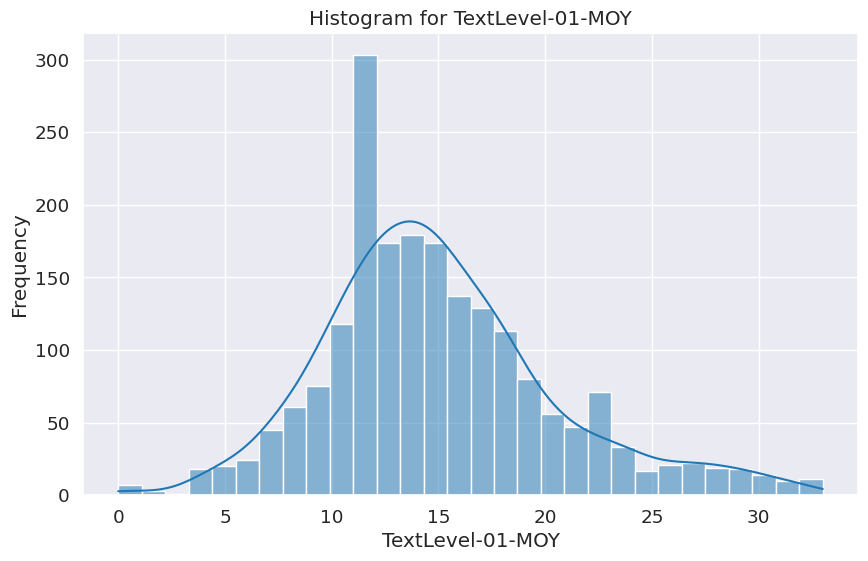

Descriptive statistics for TextLevel-01-EOY:
count    2000.0000
mean       21.1300
std         4.5786
min         4.0000
25%        18.0000
50%        21.0000
75%        24.0000
max        34.0000
Name: TextLevel-01-EOY, dtype: float64


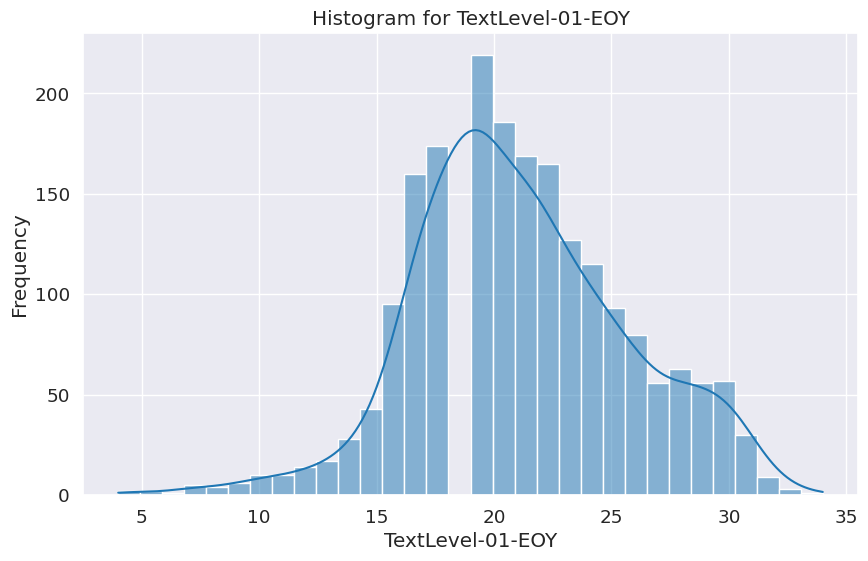

Descriptive statistics for WritingVocab-01-SOY:
count    2000.000000
mean       22.018500
std        12.679098
min         0.000000
25%        13.000000
50%        20.000000
75%        29.000000
max        95.000000
Name: WritingVocab-01-SOY, dtype: float64


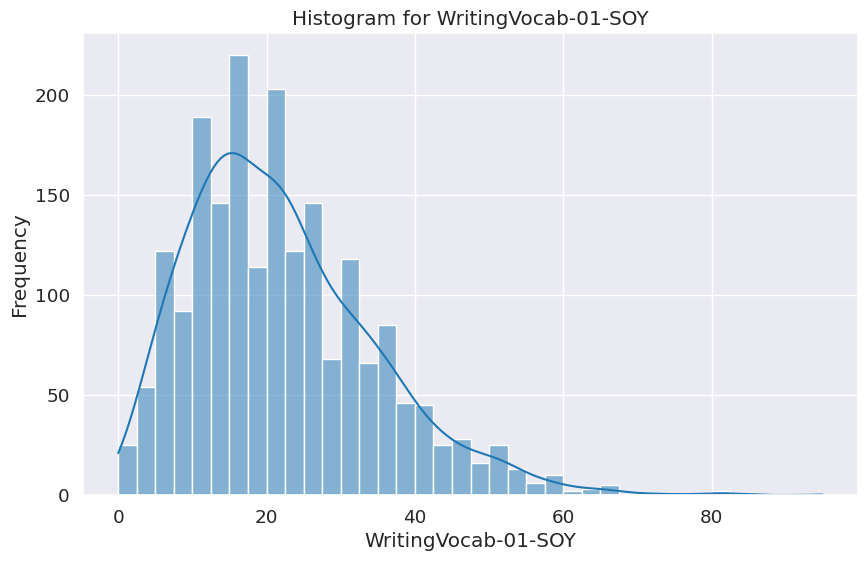

In [ ]:
# prompt: create a loop to create histogram (with the trend line) for TextLevel and Writing Vocabulary, including describe

# Loop through 'TextLevel' and 'Writing Vocabulary' columns (assuming they exist)
for col in ['TextLevel-01-SOY', 'TextLevel-01-MOY', 'TextLevel-01-EOY', 'WritingVocab-01-SOY']:
    if col in records.columns:
        plt.figure(figsize=(10, 6))

        # Histogram
        sns.histplot(records[col], kde=True)
        plt.title(f'Histogram for {col}')
        plt.xlabel(col)
        plt.ylabel('Frequency')

        # Descriptive statistics
        print(f"Descriptive statistics for {col}:")
        print(records[col].describe())
        plt.show()

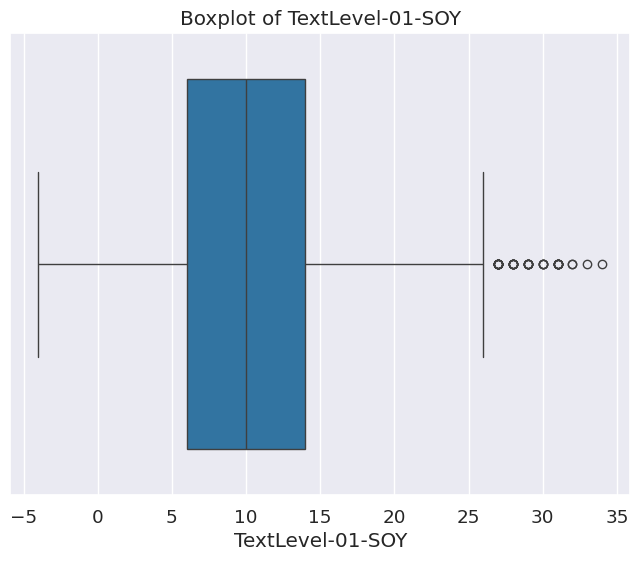

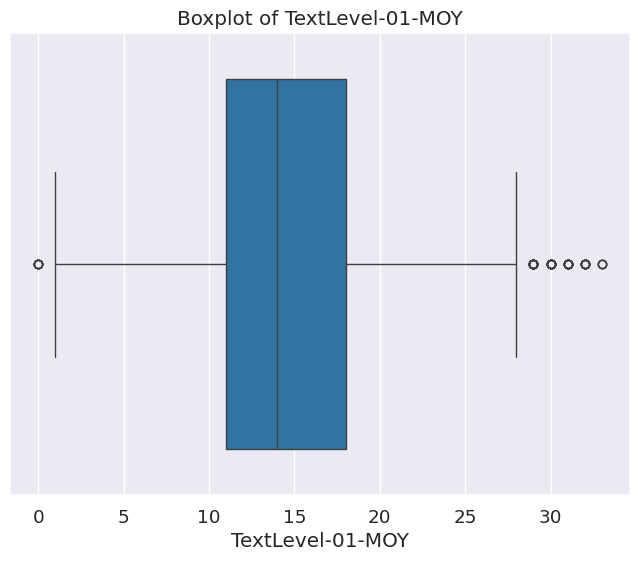

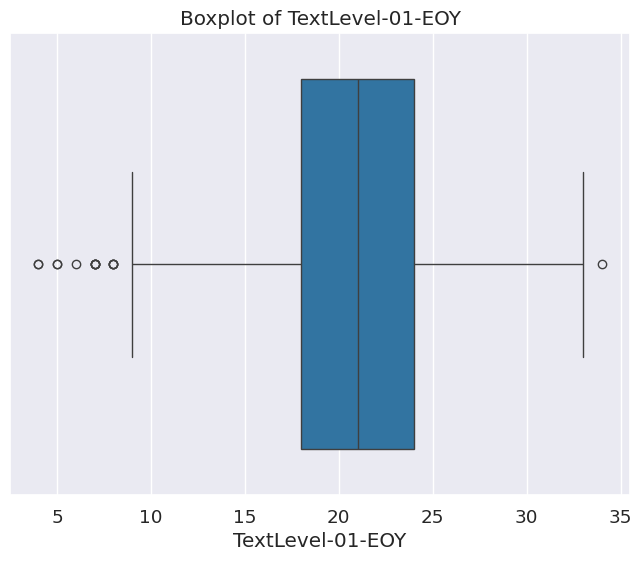

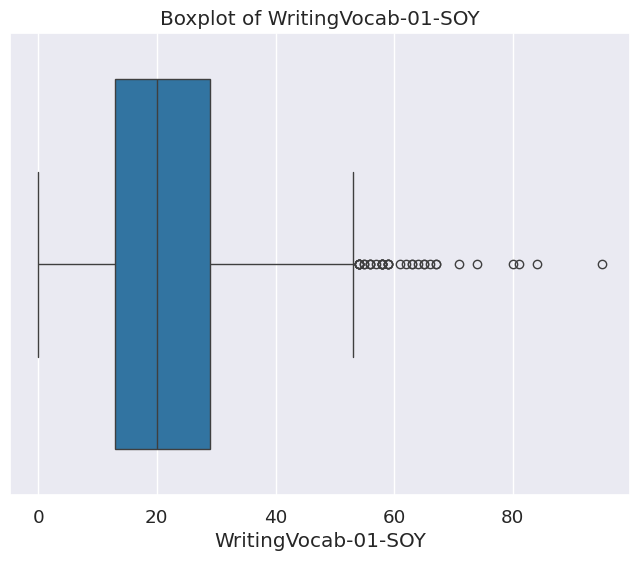

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define the list of Year 1 literacy variables for which you want box plots
literacy_y1_vars = ['TextLevel-01-SOY', 'TextLevel-01-MOY', 'TextLevel-01-EOY', 'WritingVocab-01-SOY']

# Loop through the list of variables and create a box plot for each
for col in literacy_y1_vars:
    # Check if the column exists in the DataFrame (good practice)
    if col in records.columns:
        plt.figure(figsize=(8, 6))  # Create a new figure for each box plot
        sns.boxplot(x=records[col])
        plt.title(f'Boxplot of {col}')  # Set the title to the column name
        plt.xlabel(col)  # Set the x-axis label to the column name
        plt.show()  # Display the box plot
    else:
        print(f"Column '{col}' not found in the DataFrame.")

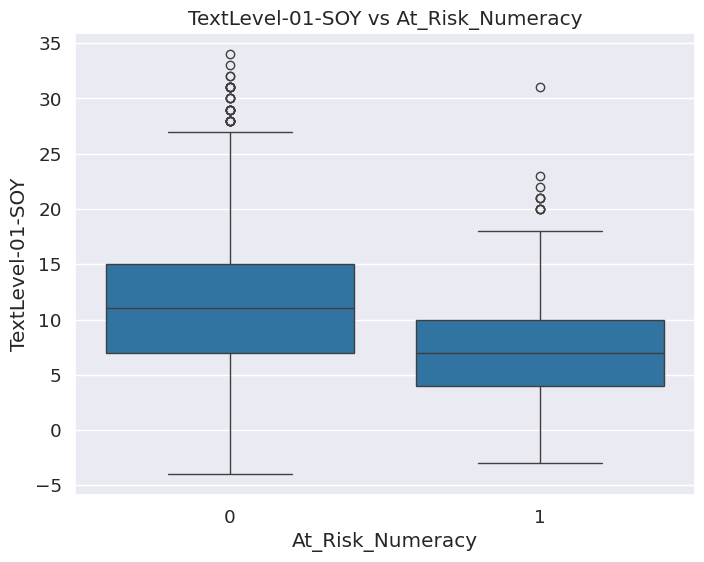

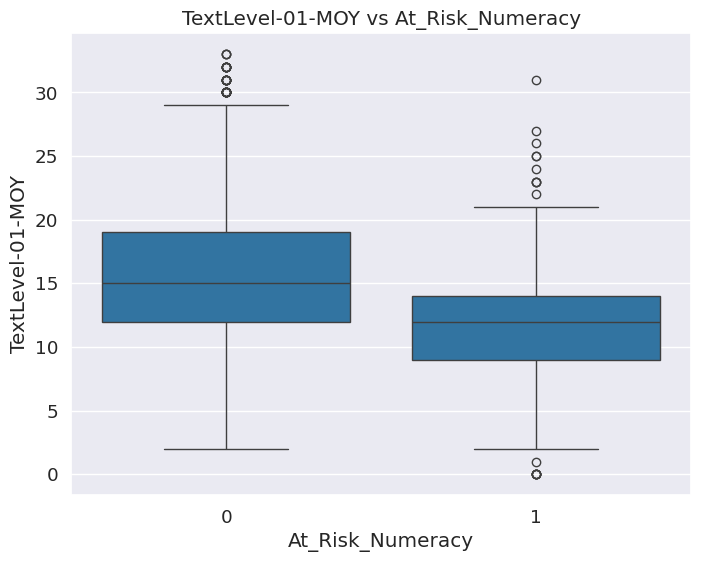

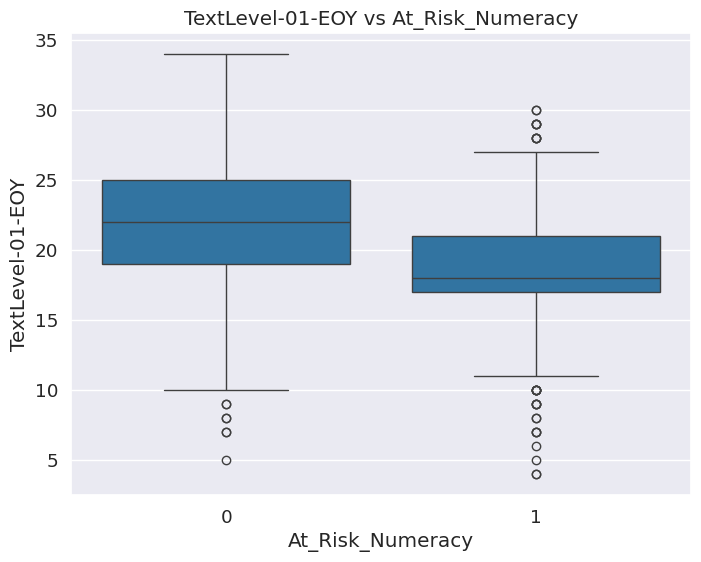

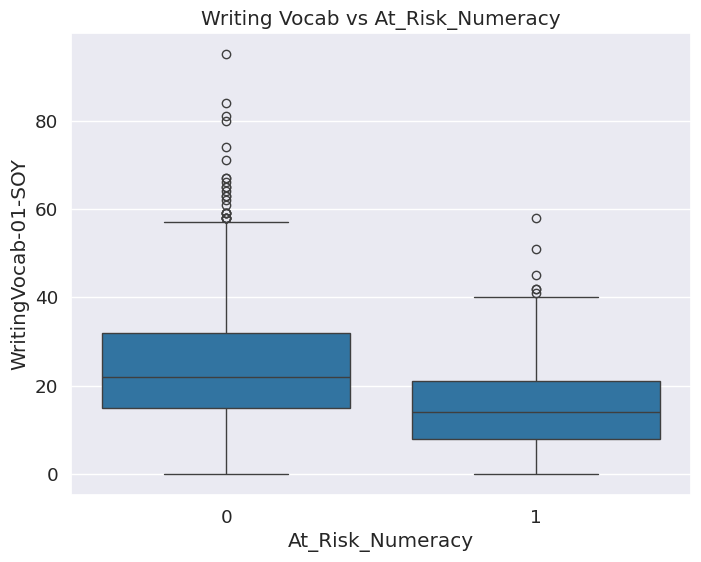

In [ ]:
# prompt: create a boxplot between TextLevel and Writing Vocab with At-Risk_Numeracy

plt.figure(figsize=(8, 6))
sns.boxplot(x='At_Risk_Numeracy', y='TextLevel-01-SOY', data=records)
plt.title('TextLevel-01-SOY vs At_Risk_Numeracy')
plt.show()

plt.figure(figsize=(8, 6))
sns.boxplot(x='At_Risk_Numeracy', y='TextLevel-01-MOY', data=records)
plt.title('TextLevel-01-MOY vs At_Risk_Numeracy')
plt.show()

plt.figure(figsize=(8, 6))
sns.boxplot(x='At_Risk_Numeracy', y='TextLevel-01-EOY', data=records)
plt.title('TextLevel-01-EOY vs At_Risk_Numeracy')
plt.show()

plt.figure(figsize=(8, 6))
sns.boxplot(x='At_Risk_Numeracy', y='WritingVocab-01-SOY', data=records)
plt.title('Writing Vocab vs At_Risk_Numeracy')
plt.show()


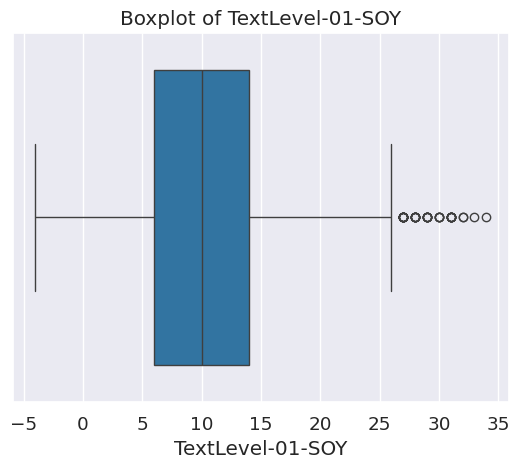

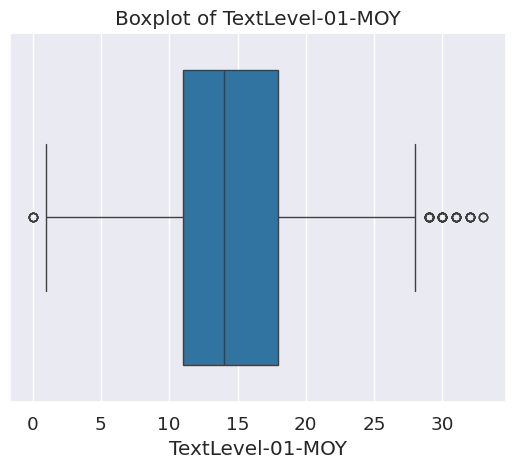

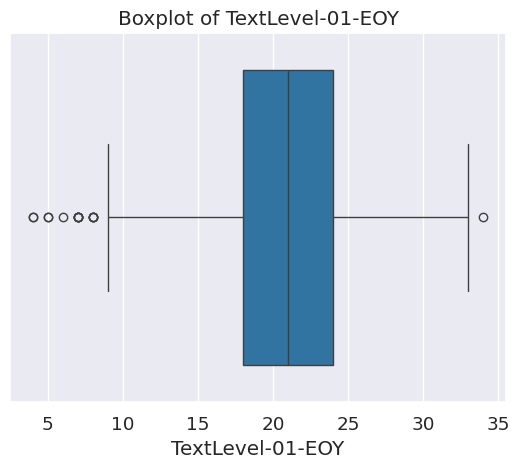

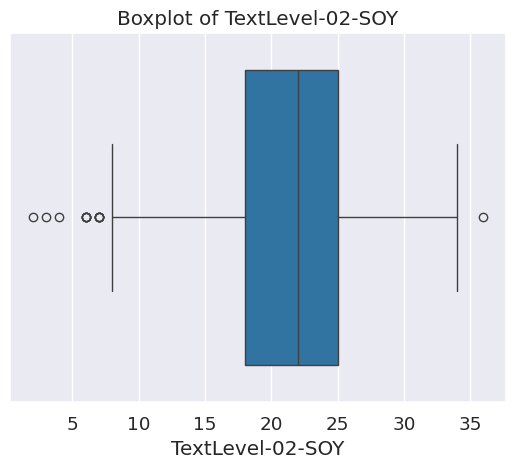

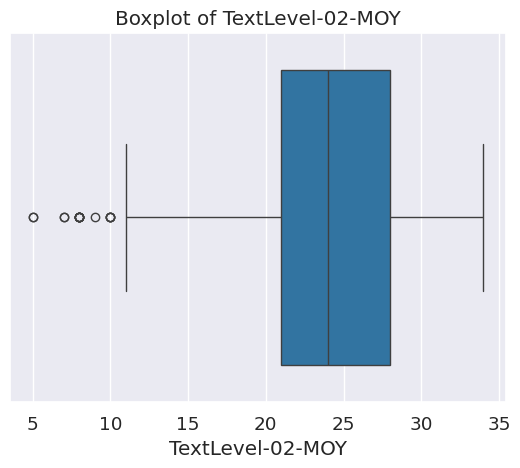

...

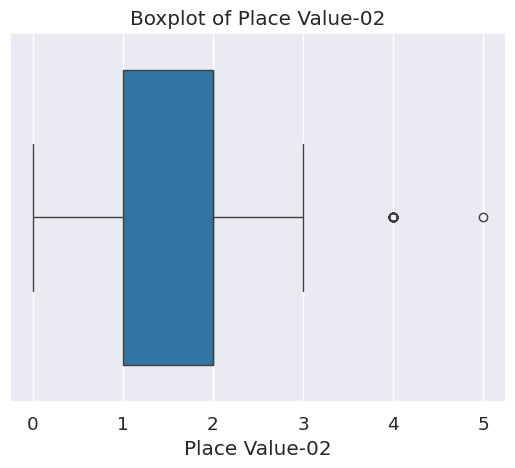

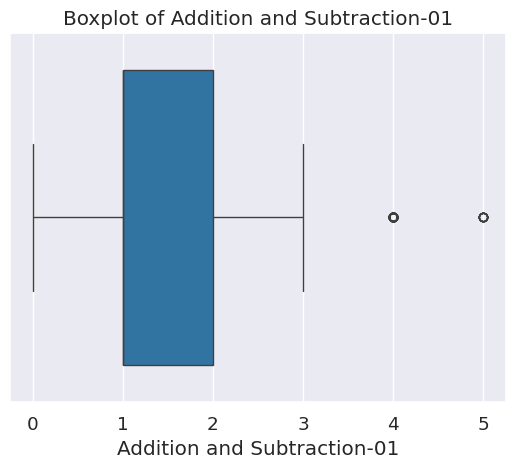

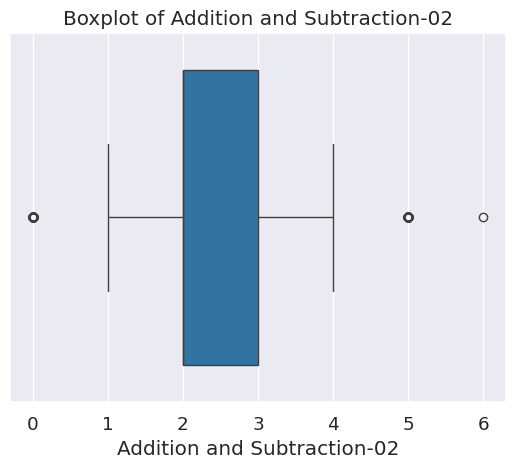

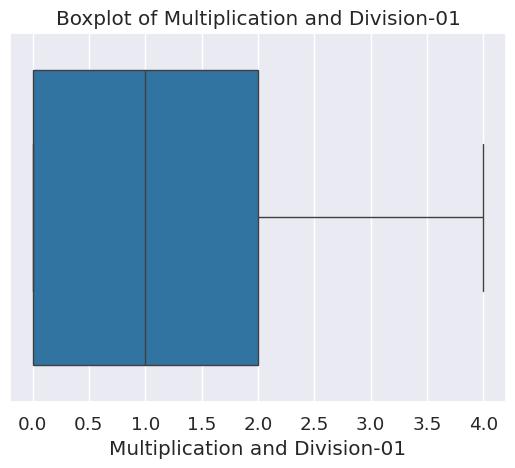

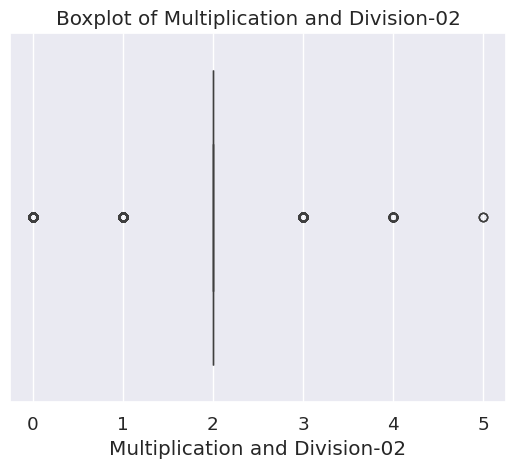

In [ ]:
# prompt: generate a loop to produce boxplot for each variables

for col in records.columns[:16]:
    plt.figure()  # Create a new figure for each boxplot
    sns.boxplot(x=records[col])
    plt.title(f'Boxplot of {col}')
    plt.show()


**Bivariable analysis**

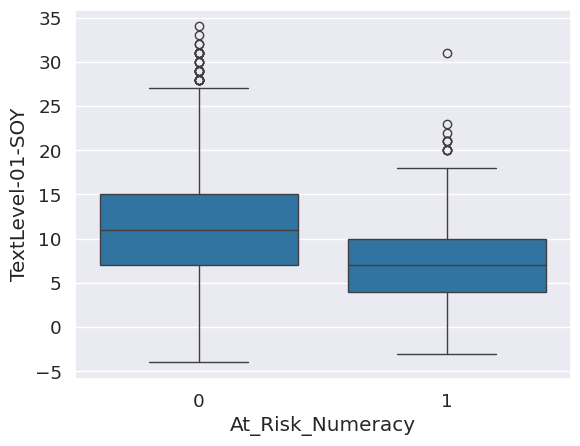

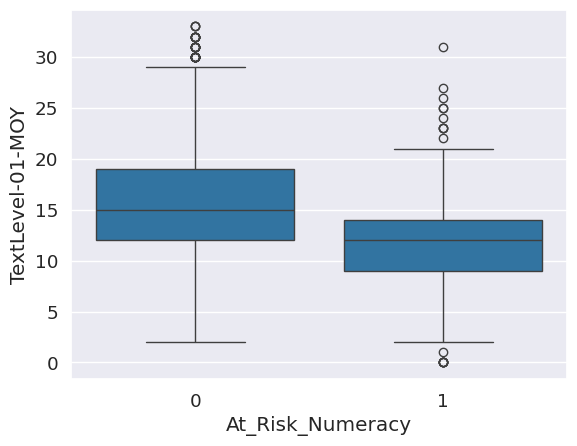

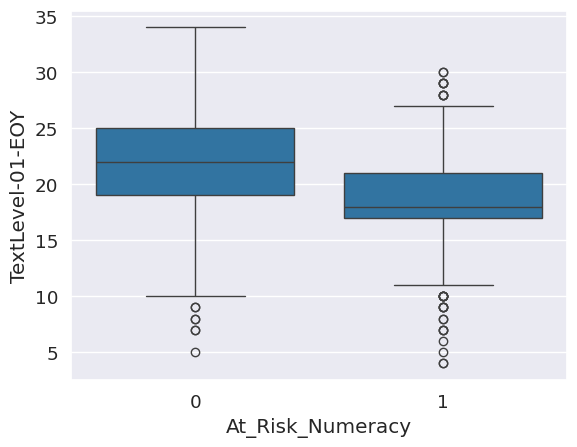

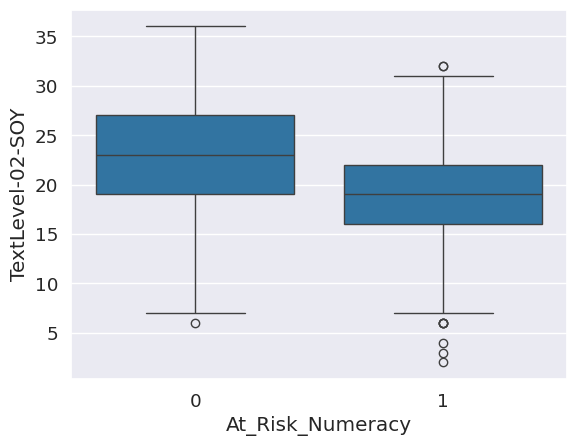

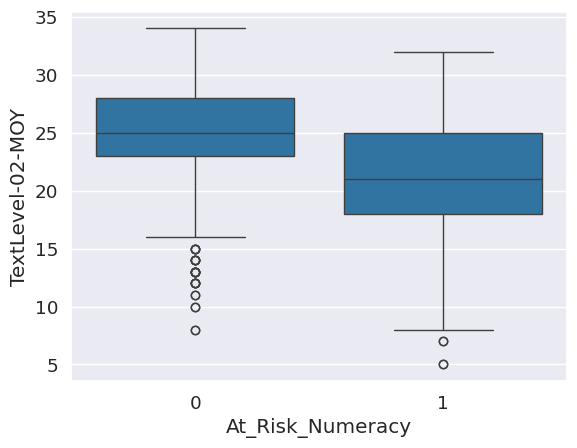

...

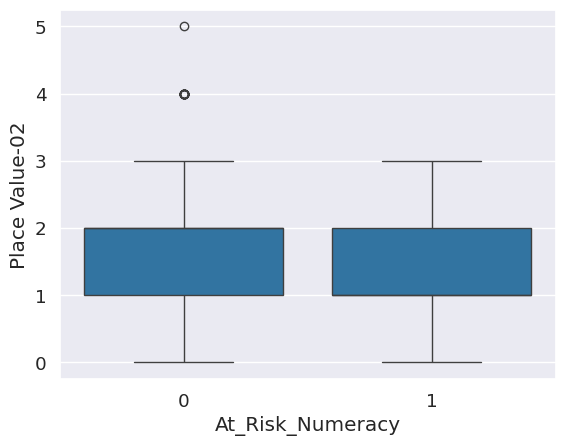

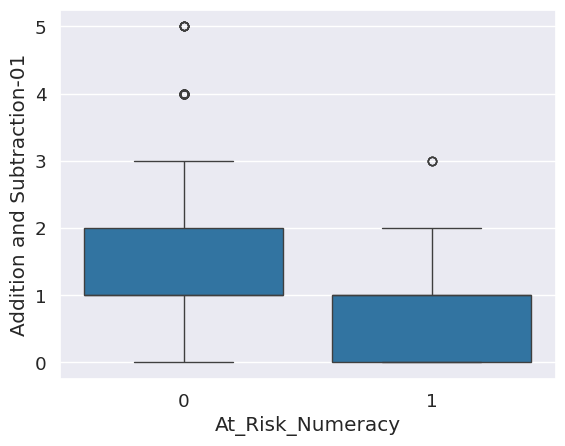

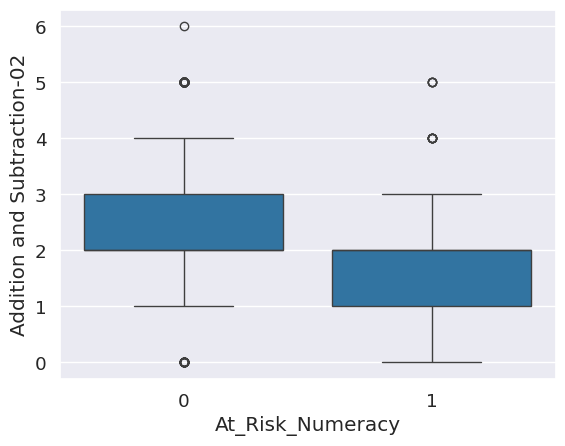

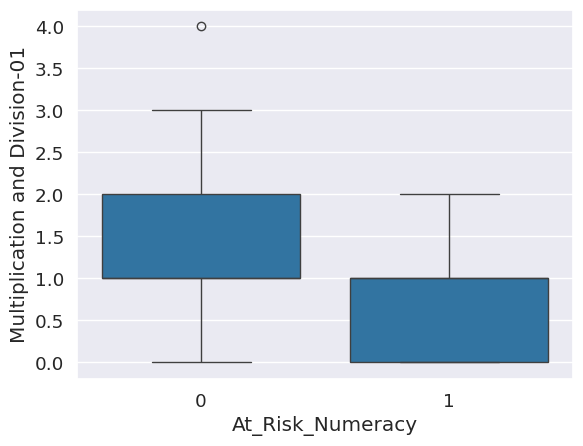

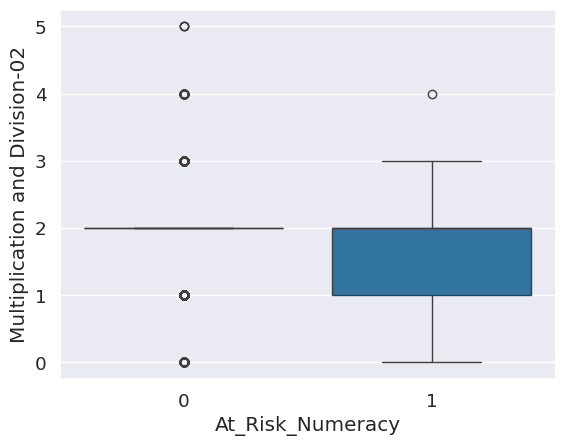

In [ ]:
##write your code to print boxplots for these variables by diagnosis, you can use the same loop, use the boxplot instead
for i in records.columns[:16]:
    sns.boxplot(data=records, x='At_Risk_Numeracy', y=i)
    plt.show()

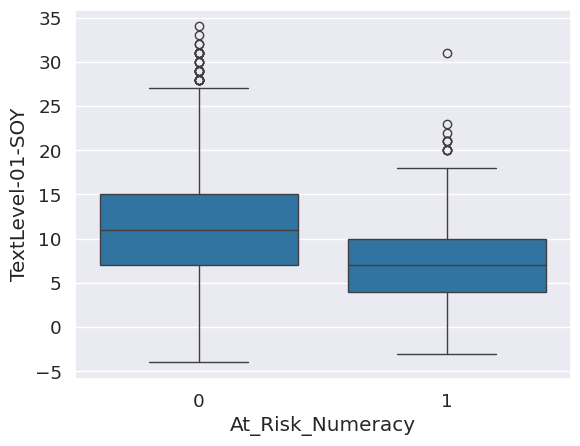

                  min  25%   50%   75%   max
At_Risk_Numeracy                            
0                -4.0  7.0  11.0  15.0  34.0
1                -3.0  4.0   7.0  10.0  31.0


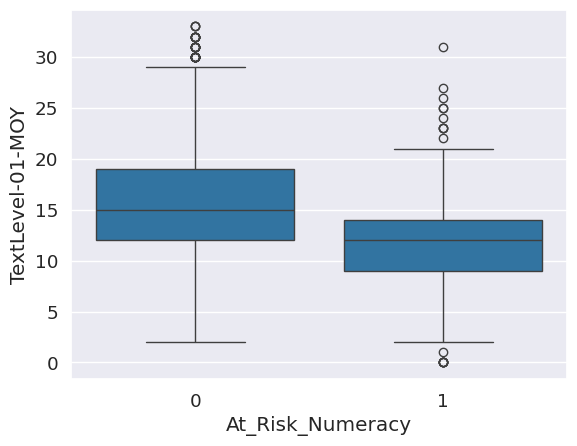

                  min   25%   50%   75%   max
At_Risk_Numeracy                             
0                 2.0  12.0  15.0  19.0  33.0
1                 0.0   9.0  12.0  14.0  31.0


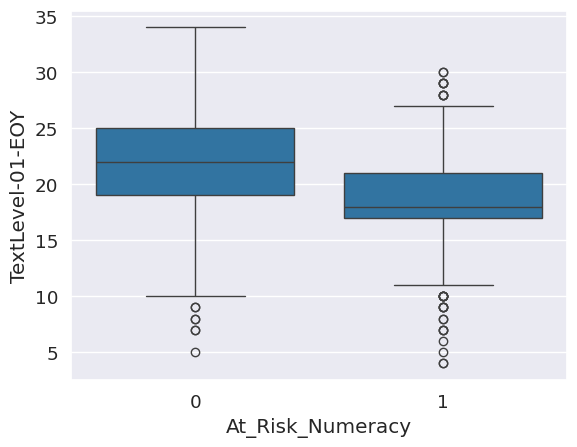

                  min   25%   50%   75%   max
At_Risk_Numeracy                             
0                 5.0  19.0  22.0  25.0  34.0
1                 4.0  17.0  18.0  21.0  30.0


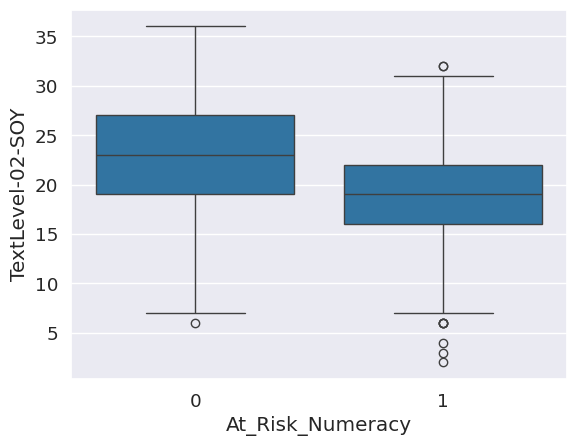

                  min   25%   50%   75%   max
At_Risk_Numeracy                             
0                 6.0  19.0  23.0  27.0  36.0
1                 2.0  16.0  19.0  22.0  32.0


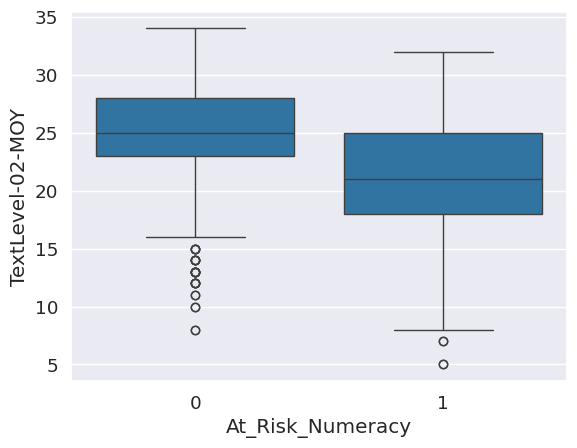

                  min   25%   50%   75%   max
At_Risk_Numeracy                             
0                 8.0  23.0  25.0  28.0  34.0
1                 5.0  18.0  21.0  25.0  32.0


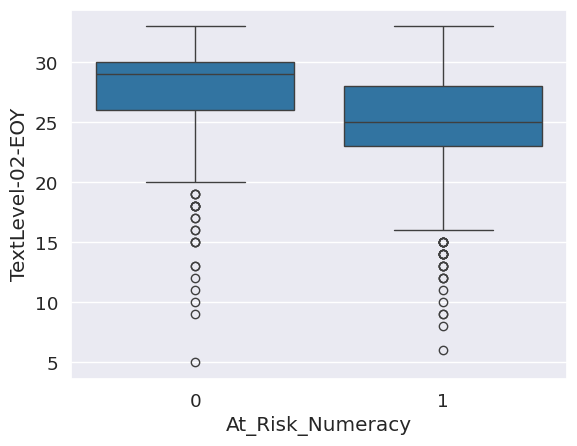

                  min   25%   50%   75%   max
At_Risk_Numeracy                             
0                 5.0  26.0  29.0  30.0  33.0
1                 6.0  23.0  25.0  28.0  33.0


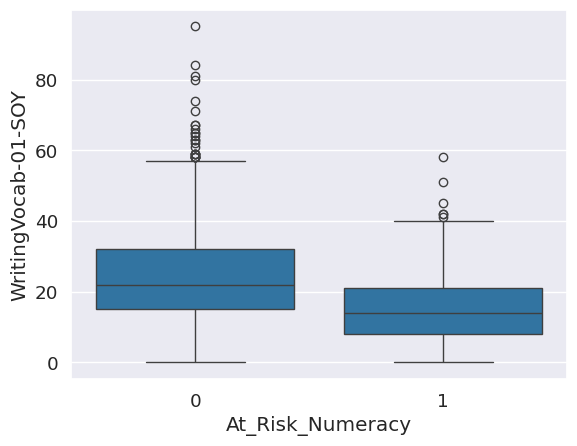

                  min   25%   50%   75%   max
At_Risk_Numeracy                             
0                 0.0  15.0  22.0  32.0  95.0
1                 0.0   8.0  14.0  21.0  58.0


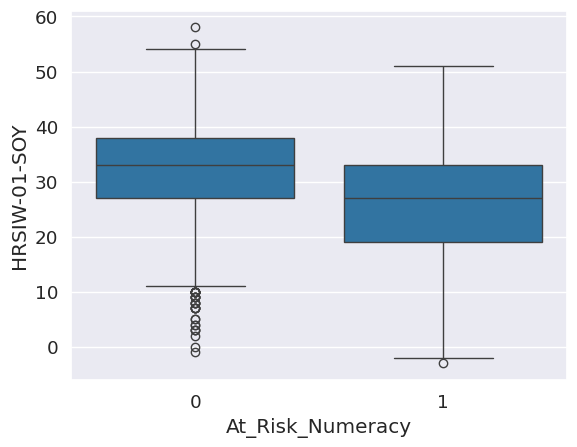

                  min   25%   50%   75%   max
At_Risk_Numeracy                             
0                -1.0  27.0  33.0  38.0  58.0
1                -3.0  19.0  27.0  33.0  51.0


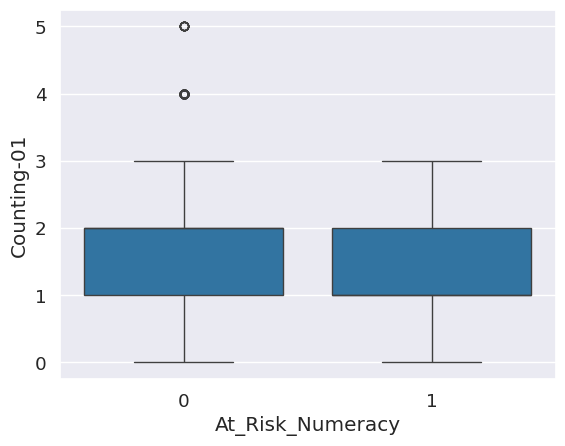

                  min  25%  50%  75%  max
At_Risk_Numeracy                         
0                 0.0  1.0  2.0  2.0  5.0
1                 0.0  1.0  1.0  2.0  3.0


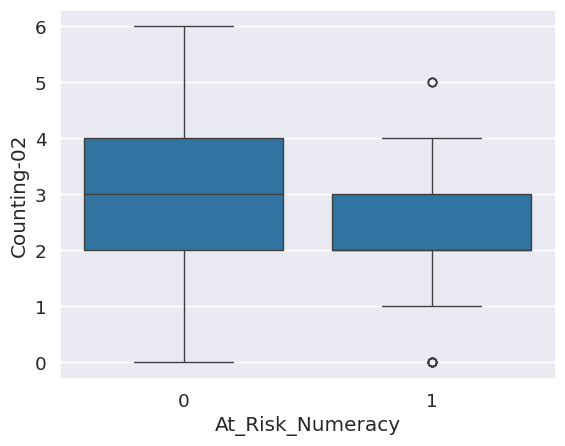

                  min  25%  50%  75%  max
At_Risk_Numeracy                         
0                 0.0  2.0  3.0  4.0  6.0
1                 0.0  2.0  2.0  3.0  5.0


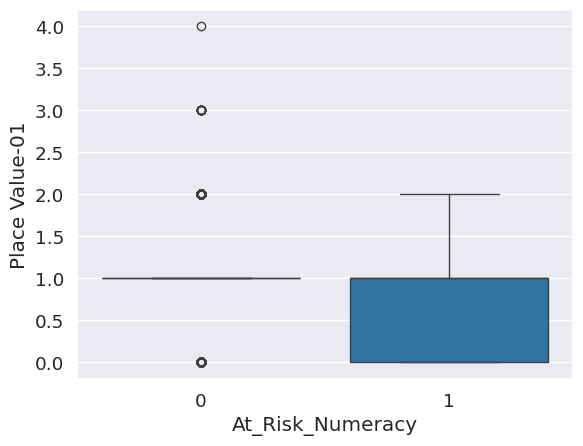

                  min  25%  50%  75%  max
At_Risk_Numeracy                         
0                 0.0  1.0  1.0  1.0  4.0
1                 0.0  0.0  1.0  1.0  2.0


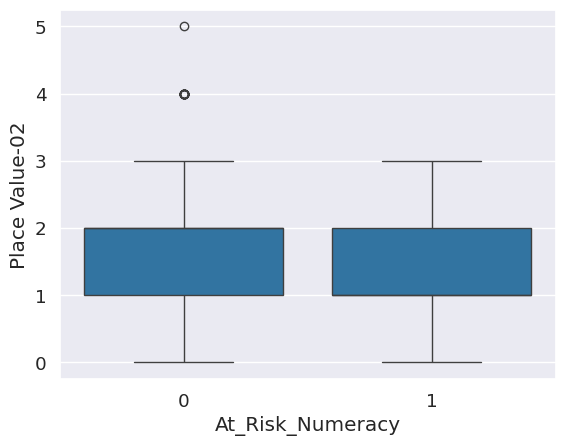

                  min  25%  50%  75%  max
At_Risk_Numeracy                         
0                 0.0  1.0  2.0  2.0  5.0
1                 0.0  1.0  1.0  2.0  3.0


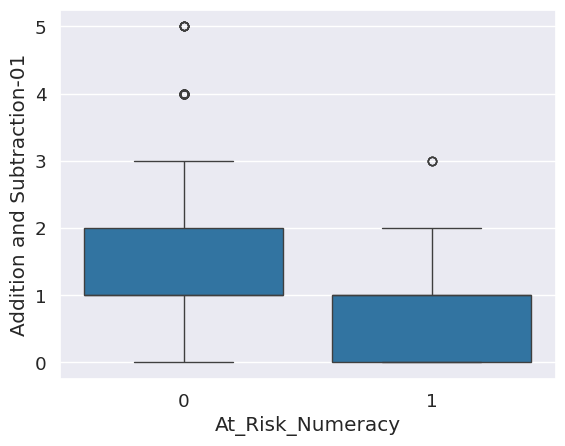

                  min  25%  50%  75%  max
At_Risk_Numeracy                         
0                 0.0  1.0  1.0  2.0  5.0
1                 0.0  0.0  1.0  1.0  3.0


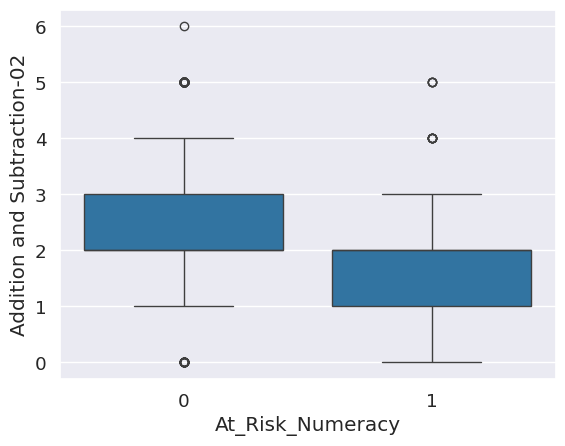

                  min  25%  50%  75%  max
At_Risk_Numeracy                         
0                 0.0  2.0  2.0  3.0  6.0
1                 0.0  1.0  2.0  2.0  5.0


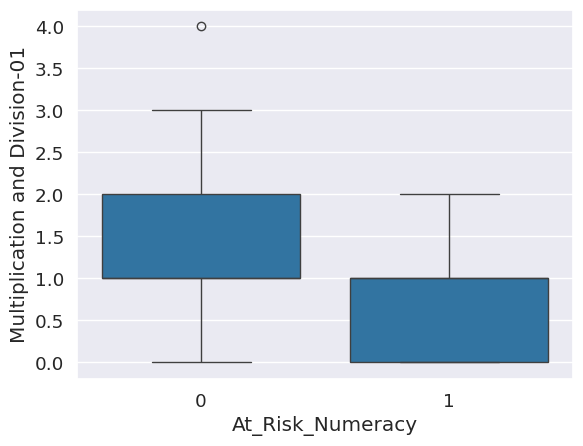

                  min  25%  50%  75%  max
At_Risk_Numeracy                         
0                 0.0  1.0  1.0  2.0  4.0
1                 0.0  0.0  1.0  1.0  2.0


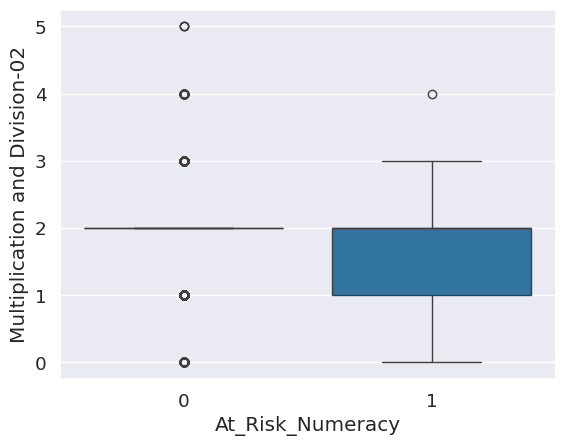

                  min  25%  50%  75%  max
At_Risk_Numeracy                         
0                 0.0  2.0  2.0  2.0  5.0
1                 0.0  1.0  2.0  2.0  4.0


In [ ]:
# view the box plots for numeric variables grouped by diagnosis, and print min, Q1, Q2, Q3, max

import matplotlib.pyplot as plt
for i in records.columns[:16]:
    sns.boxplot(data=records, x='At_Risk_Numeracy', y=i)
    plt.show()
    print(records.groupby('At_Risk_Numeracy')[i].describe()[['min', '25%', '50%', '75%', 'max']])


**Plotting biomarkers and At_Risk_Numeracy using a logistric relationship**

<Axes: xlabel='Counting-01', ylabel='At_Risk_Numeracy'>

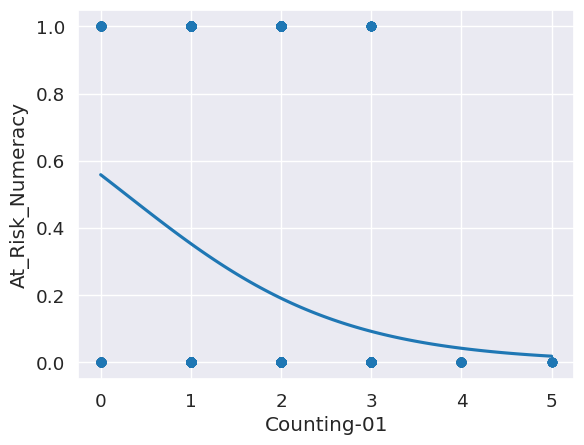

In [ ]:
sns.regplot(x=records['Counting-01'], y=records['At_Risk_Numeracy'], logistic=True, ci=None)

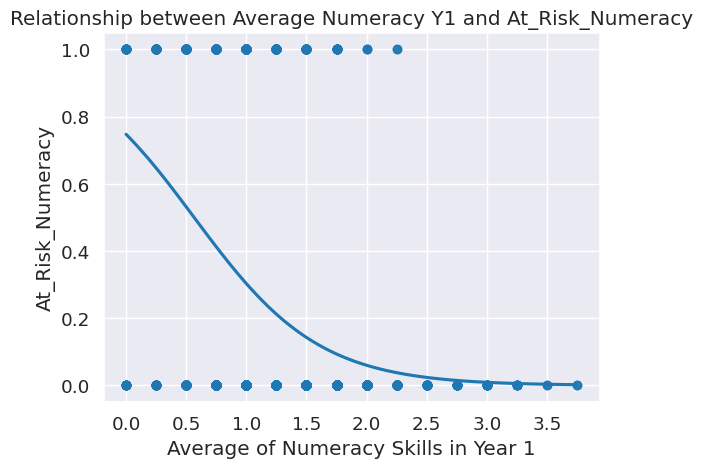

In [ ]:
# prompt: create a regplot to show relationship between Counting, Place Value, Addition and Subtraction, Mulyiplication in relation with At_Risk_Numeracy. Can you put all of them into 1 regplot

import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'records' DataFrame is already loaded and processed

# Create the regplot
sns.regplot(x=records['Average of Numeracy Y1'], y=records['At_Risk_Numeracy'], logistic=True, ci=None)
plt.title('Relationship between Average Numeracy Y1 and At_Risk_Numeracy')
plt.xlabel('Average of Numeracy Skills in Year 1')
plt.ylabel('At_Risk_Numeracy')
plt.show()


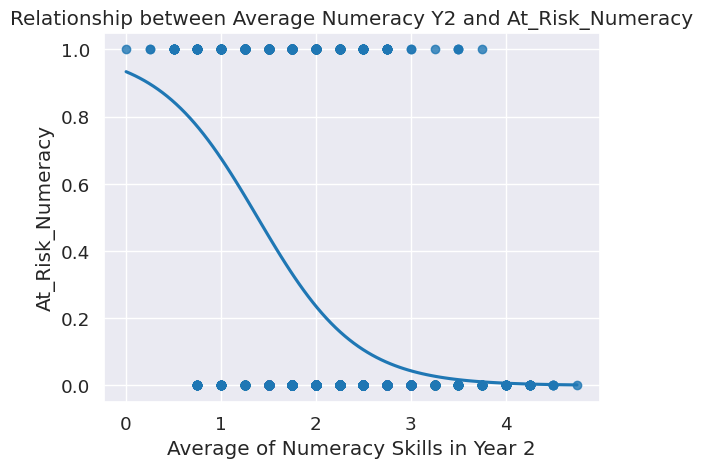

In [ ]:
# prompt: create a regplot to show relationship between Counting, Place Value, Addition and Subtraction, Mulyiplication in relation with At_Risk_Numeracy. Can you put all of them into 1 regplot

import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'records' DataFrame is already loaded and processed

# Create the regplot
sns.regplot(x=records['Average of Numeracy Y2'], y=records['At_Risk_Numeracy'], logistic=True, ci=None)
plt.title('Relationship between Average Numeracy Y2 and At_Risk_Numeracy')
plt.xlabel('Average of Numeracy Skills in Year 2')
plt.ylabel('At_Risk_Numeracy')
plt.show()


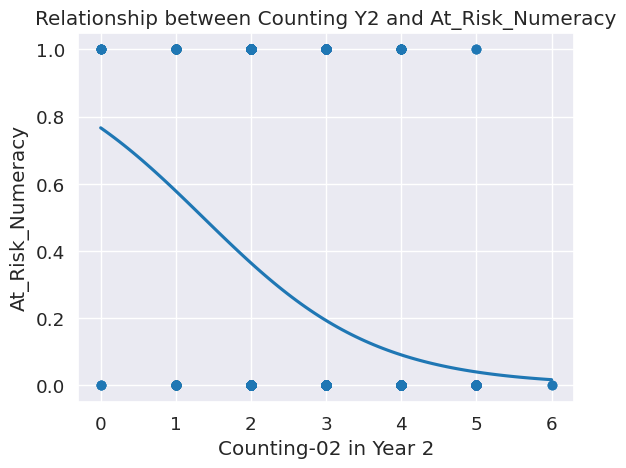

In [ ]:
# prompt: create a regplot to show relationship between Counting, Place Value, Addition and Subtraction, Mulyiplication in relation with At_Risk_Numeracy. Can you put all of them into 1 regplot

import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'records' DataFrame is already loaded and processed

# Create the regplot
sns.regplot(x=records['Counting-02'], y=records['At_Risk_Numeracy'], logistic=True, ci=None)
plt.title('Relationship between Counting Y2 and At_Risk_Numeracy')
plt.xlabel('Counting-02 in Year 2')
plt.ylabel('At_Risk_Numeracy')
plt.show()


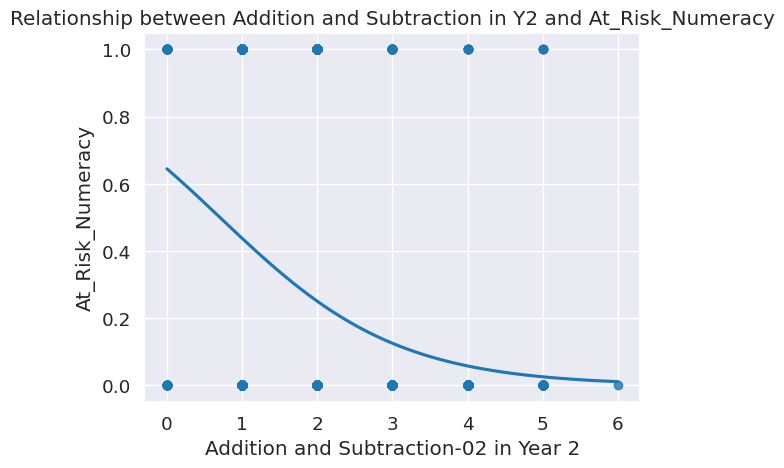

In [ ]:
# prompt: create a regplot to show relationship between Counting, Place Value, Addition and Subtraction, Mulyiplication in relation with At_Risk_Numeracy. Can you put all of them into 1 regplot

import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'records' DataFrame is already loaded and processed

# Create the regplot
sns.regplot(x=records['Addition and Subtraction-02'], y=records['At_Risk_Numeracy'], logistic=True, ci=None)
plt.title('Relationship between Addition and Subtraction in Y2 and At_Risk_Numeracy')
plt.xlabel('Addition and Subtraction-02 in Year 2')
plt.ylabel('At_Risk_Numeracy')
plt.show()


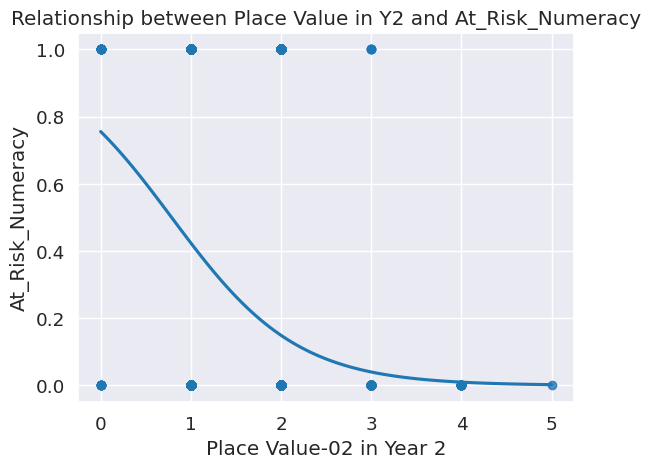

In [ ]:
# prompt: create a regplot to show relationship between Counting, Place Value, Addition and Subtraction, Mulyiplication in relation with At_Risk_Numeracy. Can you put all of them into 1 regplot

import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'records' DataFrame is already loaded and processed

# Create the regplot
sns.regplot(x=records['Place Value-02'], y=records['At_Risk_Numeracy'], logistic=True, ci=None)
plt.title('Relationship between Place Value in Y2 and At_Risk_Numeracy')
plt.xlabel('Place Value-02 in Year 2')
plt.ylabel('At_Risk_Numeracy')
plt.show()


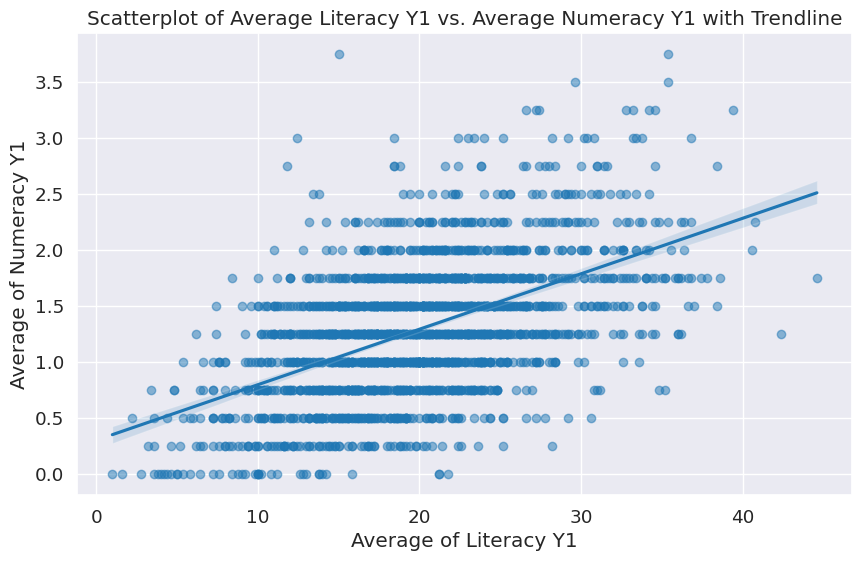

In [ ]:
# prompt: create a scatterplot between average of literacy Y1 and Average of Numeracy Y1, including the trend line

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed as in your previous code

# Create the scatterplot with trendline
plt.figure(figsize=(10, 6))
sns.regplot(x='Average of Literacy Y1', y='Average of Numeracy Y1', data=records, scatter_kws={'alpha':0.5}) # Adjust alpha for transparency
plt.title('Scatterplot of Average Literacy Y1 vs. Average Numeracy Y1 with Trendline')
plt.xlabel('Average of Literacy Y1')
plt.ylabel('Average of Numeracy Y1')
plt.show()


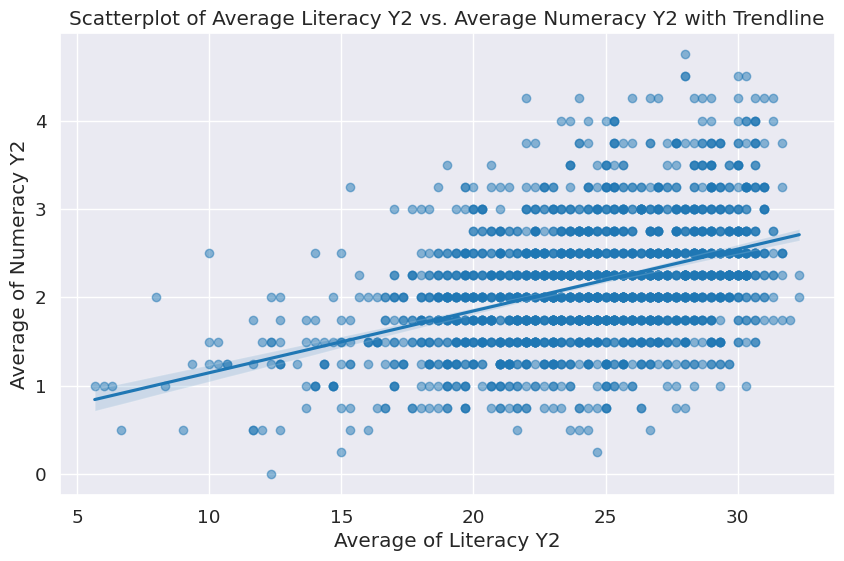

In [ ]:
# prompt: create a scatterplot between average of literacy Y1 and Average of Numeracy Y1, including the trend line

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed as in your previous code

# Create the scatterplot with trendline
plt.figure(figsize=(10, 6))
sns.regplot(x='Average of Literacy Y2', y='Average of Numeracy Y2', data=records, scatter_kws={'alpha':0.5}) # Adjust alpha for transparency
plt.title('Scatterplot of Average Literacy Y2 vs. Average Numeracy Y2 with Trendline')
plt.xlabel('Average of Literacy Y2')
plt.ylabel('Average of Numeracy Y2')
plt.show()

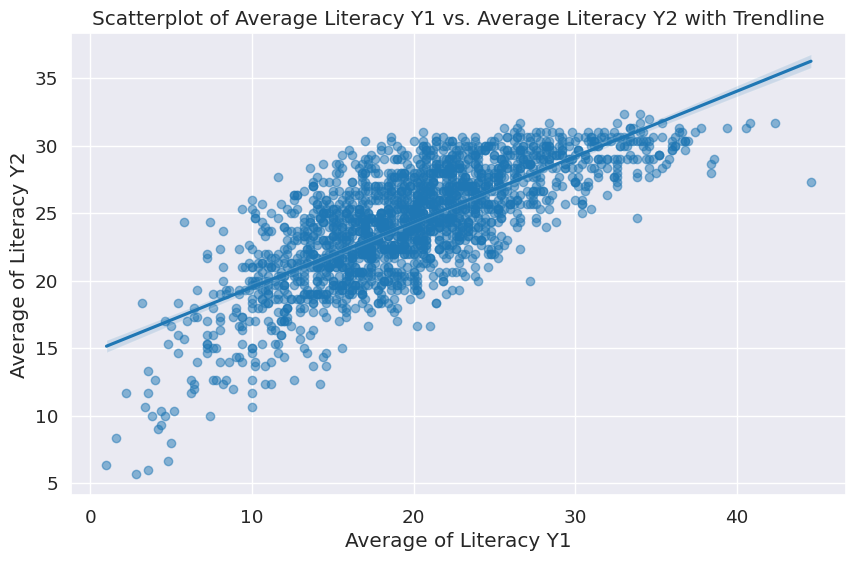

Correlation between Average of Literacy Y1 and Y2: 0.7387375300107086


In [ ]:
# prompt: check the relationship between average of literacy in Y1 and Y2

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed as in your previous code

# Create the scatterplot with trendline for Y1
plt.figure(figsize=(10, 6))
sns.regplot(x='Average of Literacy Y1', y='Average of Literacy Y2', data=records, scatter_kws={'alpha':0.5})
plt.title('Scatterplot of Average Literacy Y1 vs. Average Literacy Y2 with Trendline')
plt.xlabel('Average of Literacy Y1')
plt.ylabel('Average of Literacy Y2')
plt.show()

# Calculate the correlation coefficient
correlation = records['Average of Literacy Y1'].corr(records['Average of Literacy Y2'])
print(f"Correlation between Average of Literacy Y1 and Y2: {correlation}")


/usr/local/lib/python3.11/dist-packages/statsmodels/genmod/families/links.py:198: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


<Axes: xlabel='Average of Literacy Y1', ylabel='Average of Numeracy Y1'>

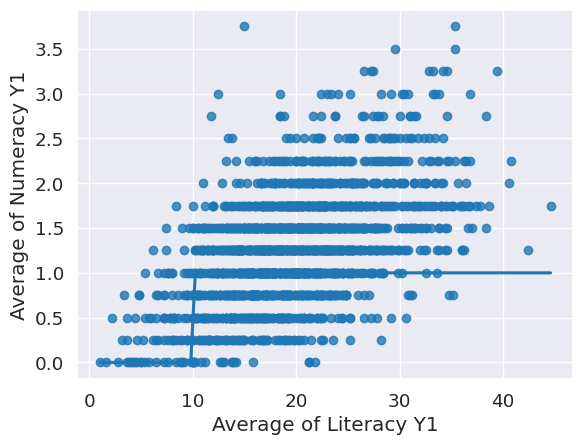

In [ ]:
sns.regplot(x=records['Average of Literacy Y1'], y=records['Average of Numeracy Y1'], logistic=True, ci=None)

In [ ]:
skills_cols = [
    'Average of Literacy Y1', 'Average of Numeracy Y1',
    'Average of Literacy Y2', 'Average of Numeracy Y2'
]

records[skills_cols].corr()

,Average of Literacy Y1,Average of Numeracy Y1,Average of Literacy Y2,Average of Numeracy Y2
Average of Literacy Y1,1.000000,0.521737,0.738738,0.464905
Average of Numeracy Y1,0.521737,1.000000,0.397362,0.566007
Average of Literacy Y2,0.738738,0.397362,1.000000,0.419838
Average of Numeracy Y2,0.464905,0.566007,0.419838,1.000000


In [ ]:
from scipy.stats import pointbiserialr

for col in skills_cols:
    r, p = pointbiserialr(records['At_Risk_Numeracy'], records[col])
    print(f"{col}: r = {r:.3f}, p = {p:.3f}")

Average of Literacy Y1: r = -0.369, p = 0.000
Average of Numeracy Y1: r = -0.388, p = 0.000
Average of Literacy Y2: r = -0.381, p = 0.000
Average of Numeracy Y2: r = -0.414, p = 0.000


In [ ]:
from sklearn.linear_model import LogisticRegression

X = records[['Average of Literacy Y1', 'Average of Numeracy Y1']]
y = records['At_Risk_Numeracy']

logreg = LogisticRegression()
logreg.fit(X, y)

print("Coefficients:", logreg.coef_)

Coefficients: [[-0.11132412 -1.37069823]]


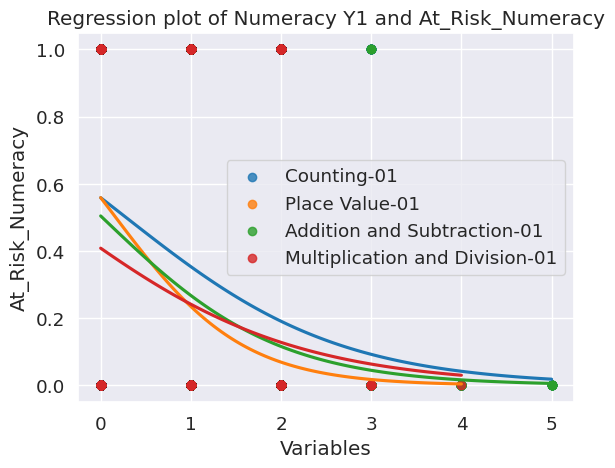

In [ ]:
# Do it for other variables

thy_han_01 = ['Counting-01','Place Value-01','Addition and Subtraction-01','Multiplication and Division-01']
for i in thy_han_01:
    sns.regplot(data=records, x=i, y=records['At_Risk_Numeracy'], logistic=True, ci=None, label=i)

plt.xlabel('Variables')  # Set x-axis label
plt.ylabel('At_Risk_Numeracy')  # Set y-axis label
plt.title('Regression plot of Numeracy Y1 and At_Risk_Numeracy')  # Set title
plt.legend()  # Display legend
plt.show()  # Display the plot


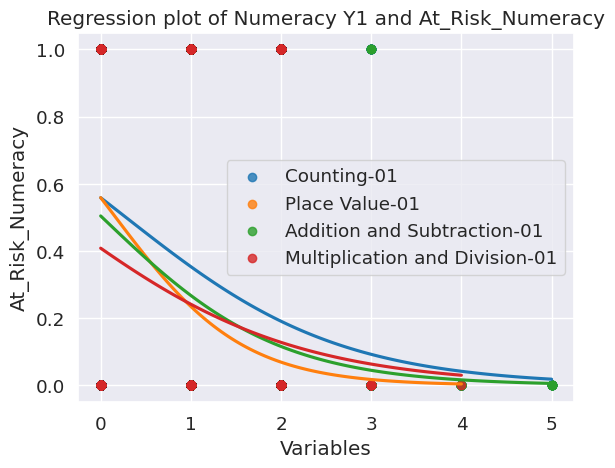

In [ ]:
# Do it for other variables

thy_han_01 = ['Counting-01','Place Value-01','Addition and Subtraction-01','Multiplication and Division-01']
for i in thy_han_01:
    sns.regplot(data=records, x=i, y=records['At_Risk_Numeracy'], logistic=True, ci=None, label=i)

plt.xlabel('Variables')  # Set x-axis label
plt.ylabel('At_Risk_Numeracy')  # Set y-axis label
plt.title('Regression plot of Numeracy Y1 and At_Risk_Numeracy')  # Set title
plt.legend()  # Display legend
plt.show()  # Display the plot


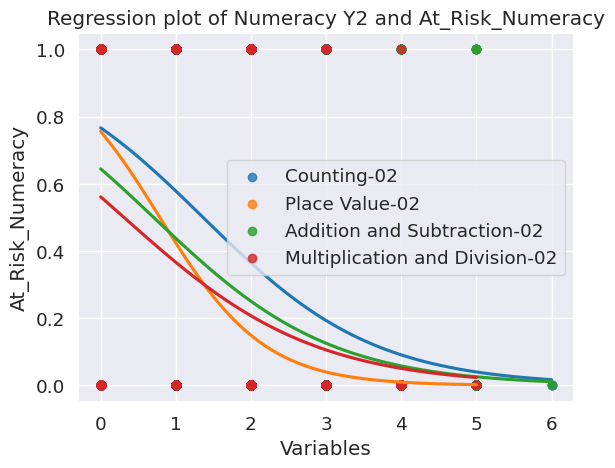

In [ ]:
# Do it for other variables

thy_han = ['Counting-02','Place Value-02','Addition and Subtraction-02','Multiplication and Division-02']
for i in thy_han:
    sns.regplot(data=records, x=i, y=records['At_Risk_Numeracy'], logistic=True, ci=None, label=i)

plt.xlabel('Variables')  # Set x-axis label
plt.ylabel('At_Risk_Numeracy')  # Set y-axis label
plt.title('Regression plot of Numeracy Y2 and At_Risk_Numeracy')  # Set title
plt.legend()  # Display legend
plt.show()  # Display the plot


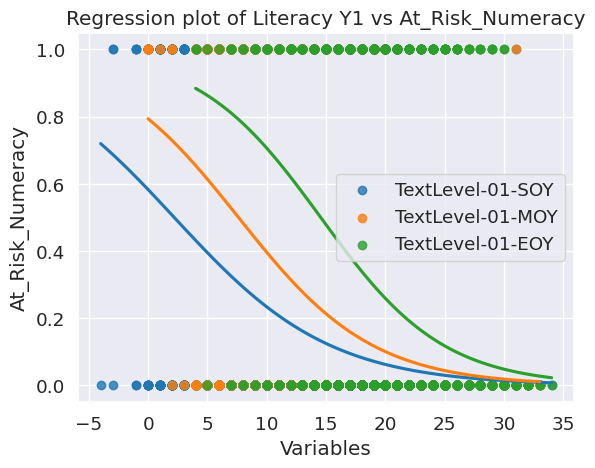

In [ ]:
# Define the specific columns you want to loop through
thy_han_03 = ['TextLevel-01-SOY', 'TextLevel-01-MOY', 'TextLevel-01-EOY']

# Loop through the specified columns and create regression plots
for col in thy_han_03:
    sns.regplot(data=records, x=col, y=records['At_Risk_Numeracy'], logistic=True, ci=None, label=col)

# Add plot enhancements
plt.xlabel('Variables')
plt.ylabel('At_Risk_Numeracy')
plt.title('Regression plot of Literacy Y1 vs At_Risk_Numeracy')
plt.legend()
plt.show()

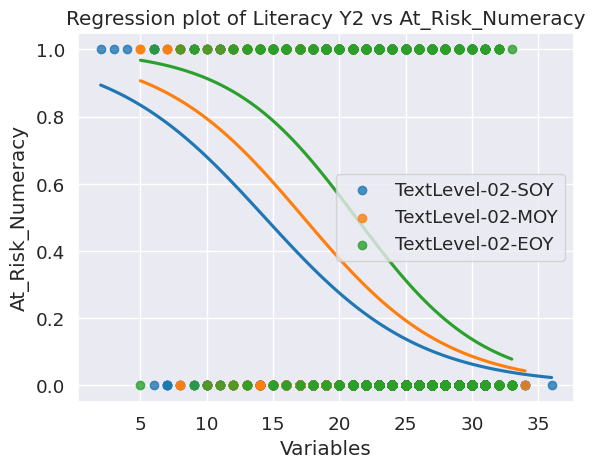

In [ ]:
# Define the specific columns you want to loop through
specified_columns = ['TextLevel-02-SOY', 'TextLevel-02-MOY', 'TextLevel-02-EOY']

# Loop through the specified columns and create regression plots
for col in specified_columns:
    sns.regplot(data=records, x=col, y=records['At_Risk_Numeracy'], logistic=True, ci=None, label=col)

# Add plot enhancements
plt.xlabel('Variables')
plt.ylabel('At_Risk_Numeracy')
plt.title('Regression plot of Literacy Y2 vs At_Risk_Numeracy')
plt.legend()
plt.show()

**Multivariable analysis**

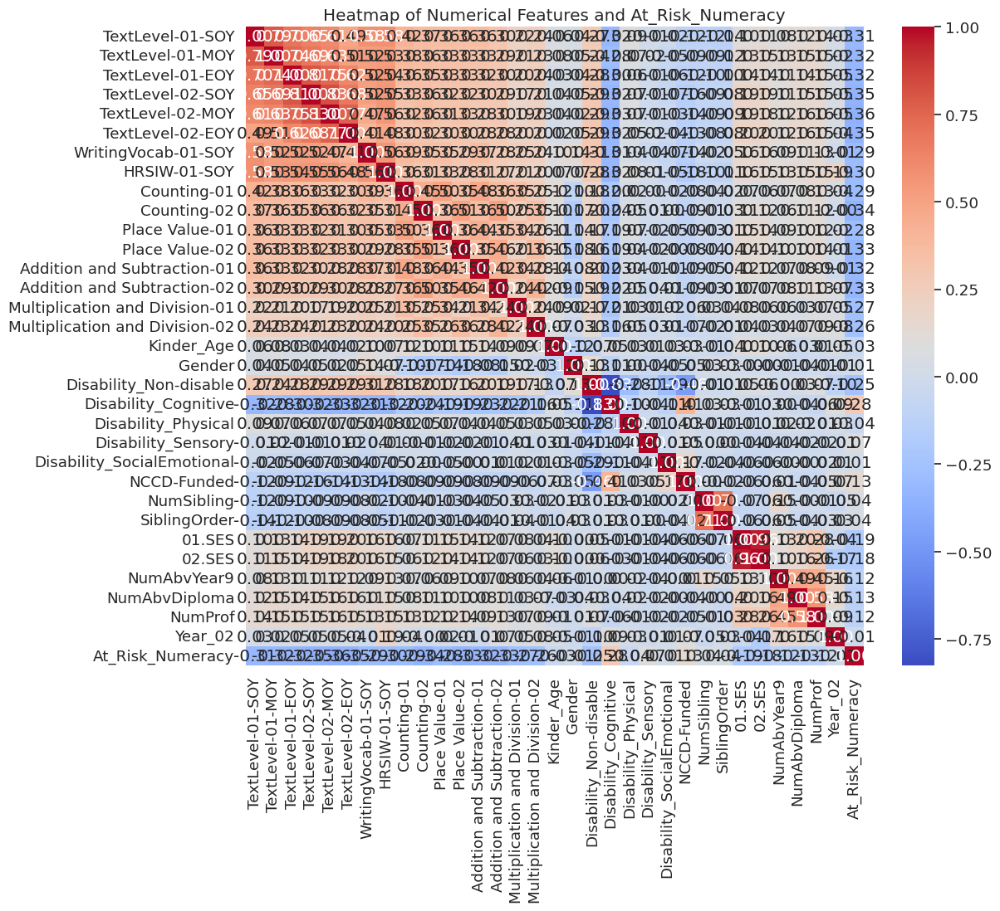

In [ ]:
# prompt: create a heat map using all numerical variables and the target feature is At_Risk_Numeracy. Do not use any variable containing "Disability"

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'records' DataFrame is already loaded as in the provided code.

# Select numerical features, excluding those containing "Disability"
numerical_cols = [col for col in records.select_dtypes(include=['number']).columns if "Disability" not in col]
numerical_cols = [col for col in records.select_dtypes(include=['number']).columns if "Average" not in col]


# Remove the target variable from the list of numerical features
numerical_cols.remove('At_Risk_Numeracy')


# Create the heatmap
plt.figure(figsize=(12, 10))  # Adjust figure size as needed
sns.heatmap(records[numerical_cols + ['At_Risk_Numeracy']].corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap of Numerical Features and At_Risk_Numeracy')
plt.show()


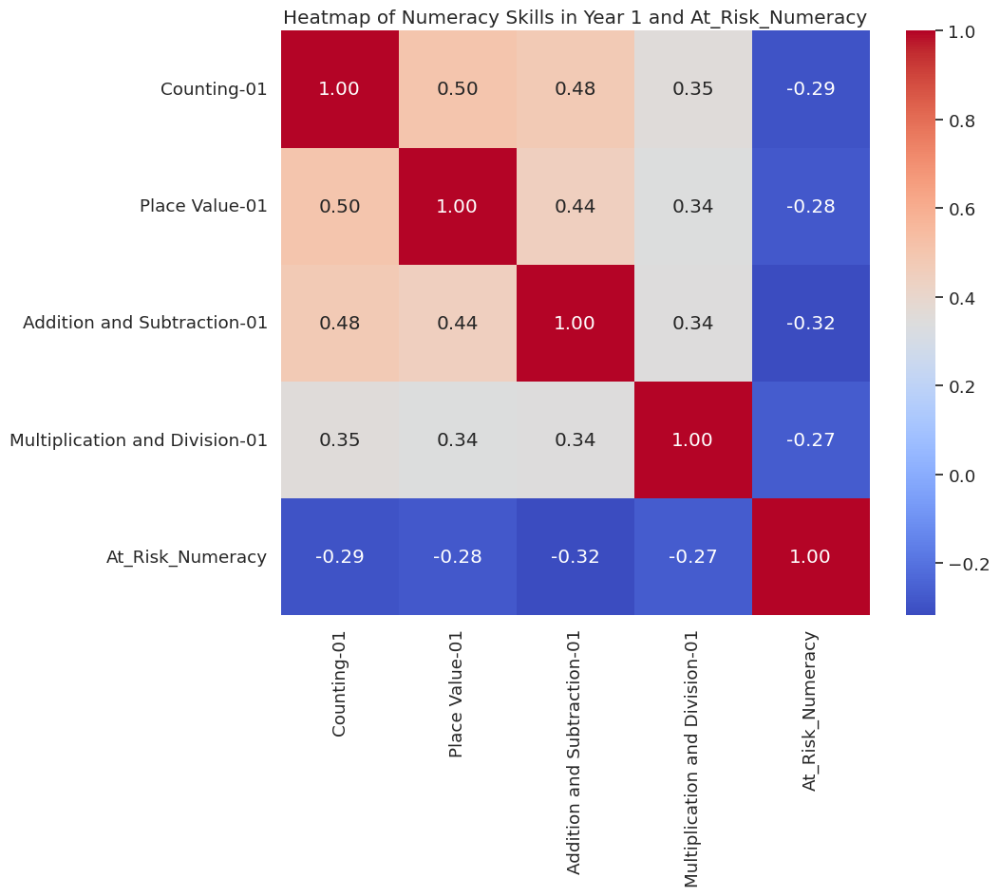

In [ ]:
# prompt: create a heat map with target feature is At_Risk_Numeracy and other 4 variables above (counting-01, ....)

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed as in your previous code

# Select the relevant columns for the heatmap
heatmap_data = records[['Counting-01', 'Place Value-01', 'Addition and Subtraction-01',
                       'Multiplication and Division-01', 'At_Risk_Numeracy']]

# Calculate the correlation matrix
correlation_matrix = heatmap_data.corr()

# Create the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap of Numeracy Skills in Year 1 and At_Risk_Numeracy')
plt.show()


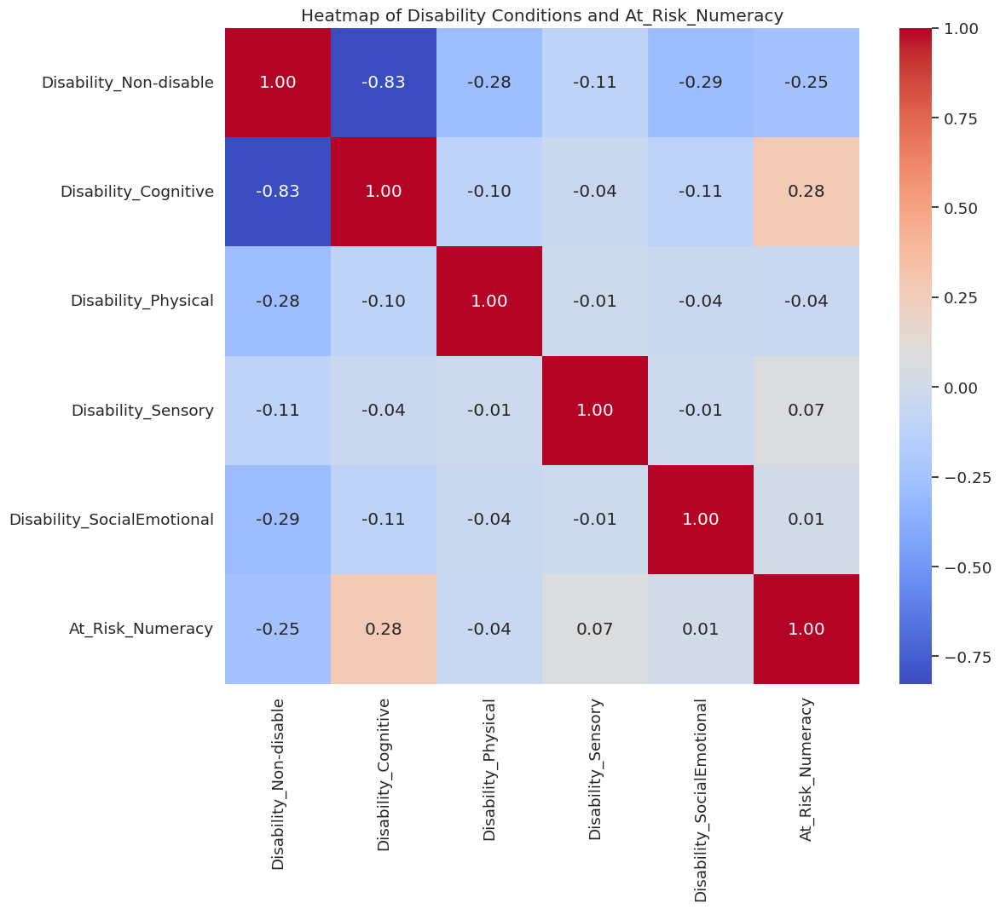

In [ ]:


# prompt: generate a heat map between target feature (At_Risk_Numeracy) and  TextLevels in Y1 and Y2, Writing Vocab

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed

# Select the relevant columns for the heatmap
heatmap_data = records[['Disability_Non-disable', 'Disability_Cognitive','Disability_Physical','Disability_Sensory'
                        ,'Disability_SocialEmotional','At_Risk_Numeracy']]

# Calculate the correlation matrix
correlation_matrix = heatmap_data.corr()

# Create the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap of Disability Conditions and At_Risk_Numeracy')
plt.show()

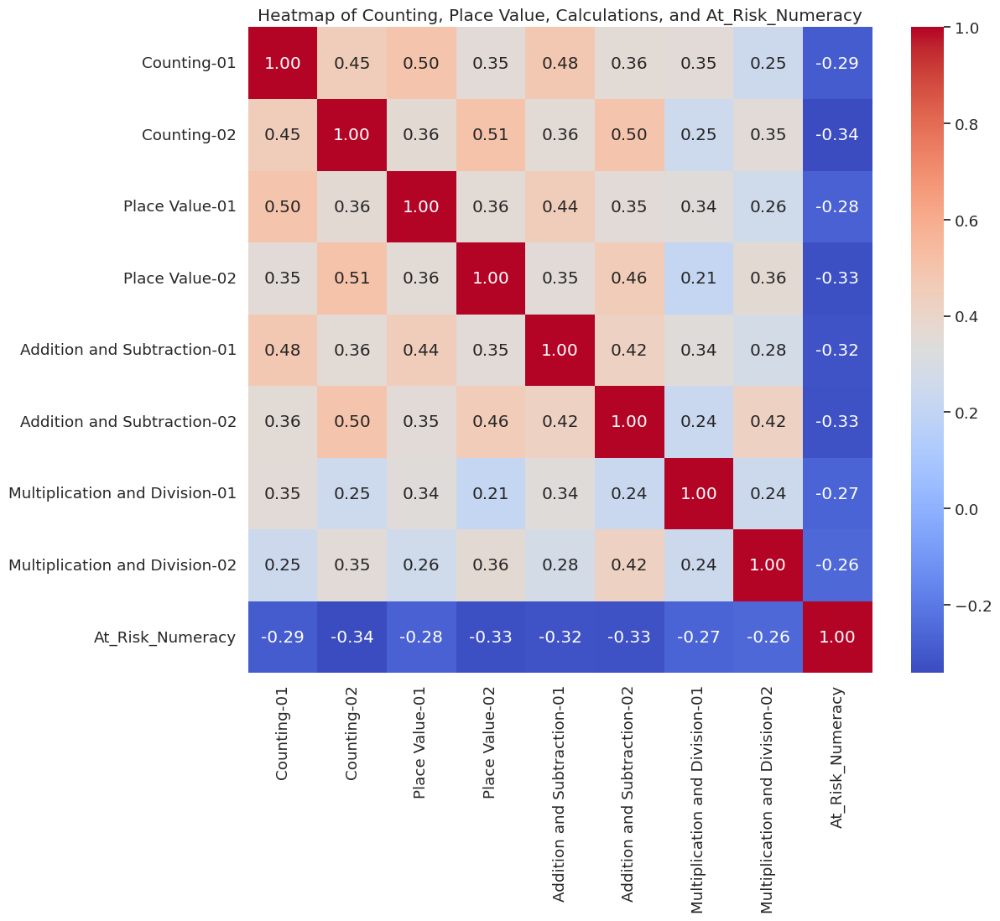

In [ ]:


# prompt: generate a heat map between target feature (At_Risk_Numeracy) and  TextLevels in Y1 and Y2, Writing Vocab

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed

# Select the relevant columns for the heatmap
heatmap_data = records[['Counting-01', 'Counting-02', 'Place Value-01', 'Place Value-02',
                  'Addition and Subtraction-01', 'Addition and Subtraction-02',
                   'Multiplication and Division-01', 'Multiplication and Division-02', 'At_Risk_Numeracy']]

# Calculate the correlation matrix
correlation_matrix = heatmap_data.corr()

# Create the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap of Counting, Place Value, Calculations, and At_Risk_Numeracy')
plt.show()

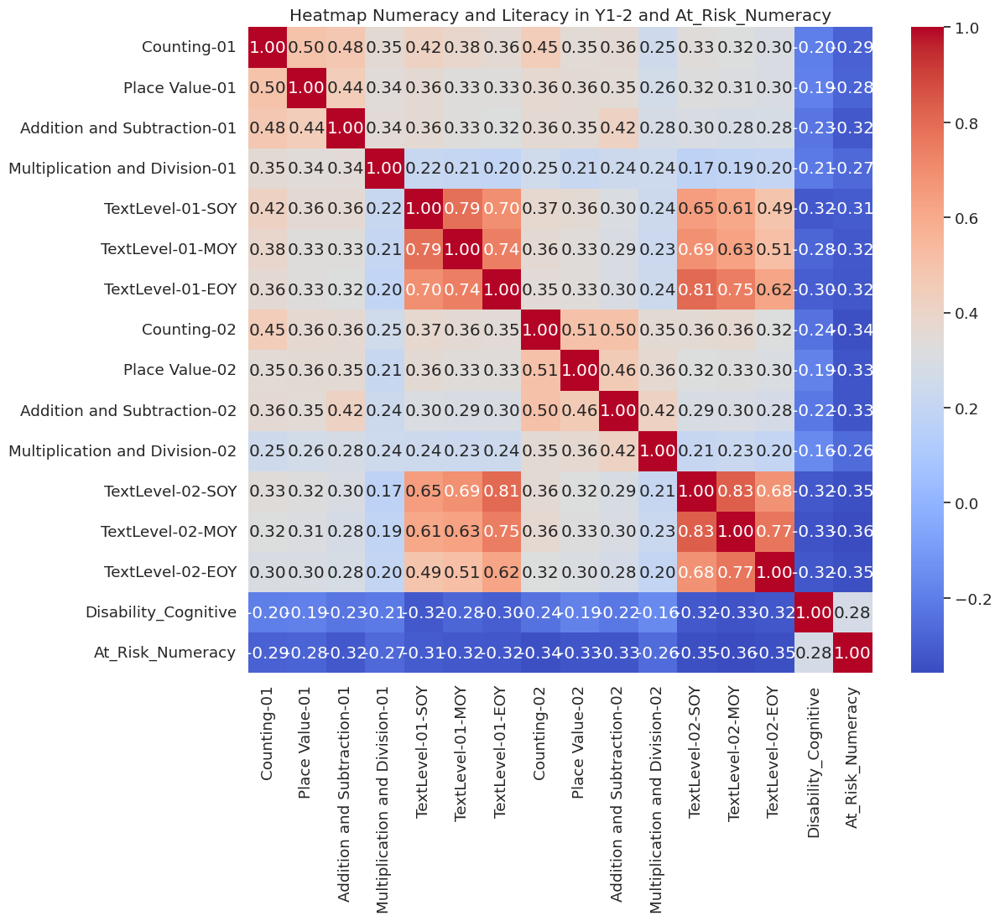

In [ ]:


# prompt: generate a heat map between target feature (At_Risk_Numeracy) and  TextLevels in Y1 and Y2, Writing Vocab

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed

# Select the relevant columns for the heatmap
heatmap_data = records[['Counting-01','Place Value-01','Addition and Subtraction-01','Multiplication and Division-01',
                        'TextLevel-01-SOY', 'TextLevel-01-MOY', 'TextLevel-01-EOY',
                        'Counting-02', 'Place Value-02','Addition and Subtraction-02','Multiplication and Division-02',
                        'TextLevel-02-SOY', 'TextLevel-02-MOY', 'TextLevel-02-EOY', 'Disability_Cognitive',
                        'At_Risk_Numeracy']]

# Calculate the correlation matrix
correlation_matrix = heatmap_data.corr()

# Create the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap Numeracy and Literacy in Y1-2 and At_Risk_Numeracy')
plt.show()

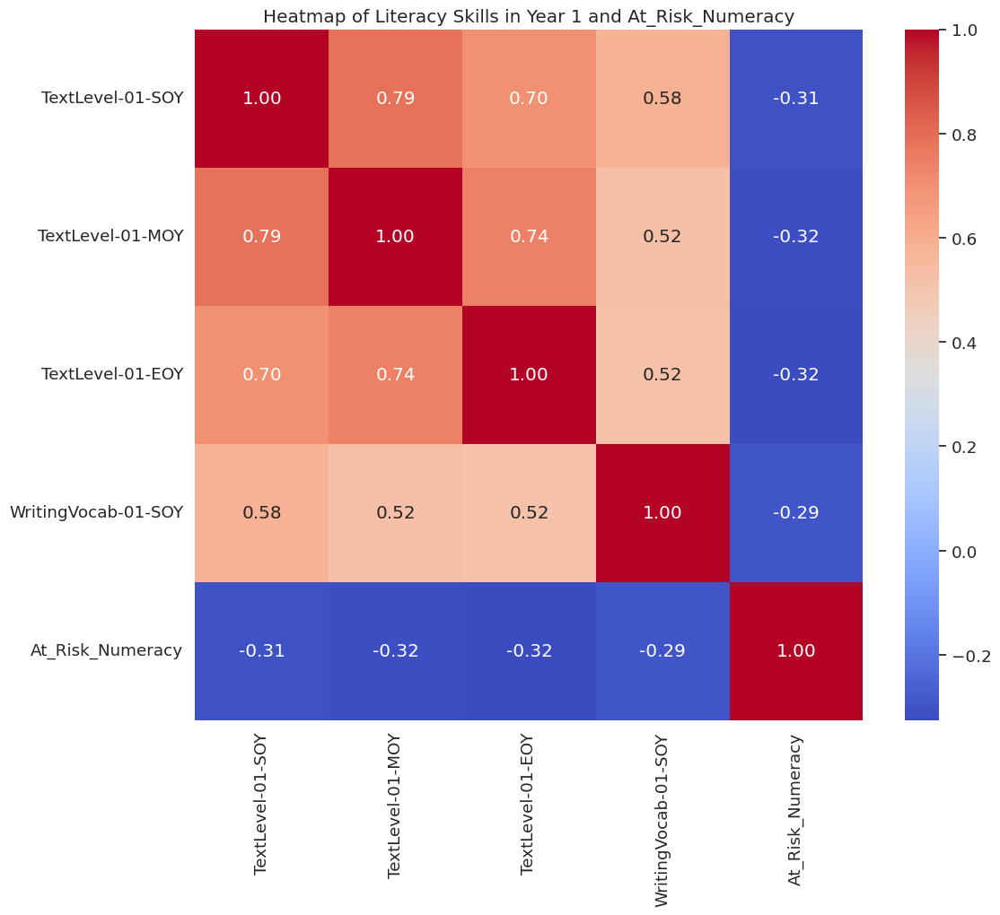

In [ ]:
# prompt: generate a heat map between target feature (At_Risk_Numeracy) and  TextLevels in Y1 and Y2, Writing Vocab

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed

# Select the relevant columns for the heatmap
heatmap_data = records[['TextLevel-01-SOY', 'TextLevel-01-MOY', 'TextLevel-01-EOY', 'WritingVocab-01-SOY',

                       'At_Risk_Numeracy']]

# Calculate the correlation matrix
correlation_matrix = heatmap_data.corr()

# Create the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap of Literacy Skills in Year 1 and At_Risk_Numeracy')
plt.show()


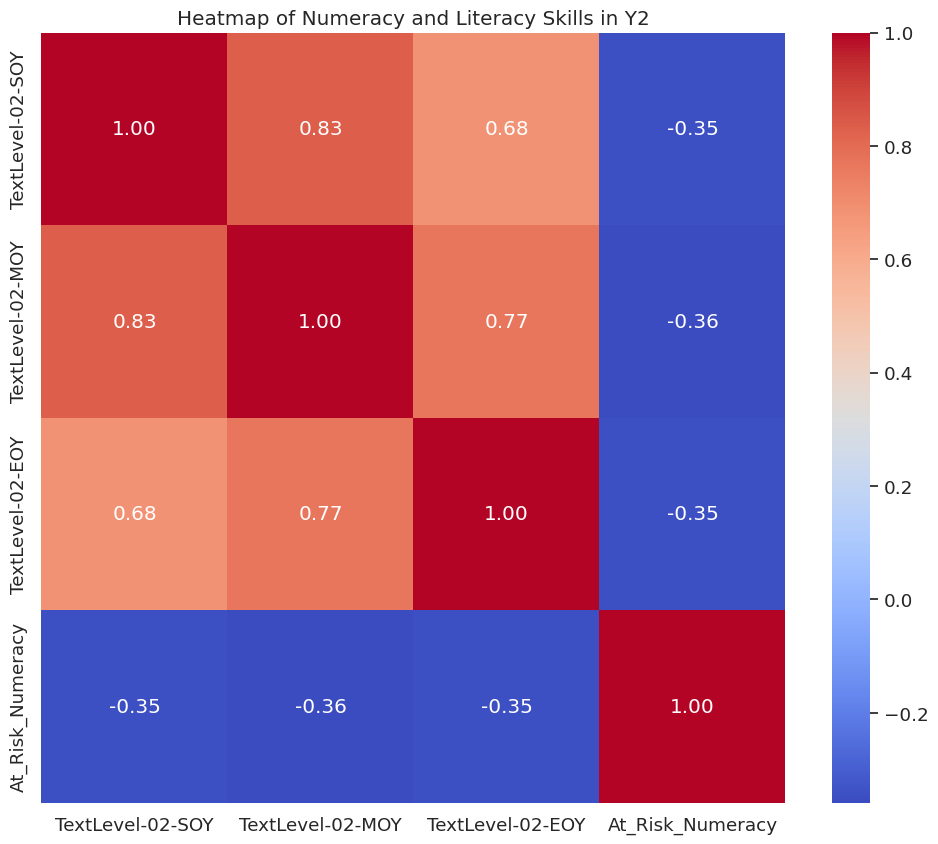

In [ ]:
# prompt: generate a heat map between target feature (At_Risk_Numeracy) and  TextLevels in Y1 and Y2, Writing Vocab

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed

# Select the relevant columns for the heatmap
heatmap_data = records[['TextLevel-02-SOY', 'TextLevel-02-MOY', 'TextLevel-02-EOY',
                       'At_Risk_Numeracy']]

# Calculate the correlation matrix
correlation_matrix = heatmap_data.corr()

# Create the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap of Numeracy and Literacy Skills in Y2')
plt.show()


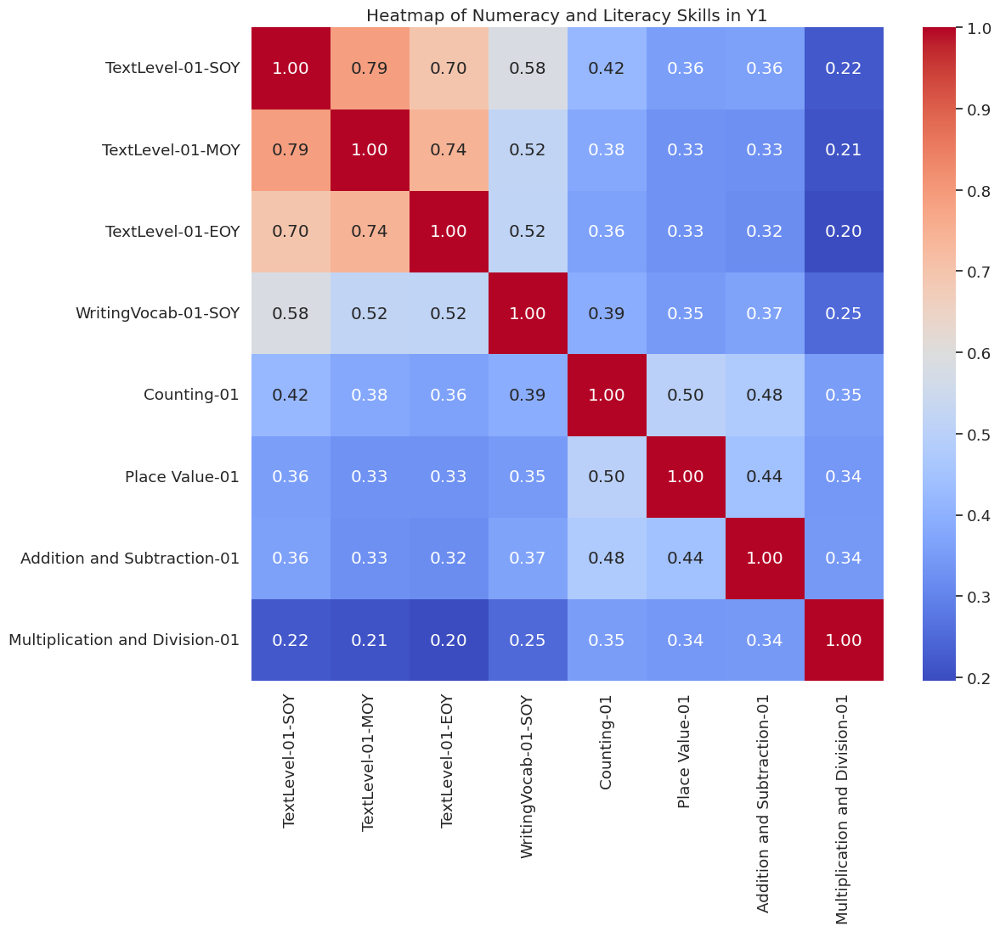

In [ ]:
# prompt: generate a heat map between target feature (At_Risk_Numeracy) and  TextLevels in Y1 and Y2, Writing Vocab

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed

# Select the relevant columns for the heatmap
heatmap_data = records[['TextLevel-01-SOY', 'TextLevel-01-MOY', 'TextLevel-01-EOY', 'WritingVocab-01-SOY',
                       'Counting-01', 'Place Value-01', 'Addition and Subtraction-01', 'Multiplication and Division-01']]

# Calculate the correlation matrix
correlation_matrix = heatmap_data.corr()

# Create the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap of Numeracy and Literacy Skills in Y1')
plt.show()


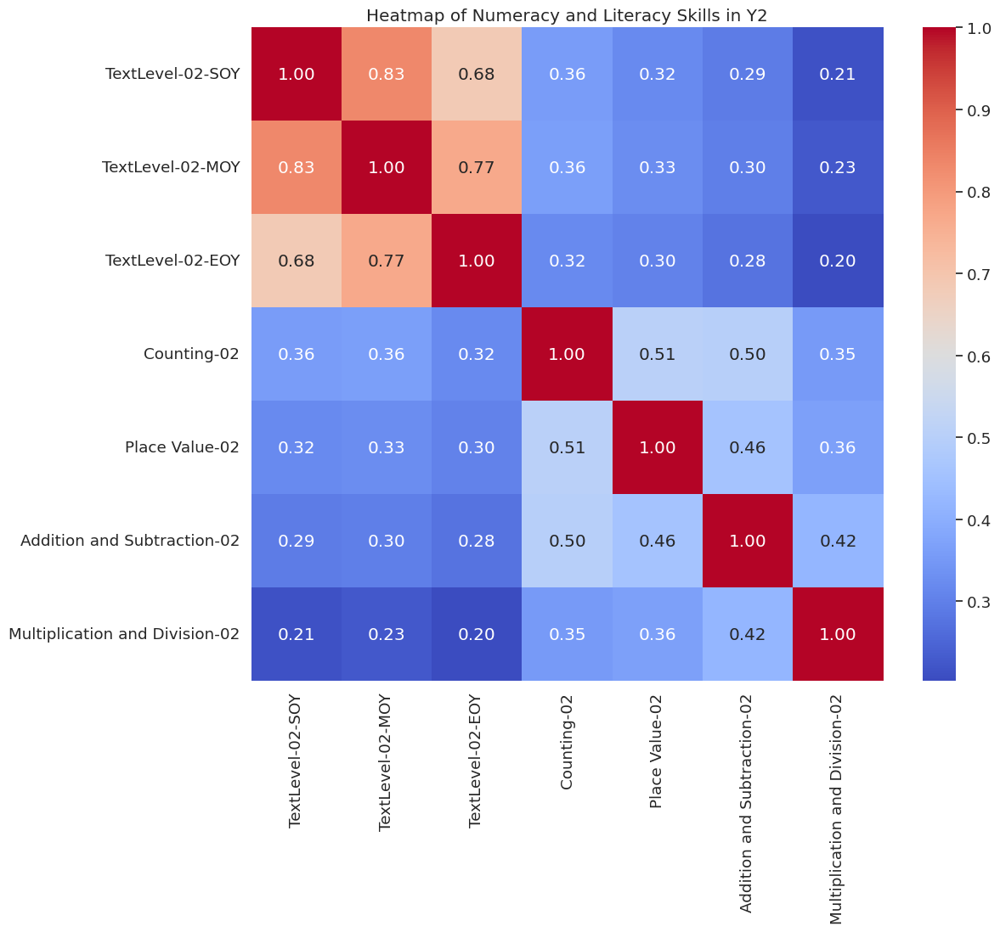

In [ ]:
# prompt: generate a heat map between target feature (At_Risk_Numeracy) and  TextLevels in Y1 and Y2, Writing Vocab

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed

# Select the relevant columns for the heatmap
heatmap_data = records[['TextLevel-02-SOY', 'TextLevel-02-MOY', 'TextLevel-02-EOY',
                       'Counting-02', 'Place Value-02', 'Addition and Subtraction-02', 'Multiplication and Division-02']]

# Calculate the correlation matrix
correlation_matrix = heatmap_data.corr()

# Create the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap of Numeracy and Literacy Skills in Y2')
plt.show()


In [ ]:
records['At_Risk_Numeracy'] = pd.to_numeric(records['At_Risk_Numeracy'], errors='coerce')


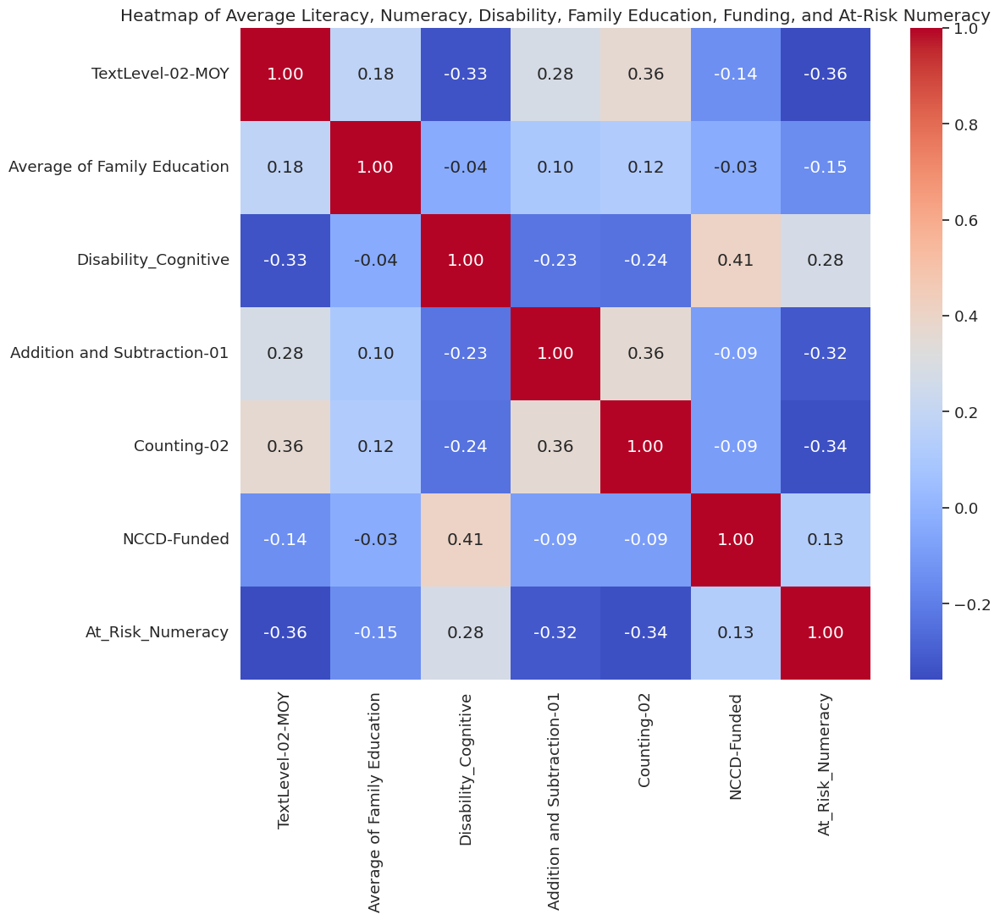

In [ ]:
# prompt: create a heat map including these variables: 'Average of Literacy Y1', 'Average of Literacy Y2',
#                         'Average of Numeracy Y1', 'Average of Numeracy Y2',
#                         'Average of Disability', 'Average of Family Education',
#                         'NCCD-Funded',
#                        'At_Risk_Numeracy'

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'records' DataFrame is already loaded and processed as in your provided code.

# Select the relevant columns for the heatmap
heatmap_data = records[[
    'TextLevel-02-MOY', 'Average of Family Education',
    'Disability_Cognitive',
    'Addition and Subtraction-01',
    'Counting-02', 'NCCD-Funded',
   'At_Risk_Numeracy'
]]

# Calculate the correlation matrix
correlation_matrix = heatmap_data.corr()

# Create the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title(
    'Heatmap of Average Literacy, Numeracy, Disability, Family Education, Funding, and At-Risk Numeracy'
)
plt.show()


What can you observe in the heatmap?

## **1.4 Select Features and Target**

Select predictors (attributes) for Classification
Set role (Target)

In [ ]:
##write your code to view info()
records.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 39 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   TextLevel-01-SOY                2000 non-null   int64  
 1   TextLevel-01-MOY                2000 non-null   int64  
 2   TextLevel-01-EOY                2000 non-null   int64  
 3   TextLevel-02-SOY                2000 non-null   int64  
 4   TextLevel-02-MOY                2000 non-null   int64  
 5   TextLevel-02-EOY                2000 non-null   int64  
 6   WritingVocab-01-SOY             2000 non-null   int64  
 7   HRSIW-01-SOY                    2000 non-null   int64  
 8   Counting-01                     2000 non-null   int64  
 9   Counting-02                     2000 non-null   int64  
 10  Place Value-01                  2000 non-null   int64  
 11  Place Value-02                  2000 non-null   int64  
 12  Addition and Subtraction-01     20

In [ ]:
# Selecting predictors

features = ['TextLevel-02-MOY', 'TextLevel-01-EOY',
            'Addition and Subtraction-01',
            'Counting-02',
            'Disability_Cognitive']

# Specify X and y
X = records[features]
y = records.At_Risk_Numeracy


## **1.5 Split the Dataset**


In [ ]:
# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=1808)  # 80% training and 20% testing


In [ ]:
# Inspect the split datasets
print(X_train.info())
print(X_test.info())

<class 'pandas.core.frame.DataFrame'>
Index: 1600 entries, 1524 to 550
Data columns (total 5 columns):
 #   Column                       Non-Null Count  Dtype
---  ------                       --------------  -----
 0   TextLevel-02-MOY             1600 non-null   int64
 1   TextLevel-01-EOY             1600 non-null   int64
 2   Addition and Subtraction-01  1600 non-null   int64
 3   Counting-02                  1600 non-null   int64
 4   Disability_Cognitive         1600 non-null   int64
dtypes: int64(5)
memory usage: 75.0 KB
None
<class 'pandas.core.frame.DataFrame'>
Index: 400 entries, 806 to 537
Data columns (total 5 columns):
 #   Column                       Non-Null Count  Dtype
---  ------                       --------------  -----
 0   TextLevel-02-MOY             400 non-null    int64
 1   TextLevel-01-EOY             400 non-null    int64
 2   Addition and Subtraction-01  400 non-null    int64
 3   Counting-02                  400 non-null    int64
 4   Disability_Cognitiv

## **1.6 Train a Logistic Regression Model and Make Predictions**

(Model implementation)

1.   Train a model using the training dataset
2.   Make prediction using the model for the test dataset




In [ ]:
# Create an initial Logistic Regression model
logreg = LogisticRegression(class_weight='balanced', max_iter=1000)

In [ ]:
# Complete the code to train Logistic Regression Classifer with the traning dataset
logreg = logreg.fit(X_train, y_train)

In [ ]:
# Complete the code to make predictions for the test dataset
y_pred = logreg.predict(X_test)

**Inspect Predictions**

In [ ]:
# Join unseen y_test with predicted value into a data frame
inspection=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})

# Join X_test with the new dataframe
inspection=pd.concat([X_test,inspection], axis=1)

inspection.head(20)

,TextLevel-02-MOY,TextLevel-01-EOY,Addition and Subtraction-01,Counting-02,Disability_Cognitive,Actual,Predicted
806,27,24,1,3,0,1,0
1224,23,17,1,3,0,1,0
503,28,29,3,4,0,0,0
409,21,17,2,3,0,0,0
1250,30,21,0,3,0,0,0
1406,23,17,1,4,0,1,0
273,28,24,1,3,0,0,0
1886,8,8,0,1,1,1,1
1478,29,29,2,4,0,0,0
554,30,25,0,2,0,0,1


In [ ]:
#get predicted probabilities for the main class
y_pred_probs = logreg.predict_proba(X_test)
y_pred_probs = y_pred_probs [:, 1]
import numpy as np
y_pred_adjusted = np.where(y_pred_probs > 0.4, 1, 0)

In [ ]:
#join unseen y_test with predicted value and probability
inspection=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred, 'Probability':y_pred_probs})
#join X_test with the new dataframe
inspection=pd.concat([X_test,inspection], axis=1)
inspection.sample(20)


,TextLevel-02-MOY,TextLevel-01-EOY,Addition and Subtraction-01,Counting-02,Disability_Cognitive,Actual,Predicted,Probability
1068,18,19,0,3,0,0,1,0.704176
309,32,28,1,3,0,0,0,0.188151
1243,23,26,2,4,0,0,0,0.133757
348,17,18,1,3,0,0,1,0.584489
184,25,21,0,2,0,0,1,0.682031
1742,30,25,0,4,0,0,0,0.264939
1388,25,19,2,2,0,0,0,0.390343
21,22,19,2,4,0,0,0,0.205674
1095,21,18,1,4,0,0,0,0.367498
1793,30,28,5,3,0,0,0,0.018457


**1.7 Evaluate Model Performance**


(Performance Evaluation)


1.   Calculate Accuracy, Precision, Recall, F1


Classification metrics: https://scikit-learn.org/stable/modules/model_evaluation.html#classification-metrics







In [ ]:
# Call metrics functions: Accuracy, Precision, Recall, F1 using the parameters y_test and y_pred
print("Accuracy: ", metrics.accuracy_score(y_test,y_pred))
print("Precision: ", metrics.precision_score(y_test,y_pred))
print("Recall: ", metrics.recall_score(y_test,y_pred))
print("F1: ", metrics.f1_score(y_test,y_pred))


Accuracy:  0.72
Precision:  0.463855421686747
Recall:  0.77
F1:  0.5789473684210527


Interpret the above

In [ ]:
# Print confusion matrix and evaluation report
cm = confusion_matrix(y_test, y_pred)
print(cm)
print(classification_report(y_test, y_pred))

[[211  89]
 [ 23  77]]
              precision    recall  f1-score   support

           0       0.90      0.70      0.79       300
           1       0.46      0.77      0.58       100

    accuracy                           0.72       400
   macro avg       0.68      0.74      0.68       400
weighted avg       0.79      0.72      0.74       400



**Plot ROC (Receiver operating characteristic) curve and confusion matrix**

ROC curve
https://scikit-learn.org/stable/modules/generated/sklearn.metrics.plot_roc_curve.html?highlight=plot_roc_curve#sklearn.metrics.plot_roc_curve

Confusion matrix
https://scikit-learn.org/stable/modules/generated/sklearn.metrics.plot_confusion_matrix.html?highlight=plot%20confusion%20matrix#sklearn.metrics.plot_confusion_matrix

In [ ]:
# First get the probabilities of the classes on the test set
probabilities = logreg.predict_proba(X_test)

In [ ]:
# Now get the probabilities for the positive class (Cancer)
y_prob = probabilities[:, 1]

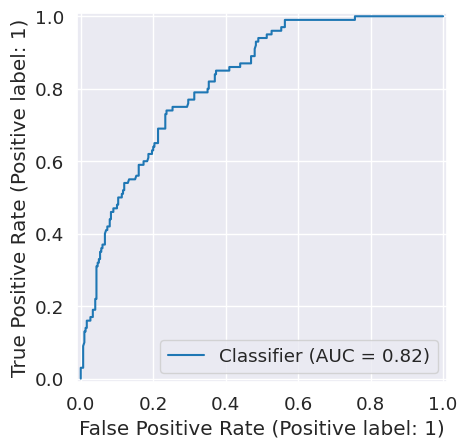

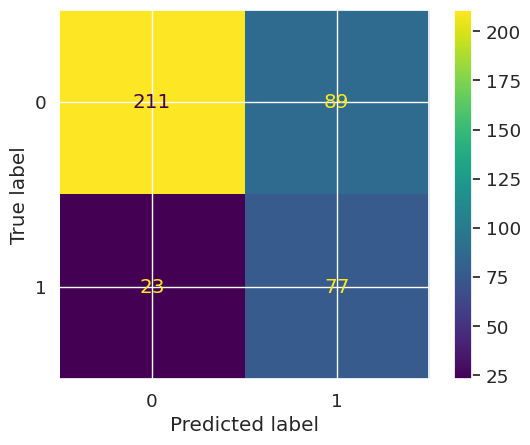

In [ ]:
# Import classes to display RocCurve and Confusion Matrix, read example from the website and try on your own
from sklearn.metrics import RocCurveDisplay
from sklearn.metrics import ConfusionMatrixDisplay

# Display RocCurve and Confusion Matrix
RocCurveDisplay.from_predictions(y_test, y_prob)
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
plt.show()

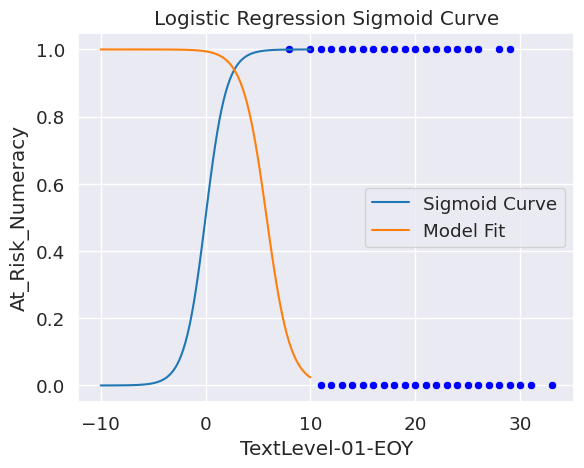

In [ ]:
# Define the sigmoid function
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

# Generate a sequence of points along the x axis
x_vals = np.linspace(-10, 10, 100)

# Calculate the corresponding y values using the model coefficients
coef = logreg.coef_.flatten()
intercept = logreg.intercept_
y_vals = sigmoid(np.dot(X_test, coef) + intercept)

# Plot the sigmoid curve using seaborn, for V7
sns.lineplot(x=x_vals, y=sigmoid(x_vals), label='Sigmoid Curve')
sns.lineplot(x=x_vals, y=sigmoid(np.dot(np.column_stack(([x_vals]*5)), coef) + intercept), label='Model Fit')
sns.set_style('darkgrid')
sns.set_context('notebook', font_scale=1.2)
sns.scatterplot(x=X_test['TextLevel-01-EOY'], y=y_test, color='blue')
plt.xlabel('TextLevel-01-EOY')
plt.ylabel('At_Risk_Numeracy')
plt.title('Logistic Regression Sigmoid Curve')
plt.legend()
plt.show()

Axes(0.125,0.11;0.775x0.77)


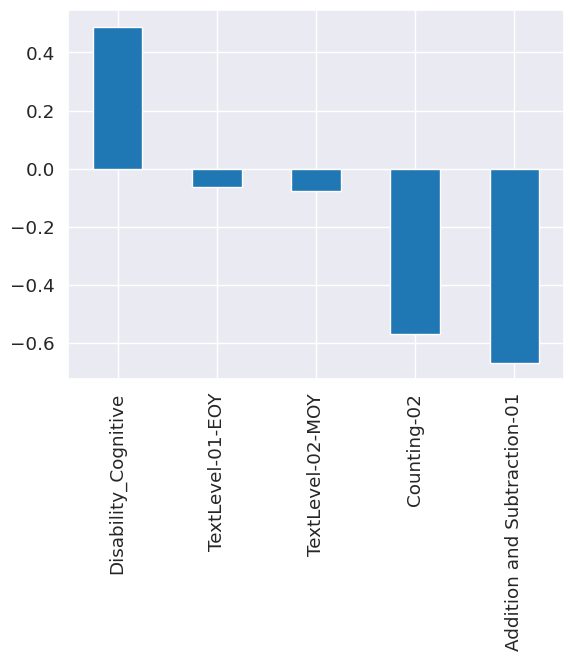

In [ ]:
# Visualise the coefficients
coefs = pd.Series(logreg.coef_[0], index=X.columns.values)
print (coefs.sort_values(ascending = False).plot(kind='bar'))

In [ ]:
# prompt: print the model formula

# Get the intercept and coefficients
intercept = logreg.intercept_[0]  # Intercept term
coefs = logreg.coef_[0]           # Coefficients for the features

# Get the feature names
feature_names = X.columns.values

# Build the equation string
equation = "At_Risk_Numeracy = {:.3f} ".format(intercept)

for i, feature_name in enumerate(feature_names):
    equation += "+ {:.3f} * {}".format(coefs[i], feature_name)

# Print the equation
equation


'At_Risk_Numeracy = 5.181 + -0.078 * TextLevel-02-MOY+ -0.063 * TextLevel-01-EOY+ -0.667 * Addition and Subtraction-01+ -0.570 * Counting-02+ 0.489 * Disability_Cognitive'

## **1.8 ROC Curve**

**Let's plot the ROC curve manually**

In [ ]:
#get predicted probabilities for the primary label
y_pred_probs = logreg.predict_proba(X_test)
y_pred_probs = y_pred_probs [:, 1]


<Axes: >

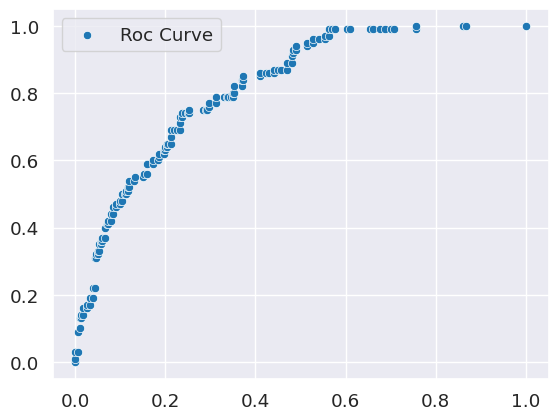

In [ ]:
#get fpr and tpr and plot the ROC curve
from sklearn.metrics import roc_curve, roc_auc_score
lr_fpr, lr_tpr, thresholds = roc_curve(y_test, y_pred_probs)
sns.scatterplot(x=lr_fpr, y=lr_tpr, label='Roc Curve')


<Axes: >

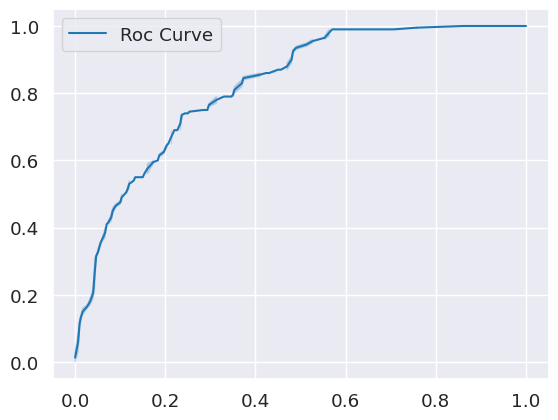

In [ ]:
sns.lineplot(x=lr_fpr, y=lr_tpr, label='Roc Curve')


In [ ]:
# Calculate ROC curve and AUC
fpr, tpr, thresholds = roc_curve(y_test, y_pred_probs)


In [ ]:
# initialize variables to store the best threshold and the highest accuracy score
best_threshold = None
highest_ac_score = 0

In [ ]:
# iterate over the thresholds and compute the accuracy score for each
for threshold in thresholds:
  y_pred_test = (y_pred_probs >= threshold).astype(int)
  ac_score = metrics.accuracy_score(y_test, y_pred_test)
  if ac_score > highest_ac_score:
    highest_ac_score = ac_score
    best_threshold = threshold

In [ ]:
# print the best threshold and the highest AUC score on the test data
print('Best threshold:', best_threshold)
print('Highest accuracy score:', highest_ac_score)

Best threshold: 0.7118158046790282
Highest accuracy score: 0.8025


In [ ]:
# Assign predictions based on the new threshold
y_pred = (y_pred_probs >= best_threshold).astype(int)

In [ ]:
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[275  25]
 [ 54  46]]
              precision    recall  f1-score   support

           0       0.84      0.92      0.87       300
           1       0.65      0.46      0.54       100

    accuracy                           0.80       400
   macro avg       0.74      0.69      0.71       400
weighted avg       0.79      0.80      0.79       400



**Discuss the above results!**

In [ ]:
# Find the index corresponding to the specific threshold
best_index = (np.abs(thresholds - best_threshold)).argmin()

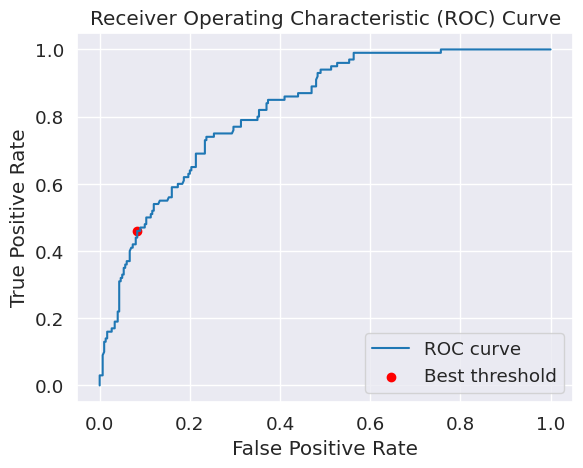

In [ ]:
# plot the ROC curve and the best point
plt.plot(fpr, tpr, label='ROC curve')
plt.scatter(fpr[best_index], tpr[best_index], marker='o', color='red', label='Best threshold')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()



---

Take a short break and do Task 2 yourself

---



# **2. Decision Tree**


## **2.1 Convert categorical data to numeric**


In [ ]:
#Convert categorical variables to numeric
#Define the custom mapping
diagnosis_mapping = {
    'FLASE': 0,
    'TRUE': 1,
}
# Convert the categories to numerical values using replace()
records['At_Risk_Numeracy'] = records['At_Risk_Numeracy'].replace(diagnosis_mapping)

## **2.2 Select Features and Target**

Select predictors (attributes) for Classification

Set role (Target)

In [ ]:
# Selecting predictors
features = ['TextLevel-02-MOY', 'TextLevel-01-EOY',
            'Addition and Subtraction-01',
            'Counting-02',
            'Disability_Cognitive']
# Specify X and y
X = records[features]
y = records.At_Risk_Numeracy


## **2.3 Split the Dataset**


In [ ]:
##write your code to split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1808, stratify=y)  # 80% training and 20% testing

#inspect the split datasets
print(X_train.head())
print(y_train.head())

print('Training dataset size:',X_train.shape[0])
print('Test dataset size:',X_test.shape[0])


      TextLevel-02-MOY  TextLevel-01-EOY  Addition and Subtraction-01  \
1524                19                17                            2   
665                 29                26                            2   
338                 26                24                            1   
1554                24                21                            2   
1769                17                14                            1   

      Counting-02  Disability_Cognitive  
1524            2                     0  
665             4                     1  
338             2                     0  
1554            5                     0  
1769            2                     0  
1524    0
665     0
338     0
1554    0
1769    0
Name: At_Risk_Numeracy, dtype: int64
Training dataset size: 1600
Test dataset size: 400


## **2.4 Train a Decision Tree Classifier and Make Predictions**

(Model implementation)

1.  Initialise /create an empty object decisiontreeclassifier (model)
2.  Train the model using the training dataset
3.  Make prediction using the model for the test dataset


In [ ]:
# Import DecisionTreeClassifier from sklearn.tree
from sklearn.tree import DecisionTreeClassifier

# Create Decision Tree classifier object
clf = DecisionTreeClassifier(criterion="entropy", max_depth=4) #defaul criterion is gini, max_depth=25

In [ ]:
# Create Decision Tree classifier object
clf = DecisionTreeClassifier(criterion="entropy", max_depth=4) #default criterion is gini, max_depth=25

In [ ]:
##write your code to train Decision Tree Classifer with the traning dataset. Hint: use .fit(X_train, y_train)
clf = clf.fit(X_train, y_train)


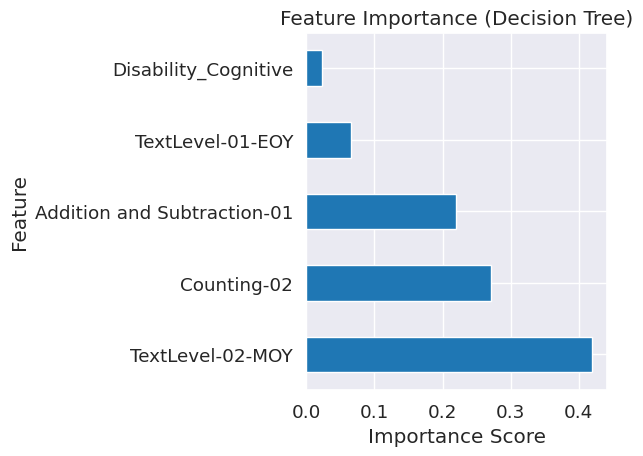

In [ ]:
importances = clf.feature_importances_
# features was defined with 12 features, but the model was trained with 8
# Update features to match the features used in the model
features = ['TextLevel-02-MOY', 'TextLevel-01-EOY',
            'Addition and Subtraction-01',
            'Counting-02'
            ,'Disability_Cognitive'

            ]
pd.Series(importances, index=features).sort_values(ascending=False).plot(kind='barh')
plt.title('Feature Importance (Decision Tree)')
plt.xlabel('Importance Score')
plt.ylabel('Feature')
plt.tight_layout()
plt.show()

In [ ]:
##write your code to make predictions for the test dataset. Hint use .predict(X_test)
y_pred = clf.predict(X_test)


In [ ]:
#join unseen y_test with predicted value into a data frame
inspection=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})

#join X_test with the new dataframe
inspection=pd.concat([X_test,inspection], axis=1)

inspection.sample(20)

,TextLevel-02-MOY,TextLevel-01-EOY,Addition and Subtraction-01,Counting-02,Disability_Cognitive,Actual,Predicted
1367,26,19,0,3,0,0,0
78,20,21,1,3,1,1,0
35,31,33,2,3,0,0,0
135,25,22,1,2,0,0,0
892,15,16,0,2,1,1,1
1029,26,28,2,2,0,0,0
1007,27,19,1,4,0,0,0
1768,27,21,1,4,0,0,0
508,23,20,1,2,0,1,0
1149,20,20,1,3,0,0,0


## **2.5 Evaluate Model Performance**


(Performance Evaluation)


1. Generate confusion matrix and classification report   
2. Calculate Accuracy, Precision, Recall, F1 separately when needed

In [ ]:
#print confusion matrix and evaluation report
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[260  40]
 [ 58  42]]
              precision    recall  f1-score   support

           0       0.82      0.87      0.84       300
           1       0.51      0.42      0.46       100

    accuracy                           0.76       400
   macro avg       0.66      0.64      0.65       400
weighted avg       0.74      0.76      0.75       400



In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

In [ ]:
#calculate evaluation metrics and print the results

accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

print(f"Accuracy: {accuracy:.5f}")
print(f"Precision: {precision:.5f}")
print(f"Recall: {recall:.5f}")
print(f"F1 Score: {f1:.5f}")

Accuracy: 0.75500
Precision: 0.51220
Recall: 0.42000
F1 Score: 0.46154


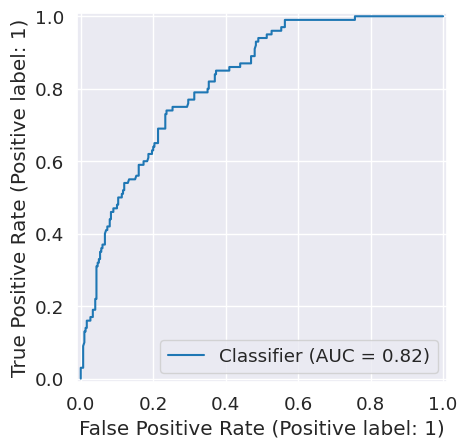

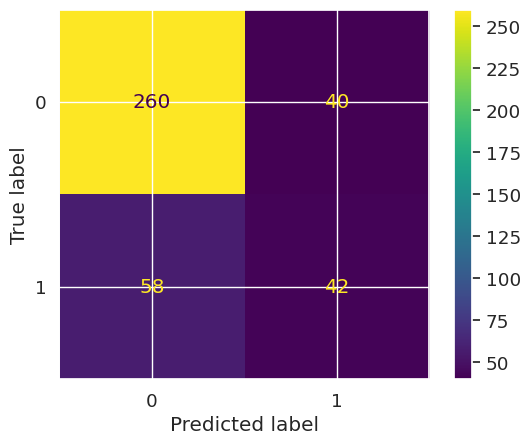

In [ ]:
# Import classes to display RocCurve and Confusion Matrix, read example from the website and try on your own
from sklearn.metrics import RocCurveDisplay
from sklearn.metrics import ConfusionMatrixDisplay

# Display RocCurve and Confusion Matrix
RocCurveDisplay.from_predictions(y_test, y_prob)
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
plt.show()

### **Plot ROC (Receiver operating characteristic) curve and confusion matrix**


In [ ]:
#get predicted probabilities for the main class
y_pred_probs = clf.predict_proba(X_test)
y_pred_probs = y_pred_probs[:, 1]

#for you to see the probabilities
y_pred_probs

array([0.2300885 , 0.2300885 , 0.025     , 0.31914894, 0.2300885 ,
       0.06870229, 0.2300885 , 0.80952381, 0.025     , 0.2300885 ,
       0.2300885 , 0.56444444, 0.2300885 , 0.025     , 0.2300885 ,
       0.06870229, 0.2300885 , 0.37931034, 0.56444444, 0.06870229,
       0.025     , 0.4137931 , 0.06870229, 0.2300885 , 0.4137931 ,
       0.025     , 0.12941176, 0.56444444, 0.12941176, 0.2300885 ,
       0.2300885 , 0.12941176, 0.12941176, 0.31914894, 0.025     ,
       0.        , 0.025     , 0.2300885 , 0.37931034, 0.56444444,
       0.2300885 , 0.37931034, 0.025     , 0.37931034, 0.025     ,
       0.2300885 , 0.80952381, 0.025     , 0.22580645, 0.2300885 ,
       0.2300885 , 0.025     , 0.37931034, 0.2300885 , 0.56444444,
       0.56444444, 0.56444444, 0.06870229, 0.37931034, 0.125     ,
       0.025     , 0.56444444, 0.2300885 , 0.06870229, 0.37931034,
       0.025     , 0.2300885 , 0.4137931 , 0.025     , 0.80952381,
       0.06870229, 0.12941176, 0.        , 0.56444444, 0.025  

<Axes: >

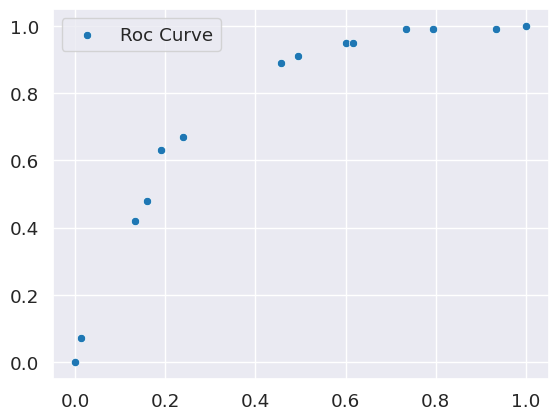

In [ ]:
#get fpr and tpr and plot the ROC curve
from sklearn.metrics import roc_curve, roc_auc_score
lr_fpr, lr_tpr, thresholds = roc_curve(y_test, y_pred_probs)
sns.scatterplot(x=lr_fpr, y=lr_tpr, label='Roc Curve')


<Axes: >

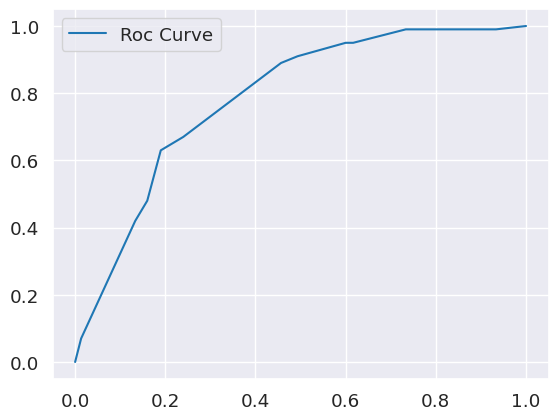

In [ ]:
sns.lineplot(x=lr_fpr, y=lr_tpr, label='Roc Curve')


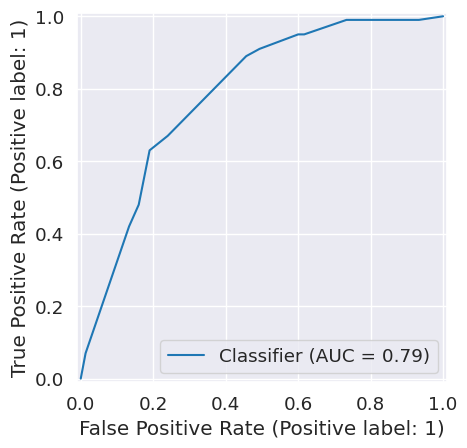

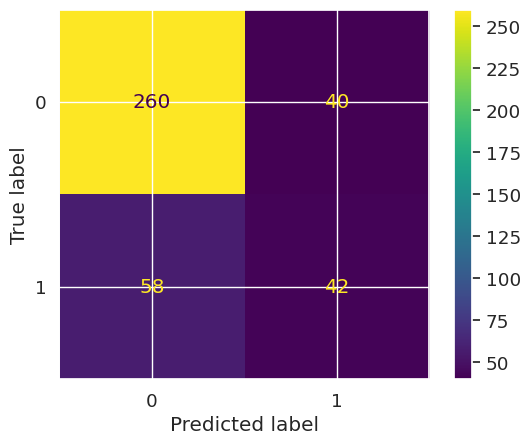

In [ ]:
from sklearn.metrics import RocCurveDisplay
from sklearn.metrics import ConfusionMatrixDisplay

RocCurveDisplay.from_predictions(y_test, y_pred_probs)
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
plt.show()

## **2.6 Visualise the trees**


### **Option 1: Extract rules and visualise the model**

In [ ]:
#Import plot_tree to  extract rules and visualise the decition tree model
from sklearn.tree import plot_tree, export_text
from pandas.io.parsers.readers import annotations


In [ ]:
# Convert feature_names to a list if it's an Index object
feature_names = list(features) if isinstance(features, pd.Index) else features

# Extract the decision rules
rules = export_text(clf, feature_names=feature_names)
print(rules)

|--- TextLevel-02-MOY <= 22.50
|   |--- Addition and Subtraction-01 <= 1.50
|   |   |--- TextLevel-01-EOY <= 19.50
|   |   |   |--- Counting-02 <= 1.50
|   |   |   |   |--- class: 1
|   |   |   |--- Counting-02 >  1.50
|   |   |   |   |--- class: 1
|   |   |--- TextLevel-01-EOY >  19.50
|   |   |   |--- Counting-02 <= 2.50
|   |   |   |   |--- class: 0
|   |   |   |--- Counting-02 >  2.50
|   |   |   |   |--- class: 0
|   |--- Addition and Subtraction-01 >  1.50
|   |   |--- Counting-02 <= 3.50
|   |   |   |--- Addition and Subtraction-01 <= 2.50
|   |   |   |   |--- class: 0
|   |   |   |--- Addition and Subtraction-01 >  2.50
|   |   |   |   |--- class: 0
|   |   |--- Counting-02 >  3.50
|   |   |   |--- Counting-02 <= 4.50
|   |   |   |   |--- class: 0
|   |   |   |--- Counting-02 >  4.50
|   |   |   |   |--- class: 0
|--- TextLevel-02-MOY >  22.50
|   |--- Counting-02 <= 3.50
|   |   |--- Addition and Subtraction-01 <= 1.50
|   |   |   |--- Disability_Cognitive <= 0.50
|   |   |   

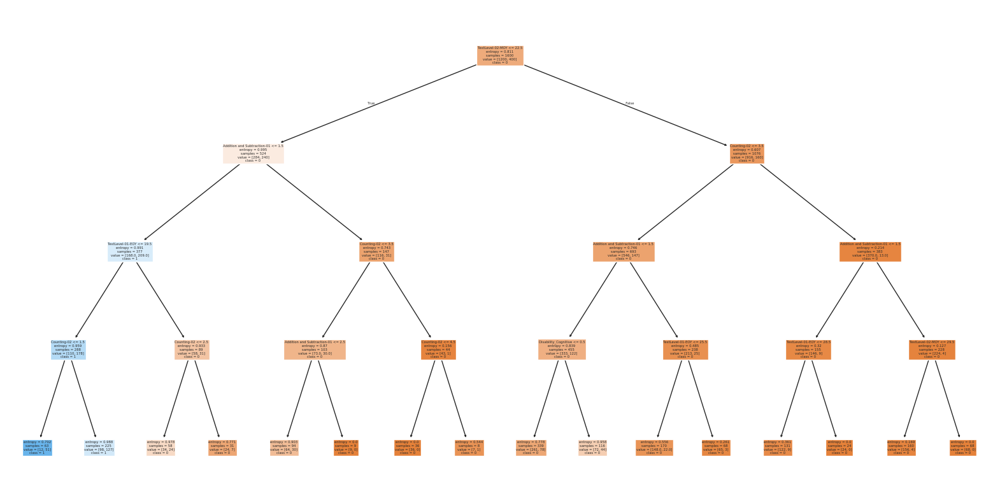

In [ ]:
# visualize the decision tree
plt.figure(figsize=(20,10))
plot_tree(clf, filled=True, feature_names=features, class_names=['0','1'])
plt.show()

### **Option 2: Use pydotplus**

In [ ]:
import six
import sys
sys.modules['sklearn.externals.six'] = six

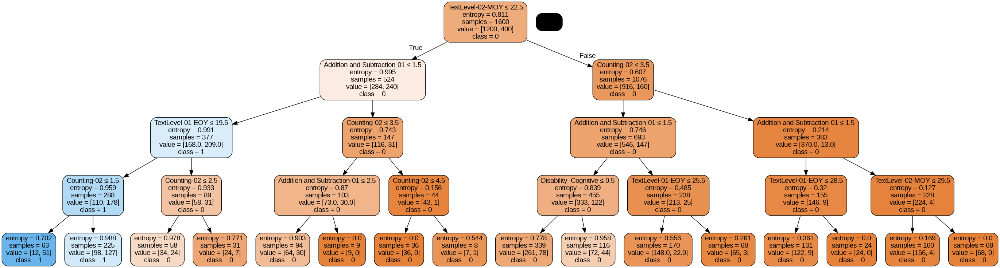

In [ ]:
#Import libraries and classes
from six import StringIO
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO
from IPython.display import Image
import pydotplus

dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = features,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('Biopsy.png')
Image(graph.create_png())

## 2.7 Model Optimization: Decision Tree


In [ ]:
from sklearn.metrics import roc_curve, roc_auc_score

In [ ]:
clf = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=4,
    min_samples_split=2,
    min_samples_leaf=2
)


In [ ]:
# Create Decision Tree classifer object
base_clf = DecisionTreeClassifier(random_state=2024)

##Write your code to train Decision Tree Classifer
base_clf = base_clf.fit(X_train, y_train)

##Write your code to predict the response for test dataset
y_pred_base = base_clf.predict(X_test)


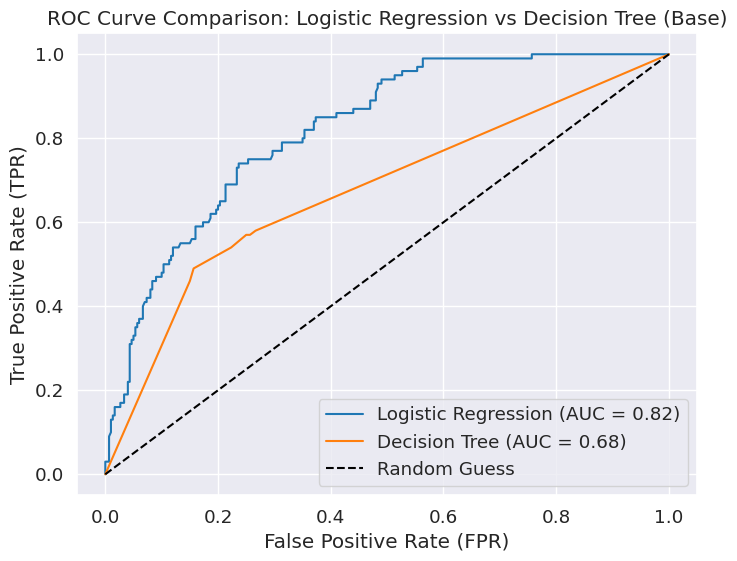

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression # Import LogisticRegression

# Create base Decision Tree classifier object
clf_base = DecisionTreeClassifier()

# Train the base Decision Tree classifier
clf_base.fit(X_train, y_train)

# Re-create and train the Logistic Regression model
# It's good practice to ensure the model is fitted in the current cell
# if it was fitted in a previous cell that might not have been run.
logreg = LogisticRegression(class_weight='balanced', max_iter=1000) # Re-initialize with parameters
logreg.fit(X_train, y_train) # Fit the logreg model

# Get predicted probabilities for both models
lr_probs = logreg.predict_proba(X_test)[:, 1]
dt_base_probs = clf_base.predict_proba(X_test)[:, 1]

# Calculate ROC curves
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
dt_base_fpr, dt_base_tpr, _ = roc_curve(y_test, dt_base_probs)

# Calculate AUC
lr_auc = roc_auc_score(y_test, lr_probs)
dt_base_auc = roc_auc_score(y_test, dt_base_probs)

# Plot ROC curves
plt.figure(figsize=(8, 6))
plt.plot(lr_fpr, lr_tpr, label=f'Logistic Regression (AUC = {lr_auc:.2f})')
plt.plot(dt_base_fpr, dt_base_tpr, label=f'Decision Tree (AUC = {dt_base_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve Comparison: Logistic Regression vs Decision Tree (Base)')
plt.legend()
plt.grid(True)
plt.show()

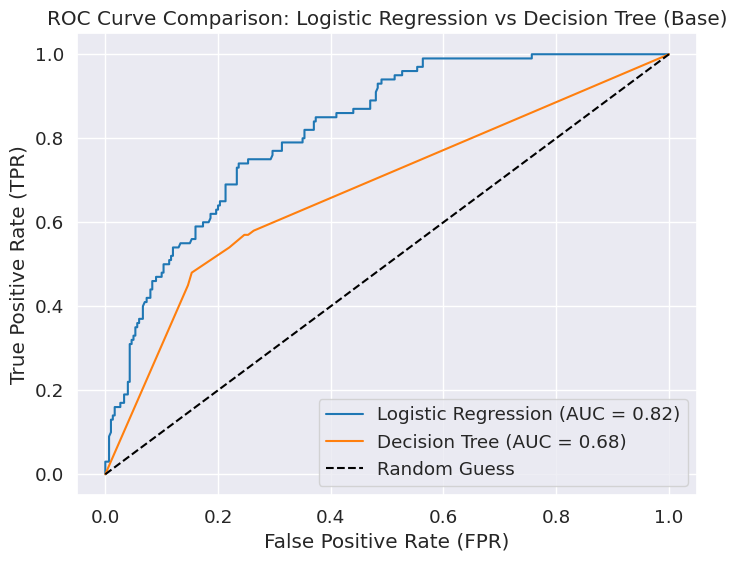

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression # Import LogisticRegression


# Create base Decision Tree classifier object
clf_base = DecisionTreeClassifier()

# Train the base Decision Tree classifier
clf_base.fit(X_train, y_train)

# Ensure logreg is fitted before predicting probabilities
# Re-initialize logreg if it's not already defined with the desired parameters,
# based on the global variables, it seems it was defined as LogisticRegression(class_weight='balanced', max_iter=1000)
logreg = LogisticRegression(class_weight='balanced', max_iter=1000)
logreg.fit(X_train, y_train)


# Get predicted probabilities for both models
lr_probs = logreg.predict_proba(X_test)[:, 1]
dt_base_probs = clf_base.predict_proba(X_test)[:, 1]

# Calculate ROC curves
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
dt_base_fpr, dt_base_tpr, _ = roc_curve(y_test, dt_base_probs)

# Calculate AUC
lr_auc = roc_auc_score(y_test, lr_probs)
dt_base_auc = roc_auc_score(y_test, dt_base_probs)

# Plot ROC curves
plt.figure(figsize=(8, 6))
plt.plot(lr_fpr, lr_tpr, label=f'Logistic Regression (AUC = {lr_auc:.2f})')
plt.plot(dt_base_fpr, dt_base_tpr, label=f'Decision Tree (AUC = {dt_base_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve Comparison: Logistic Regression vs Decision Tree (Base)')
plt.legend()
plt.grid(True)
plt.show()

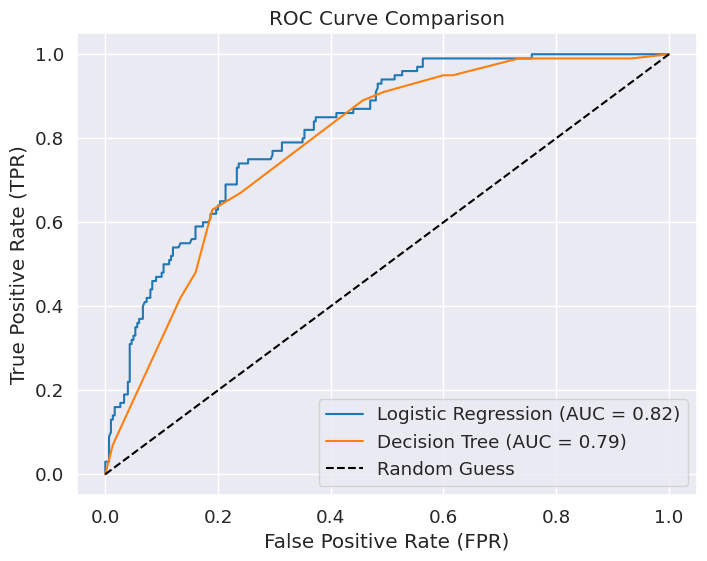

In [ ]:
# prompt: compare the ROC curve of decision tree and logistic regression model above

# Get predicted probabilities for both models
lr_probs = logreg.predict_proba(X_test)[:, 1]

# Train the clf Decision Tree classifier before using predict_proba
clf.fit(X_train, y_train) # Add this line to train the model

dt_probs = clf.predict_proba(X_test)[:, 1]
# Calculate ROC curves
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
dt_fpr, dt_tpr, _ = roc_curve(y_test, dt_probs)

# Calculate AUC
lr_auc = roc_auc_score(y_test, lr_probs)
dt_auc = roc_auc_score(y_test, dt_probs)

# Plot ROC curves
plt.figure(figsize=(8, 6))
plt.plot(lr_fpr, lr_tpr, label=f'Logistic Regression (AUC = {lr_auc:.2f})')
plt.plot(dt_fpr, dt_tpr, label=f'Decision Tree (AUC = {dt_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve Comparison')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Create Decision Tree classifer object

pre_pruned_clf = DecisionTreeClassifier(max_depth=6, max_features='sqrt', criterion='entropy', splitter='best', min_samples_split=2, random_state=1808)

##Write your code to train Decision Tree Classifer
pre_pruned_clf = pre_pruned_clf.fit(X_train, y_train)

##Write your code to predict the response for test dataset
y_pred_pre_pruned = pre_pruned_clf.predict(X_test)

In [ ]:
#using class_weight balanced
post_pruned_clf_balanced = DecisionTreeClassifier(
    random_state=2410,
    ccp_alpha=0.0029,
    class_weight='balanced'
    )
post_pruned_clf_balanced.fit(X_train, y_train)
y_pred_balanced = post_pruned_clf_balanced.predict(X_test)
print(confusion_matrix(y_test, y_pred_balanced))
print(classification_report(y_test, y_pred_balanced))


[[161 139]
 [ 12  88]]
              precision    recall  f1-score   support

           0       0.93      0.54      0.68       300
           1       0.39      0.88      0.54       100

    accuracy                           0.62       400
   macro avg       0.66      0.71      0.61       400
weighted avg       0.79      0.62      0.65       400



In [ ]:
# Create a fully grown decision tree classifier
clf_full = DecisionTreeClassifier(max_depth=4, min_samples_split=2, min_samples_leaf=2,random_state=1808)
clf_full.fit(X_train, y_train)

# Now get the cost-complexity pruning path
path = clf_full.cost_complexity_pruning_path(X_train, y_train)
ccp_alphas = path.ccp_alphas  # Different alpha values

# Let's get best ccp_alpha
best_ccp_alpha=0.0029

# Train decision trees with different alpha values (post-pruning)
decision_trees = []
for ccp_alpha in ccp_alphas:
    clf = DecisionTreeClassifier(random_state=1808, ccp_alpha=ccp_alpha)
    clf.fit(X_train, y_train)
    decision_trees.append(clf)

# Evaluate all decision trees and select the best one based on accuracy score
accuracy_scores = [accuracy_score(y_test, dt.predict(X_test)) for dt in decision_trees]
post_pruned_clf = decision_trees[accuracy_scores.index(max(accuracy_scores))]

# Make predictions on the testing data using the best decision tree
y_pred_post_pruned = post_pruned_clf.predict(X_test)


In [ ]:
#Base DT get predicted probabilities for the main class
y_pred_probs_base = base_clf.predict_proba(X_test)
y_pred_probs_base = y_pred_probs_base[:, 1]

#Pre pruned DT get predicted probabilities for the main class
y_pred_probs_pre = pre_pruned_clf.predict_proba(X_test)
y_pred_probs_pre = y_pred_probs_pre[:, 1]

#Post pruned DT get predicted probabilities for the main class
y_pred_probs_post = post_pruned_clf.predict_proba(X_test)
y_pred_probs_post = y_pred_probs_post[:, 1]

In [ ]:
fpr_base, tpr_base, thresholds_base = roc_curve(y_test, y_pred_probs_base)
auc_base=metrics.auc(fpr_base, tpr_base)

fpr_pre_pruned, tpr_pre_pruned, thresholds_pre_pruned = roc_curve(y_test, y_pred_probs_pre)
auc_pre_pruned=metrics.auc(fpr_pre_pruned, tpr_pre_pruned)

fpr_post_pruned, tpr_post_pruned, thresholds_post_pruned = roc_curve(y_test, y_pred_probs_post)
auc_post_pruned=metrics.auc(fpr_post_pruned, tpr_post_pruned)

In [ ]:
#run the below if you have problem with 'str' object is not callable - some variable is taken a built in function
import matplotlib.pyplot as plt
from importlib import reload
plt=reload(plt)

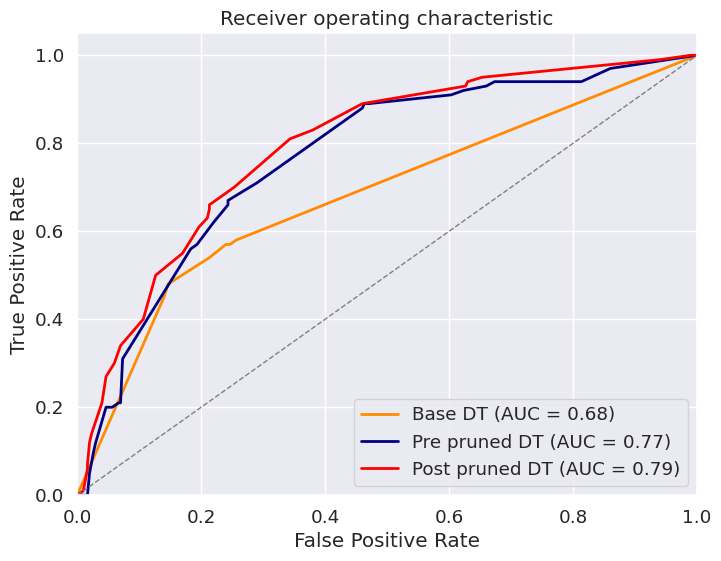

Base DT  AUC: 0.68
Pre pruned DT  AUC: 0.77
Post pruned DT  AUC: 0.79


In [ ]:
# Plot ROC curves
plt.figure(figsize=(8, 6))
plt.plot(fpr_base, tpr_base, color='darkorange', lw=2, label='Base DT (AUC = %0.2f)' % auc_base)
plt.plot(fpr_pre_pruned, tpr_pre_pruned, color='navy', lw=2, label='Pre pruned DT (AUC = %0.2f)' % auc_pre_pruned)
plt.plot(fpr_post_pruned, tpr_post_pruned, color='red', lw=2, label='Post pruned DT (AUC = %0.2f)' % auc_post_pruned)
plt.plot([0, 1], [0, 1], color='gray', lw=1, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.show()

# Compute and print AUC
print('Base DT  AUC:','%.2f' %  auc_base)
print('Pre pruned DT  AUC:','%.2f' %  auc_pre_pruned)
print('Post pruned DT  AUC:','%.2f' %  auc_post_pruned)

In [ ]:
#print confusion matrix for the base DT
print(confusion_matrix(y_test, y_pred_base))
print(classification_report(y_test, y_pred_base))

[[256  44]
 [ 52  48]]
              precision    recall  f1-score   support

           0       0.83      0.85      0.84       300
           1       0.52      0.48      0.50       100

    accuracy                           0.76       400
   macro avg       0.68      0.67      0.67       400
weighted avg       0.75      0.76      0.76       400



In [ ]:
#print confusion matrix for the pre-pruned DT
print(confusion_matrix(y_test, y_pred_pre_pruned))
print(classification_report(y_test, y_pred_pre_pruned))

[[280  20]
 [ 79  21]]
              precision    recall  f1-score   support

           0       0.78      0.93      0.85       300
           1       0.51      0.21      0.30       100

    accuracy                           0.75       400
   macro avg       0.65      0.57      0.57       400
weighted avg       0.71      0.75      0.71       400



In [ ]:
#print confusion matrix for the post_pruned DT
print(confusion_matrix(y_test, y_pred_post_pruned))
print(classification_report(y_test, y_pred_post_pruned))

[[282  18]
 [ 70  30]]
              precision    recall  f1-score   support

           0       0.80      0.94      0.87       300
           1       0.62      0.30      0.41       100

    accuracy                           0.78       400
   macro avg       0.71      0.62      0.64       400
weighted avg       0.76      0.78      0.75       400



In [ ]:
#Import plot_tree to  extract rules and visualise the decition tree model
from sklearn.tree import plot_tree, export_text

In [ ]:
# Extract the base decision rules
rules = export_text(base_clf, feature_names=features)
print(rules)

|--- TextLevel-02-MOY <= 22.50
|   |--- Addition and Subtraction-01 <= 1.50
|   |   |--- TextLevel-01-EOY <= 19.50
|   |   |   |--- Counting-02 <= 2.50
|   |   |   |   |--- Addition and Subtraction-01 <= 0.50
|   |   |   |   |   |--- Counting-02 <= 1.50
|   |   |   |   |   |   |--- TextLevel-02-MOY <= 21.50
|   |   |   |   |   |   |   |--- TextLevel-01-EOY <= 11.50
|   |   |   |   |   |   |   |   |--- TextLevel-02-MOY <= 15.50
|   |   |   |   |   |   |   |   |   |--- TextLevel-02-MOY <= 11.50
|   |   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |   |--- TextLevel-02-MOY >  11.50
|   |   |   |   |   |   |   |   |   |   |--- TextLevel-01-EOY <= 8.50
|   |   |   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |   |   |   |--- TextLevel-01-EOY >  8.50
|   |   |   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |--- TextLevel-02-MOY >  15.50
|   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   

In [ ]:
# Extract the pre_pruned decision rules
rules = export_text(pre_pruned_clf, feature_names=features)
print(rules)

|--- Counting-02 <= 3.50
|   |--- Disability_Cognitive <= 0.50
|   |   |--- TextLevel-02-MOY <= 22.50
|   |   |   |--- Counting-02 <= 0.50
|   |   |   |   |--- class: 1
|   |   |   |--- Counting-02 >  0.50
|   |   |   |   |--- TextLevel-01-EOY <= 20.50
|   |   |   |   |   |--- TextLevel-01-EOY <= 12.50
|   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |--- TextLevel-01-EOY >  12.50
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |--- TextLevel-01-EOY >  20.50
|   |   |   |   |   |--- Addition and Subtraction-01 <= 1.50
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |--- Addition and Subtraction-01 >  1.50
|   |   |   |   |   |   |--- class: 0
|   |   |--- TextLevel-02-MOY >  22.50
|   |   |   |--- Addition and Subtraction-01 <= 1.50
|   |   |   |   |--- TextLevel-01-EOY <= 26.50
|   |   |   |   |   |--- TextLevel-01-EOY <= 18.50
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |--- TextLevel-01-EOY >  18.50
|   |   |   |   |   |   |--- class: 0
|   |  

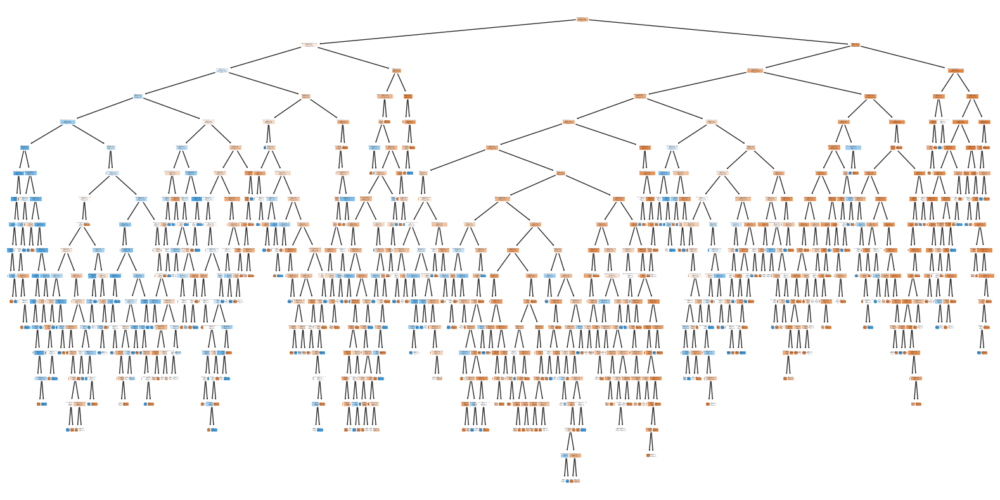

In [ ]:
# visualize the base decision tree
plt.figure(figsize=(20,10))
plot_tree(base_clf, filled=True, feature_names=features, class_names=['0','1'])
plt.show()

In [ ]:
#Import libraries and classes; do this if we skip Case 1

import six
import sys
sys.modules['sklearn.externals.six'] = six

from six import StringIO
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO
from IPython.display import Image
import pydotplus

In [ ]:
#Visualise the base decision tree
dot_data = StringIO()
export_graphviz(base_clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = features,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('Base DT.png')
Image(graph.create_png())

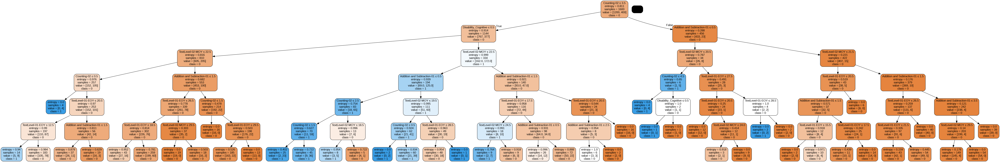

In [ ]:
#Visualise the pre-pruned decision tree
dot_data = StringIO()
export_graphviz(pre_pruned_clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = features,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('Pre_pruned DT.png')
Image(graph.create_png())

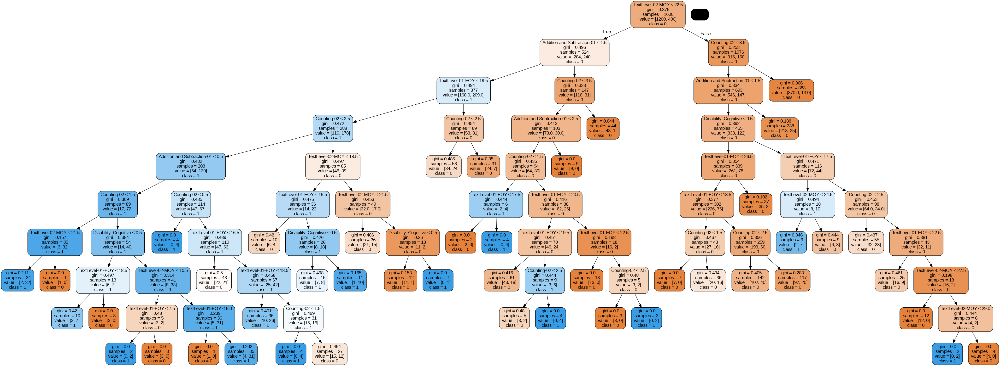

In [ ]:
#Visualise the post-pruned decision tree
dot_data = StringIO()
export_graphviz(post_pruned_clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = features,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('Base DT.png')
Image(graph.create_png())

## **2.7. Model Optimization: Logistic Regression**


### **K-fold cross validation**

In [ ]:
#Import cross validation function
from sklearn.model_selection import cross_val_score

In [ ]:
# Calculate the 95% confidence interval of the mean F1 score
def get_95ci(metric):
  n = len(metric)
  se = metric.std() / np.sqrt(n)
  t=2.262  # t-value for 95% CI
  ci = t * se
  return ci

In [ ]:
# prompt: optimize my logistic regression model using K-fold

from sklearn.model_selection import cross_val_score

# Create a new Logistic Regression model object
logreg_cv = LogisticRegression(class_weight='balanced', max_iter=1000)

# Using the features selected previously for the Logistic Regression model
X_cv = records[features] # Use the same features as defined in the Logistic Regression section
y_cv = records.At_Risk_Numeracy

recall_scores_cv = cross_val_score(logreg_cv, X_cv, y_cv, cv=10, scoring='recall')


# Print the mean accuracy scores and 95%CI of the scores
print("recall scores: %0.3f (+/- %0.3f)" % (recall_scores_cv.mean(), get_95ci(recall_scores_cv)))




recall scores: 0.752 (+/- 0.041)


### **Leave one out and Leave P out cross validation**

In [ ]:
#import leave one out
from sklearn.model_selection import LeaveOneOut
#import LeavePOut
from sklearn.model_selection import LeavePOut

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import LeaveOneOut, cross_val_score

model = LogisticRegression()
loo = LeaveOneOut()
scores = cross_val_score(model, X, y, cv=loo)  # accuracy by default

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import LeaveOneOut, cross_val_score
import numpy as np

# Function to get 95% Confidence Interval
def get_95ci(scores):
    return 1.96 * scores.std() / np.sqrt(len(scores))

# Tạo model Logistic Regression
log_reg = LogisticRegression(penalty='l2', solver='liblinear', C=1.0, random_state=1808)

# Leave-One-Out Cross-Validation
loocv = LeaveOneOut()
recall = cross_val_score(log_reg, X, y, cv=loocv, scoring='recall')


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricW

In [ ]:
print("Recall: %0.3f (+/- %0.3f)" % (recall.mean(), get_95ci(recall)))

Recall: 0.086 (+/- 0.012)


### **Hyper-parameter Optimization**

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:528: FitFailedWarning: 
30 fits failed out of a total of 120.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py", line 866, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.11/dist-packages/sklearn/base.py", line 1389, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py", line 1193, in fit
    solver = _check_solve

Best parameters found:  {'C': 1, 'penalty': 'l2', 'solver': 'lbfgs'}
Best F1 score found:  0.5826588013396952

Evaluation of the tuned Logistic Regression model:
[[211  89]
 [ 23  77]]
              precision    recall  f1-score   support

           0       0.90      0.70      0.79       300
           1       0.46      0.77      0.58       100

    accuracy                           0.72       400
   macro avg       0.68      0.74      0.68       400
weighted avg       0.79      0.72      0.74       400

Accuracy:  0.72
Precision:  0.72
Recall:  0.77
F1-score:  0.5789473684210527


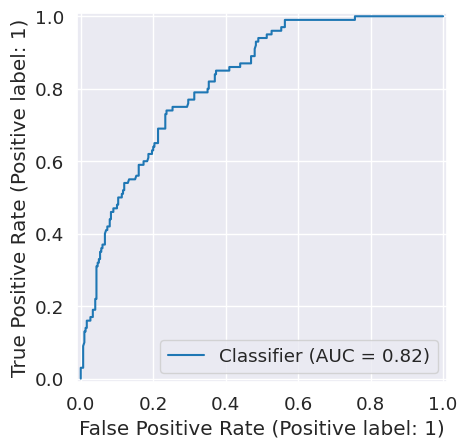

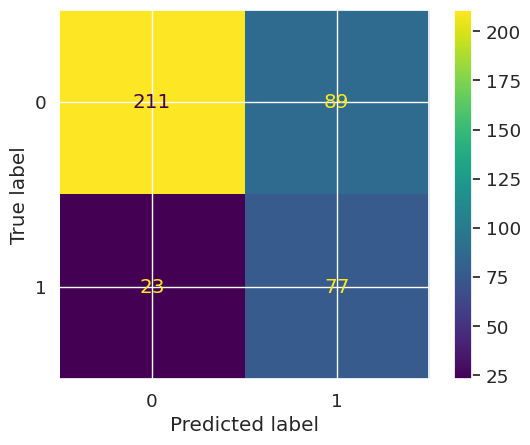

In [ ]:
# prompt: using hyperparameter optimization for my logistic regression

from sklearn.model_selection import GridSearchCV

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],  # Inverse of regularization strength
    'penalty': ['l1', 'l2'],  # Regularization penalty
    'solver': ['liblinear', 'lbfgs'] # Algorithm to use in the optimization problem
}

# Create a Logistic Regression model object
logreg_grid = LogisticRegression(class_weight='balanced', max_iter=1000)

# Create GridSearchCV object
grid_search = GridSearchCV(estimator=logreg_grid, param_grid=param_grid, cv=5, scoring='f1') # Using F1 as scoring metric

# Fit the GridSearchCV to the training data
grid_search.fit(X_train, y_train)

# Print the best parameters and best score
print("Best parameters found: ", grid_search.best_params_)
print("Best F1 score found: ", grid_search.best_score_)

# Get the best model from GridSearchCV
best_logreg_model = grid_search.best_estimator_

# Make predictions with the best model
y_pred_tuned = best_logreg_model.predict(X_test)

# Evaluate the tuned model
print("\nEvaluation of the tuned Logistic Regression model:")
print(confusion_matrix(y_test, y_pred_tuned))
print(classification_report(y_test, y_pred_tuned))
print("Accuracy: ", metrics.accuracy_score(y_test, y_pred_tuned))
print("Precision: ", metrics.accuracy_score(y_test, y_pred_tuned))
print("Recall: ", metrics.recall_score(y_test, y_pred_tuned))
print("F1-score: ", metrics.f1_score(y_test, y_pred_tuned)) # Corrected function name


# Plot ROC curve and confusion matrix for the tuned model
y_prob_tuned = best_logreg_model.predict_proba(X_test)[:, 1]
RocCurveDisplay.from_predictions(y_test, y_prob_tuned)
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_tuned)
plt.show()


## **2.8 Model Comparision: Logistic Regression vs Decision Tree**


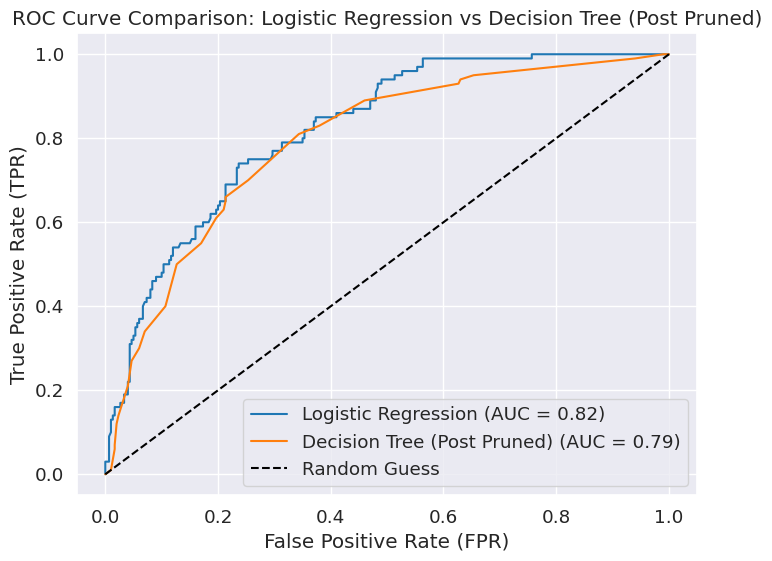

In [ ]:
# prompt: compare the AUC curve of logistic regression and decision tree (post pruned), including the random guess curve

# Re-create and train the Logistic Regression model
# Using the same parameters as in the existing code for comparison
logreg = LogisticRegression(class_weight='balanced', max_iter=1000)
logreg.fit(X_train, y_train) # Fit the logreg model

from sklearn.tree import DecisionTreeClassifier
# # Create a fully grown decision tree classifier
clf_full = DecisionTreeClassifier(max_depth=4, min_samples_split=2, min_samples_leaf=2,random_state=1808)
clf_full.fit(X_train, y_train)
# # Now get the cost-complexity pruning path
path = clf_full.cost_complexity_pruning_path(X_train, y_train)
ccp_alphas = path.ccp_alphas
# # Train decision trees with different alpha values and select the best one
decision_trees = []
for ccp_alpha in ccp_alphas:
    clf = DecisionTreeClassifier(random_state=1808, ccp_alpha=ccp_alpha)
    clf.fit(X_train, y_train)
    decision_trees.append(clf)
accuracy_scores = [accuracy_score(y_test, dt.predict(X_test)) for dt in decision_trees]
post_pruned_clf = decision_trees[accuracy_scores.index(max(accuracy_scores))]


# Get predicted probabilities for both models
lr_probs = logreg.predict_proba(X_test)[:, 1]
dt_post_pruned_probs = post_pruned_clf.predict_proba(X_test)[:, 1]

# Calculate ROC curves
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
dt_post_pruned_fpr, dt_post_pruned_tpr, _ = roc_curve(y_test, dt_post_pruned_probs)

# Calculate AUC
lr_auc = roc_auc_score(y_test, lr_probs)
dt_post_pruned_auc = roc_auc_score(y_test, dt_post_pruned_probs)

# Plot ROC curves
plt.figure(figsize=(8, 6))
plt.plot(lr_fpr, lr_tpr, label=f'Logistic Regression (AUC = {lr_auc:.2f})')
plt.plot(dt_post_pruned_fpr, dt_post_pruned_tpr, label=f'Decision Tree (Post Pruned) (AUC = {dt_post_pruned_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve Comparison: Logistic Regression vs Decision Tree (Post Pruned)')
plt.legend()
plt.grid(True)
plt.show()


# **3. K-Means Clustering**


### **3.1 Mutual Information**

In [ ]:
# prompt: convert gender into categorical

#Define the custom mapping
diagnosis_mapping = {
    'Male': 0,
    'Female': 1,
}
# Convert the categories to numerical values using replace()
records['Gender'] = records['Gender'].replace(diagnosis_mapping)


In [ ]:
cats_withoutAt_Risk_Numeracy=['Counting-01', 'Place Value-01','Addition and Subtraction-01', 'Multiplication and Division-01',
                              'Counting-02', 'Place Value-02','Addition and Subtraction-02', 'Multiplication and Division-02',
                              'NCCD-Funded','NumAbvYear9','NumAbvDiploma','NumProf', 'Gender', '01.SES', '02.SES',
                              'Disability_Cognitive', 'Disability_Non-disable','Disability_Physical','Disability_Sensory','Disability_SocialEmotional']


In [ ]:
import pandas as pd

from sklearn.metrics import mutual_info_score

In [ ]:
mi_scores = {}

# Loop through each categorical feature and calculate MI score
for cat in cats_withoutAt_Risk_Numeracy:
    mi_scores[cat] = mutual_info_score(records[cat], records['At_Risk_Numeracy'])

In [ ]:
mi_scores = {}

# Loop through each categorical feature and calculate MI score
for cat in cats_withoutAt_Risk_Numeracy:
    mi_scores[cat] = mutual_info_score(records[cat], records['At_Risk_Numeracy'])

# Sort features by their MI scores
sorted_scores = sorted(mi_scores.items(), key=lambda x: x[1], reverse=True)

# Display the scores
for feature, score in sorted_scores:
    print(f"{feature}: {score:.3f}")


Counting-02: 0.068
Addition and Subtraction-02: 0.066
Place Value-02: 0.061
Addition and Subtraction-01: 0.060
Counting-01: 0.052
Place Value-01: 0.043
Multiplication and Division-01: 0.037
Multiplication and Division-02: 0.036
Disability_Cognitive: 0.035
01.SES: 0.032
Disability_Non-disable: 0.030
02.SES: 0.030
NumAbvDiploma: 0.009
NCCD-Funded: 0.008
NumProf: 0.007
NumAbvYear9: 0.007
Disability_Sensory: 0.002
Disability_Physical: 0.001
Disability_SocialEmotional: 0.000
Gender: 0.000


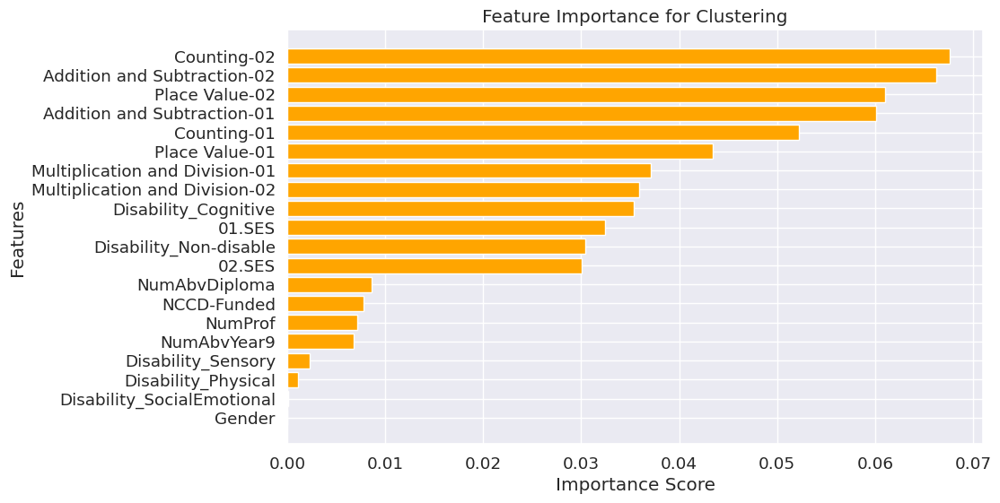

In [ ]:
features, scores = zip(*sorted_scores)
plt.figure(figsize=(10, 6))
plt.barh(features, scores, color='orange')
plt.xlabel('Importance Score')
plt.ylabel('Features')
plt.title('Feature Importance for Clustering')
plt.gca().invert_yaxis()
plt.show()

Counting-01 :

count    2000.000000
mean        1.758000
std         0.935881
min         0.000000
25%         1.000000
50%         2.000000
75%         2.000000
max         5.000000
Name: Counting-01, dtype: float64




<ipython-input-414-626fac5a920e>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=records, x=i, palette='Set2')


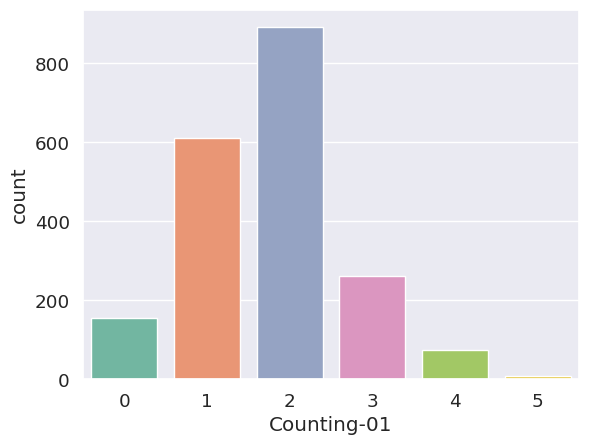

Addition and Subtraction-01 :

count    2000.000000
mean        1.290500
std         0.935172
min         0.000000
25%         1.000000
50%         1.000000
75%         2.000000
max         5.000000
Name: Addition and Subtraction-01, dtype: float64




<ipython-input-414-626fac5a920e>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=records, x=i, palette='Set2')


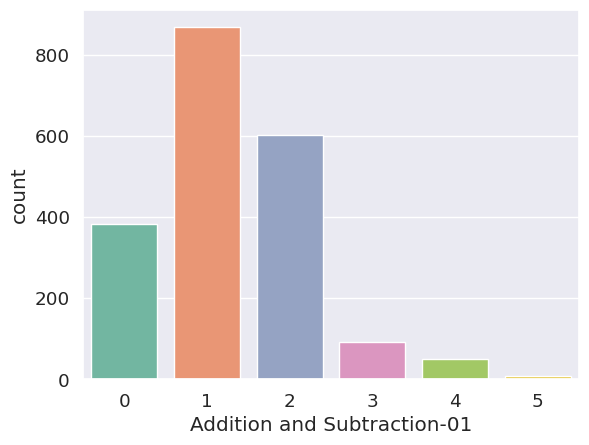

Place Value-01 :

count    2000.000000
mean        1.028500
std         0.529932
min         0.000000
25%         1.000000
50%         1.000000
75%         1.000000
max         4.000000
Name: Place Value-01, dtype: float64




<ipython-input-414-626fac5a920e>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=records, x=i, palette='Set2')


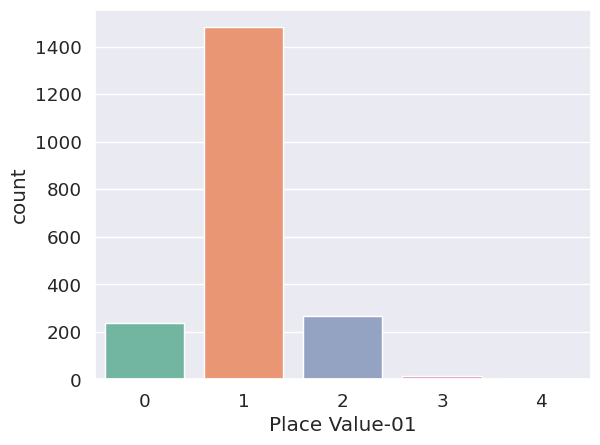

Multiplication and Division-01 :

count    2000.000000
mean        1.075500
std         0.837944
min         0.000000
25%         0.000000
50%         1.000000
75%         2.000000
max         4.000000
Name: Multiplication and Division-01, dtype: float64




<ipython-input-414-626fac5a920e>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=records, x=i, palette='Set2')


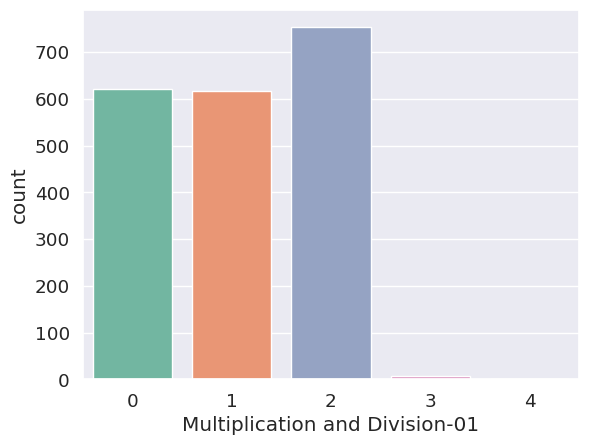

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

nums=['Counting-01','Addition and Subtraction-01','Place Value-01','Multiplication and Division-01']

# Loop through each numerical feature and print description and create countplot
for i in nums:
    print(i, ':\n')
    print(records[i].describe())
    print('\n')
    # Remove kde=True as it is not a valid parameter for countplot
    sns.countplot(data=records, x=i, palette='Set2')
    plt.show()

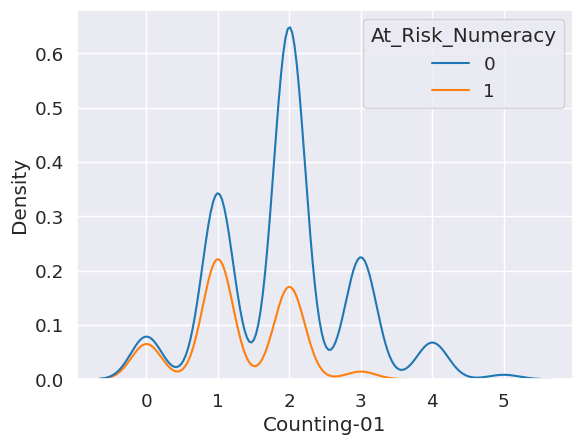

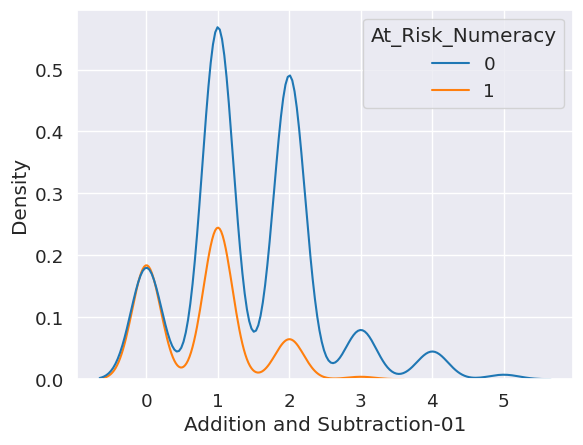

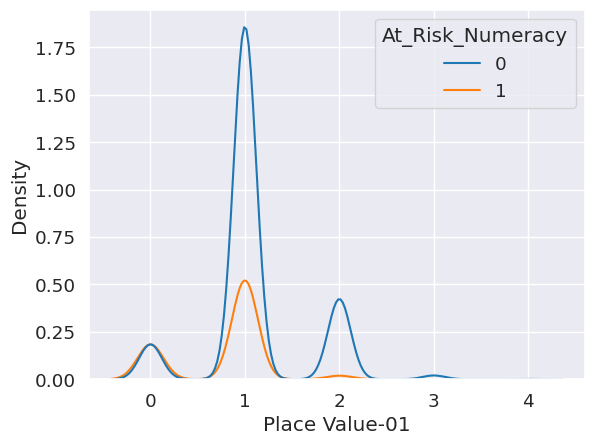

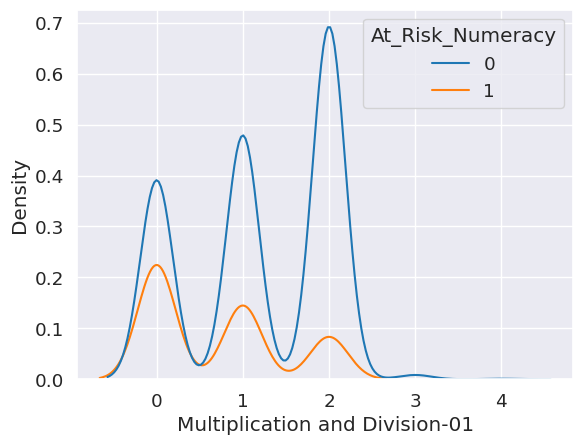

In [ ]:
for i in nums:
  plt.figure()
  sns.kdeplot(data=records, x=i, hue='At_Risk_Numeracy')

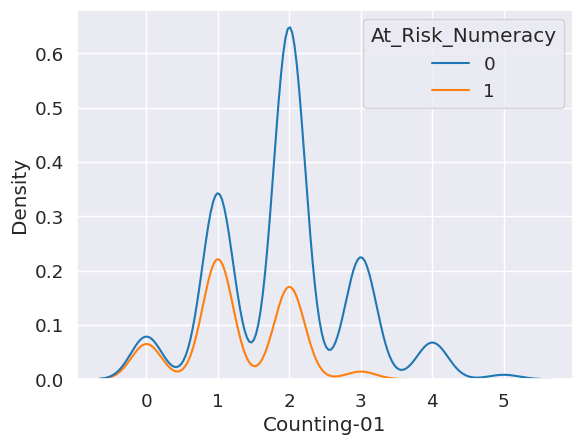

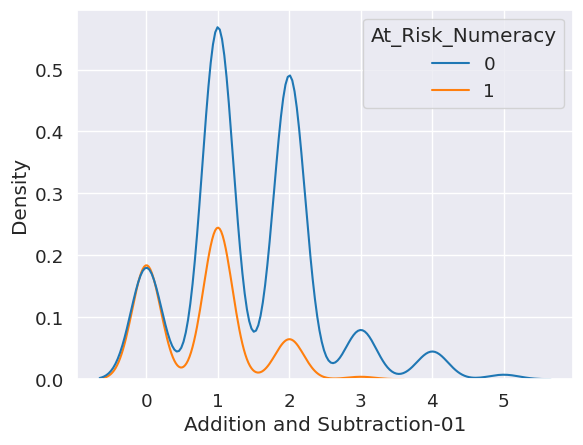

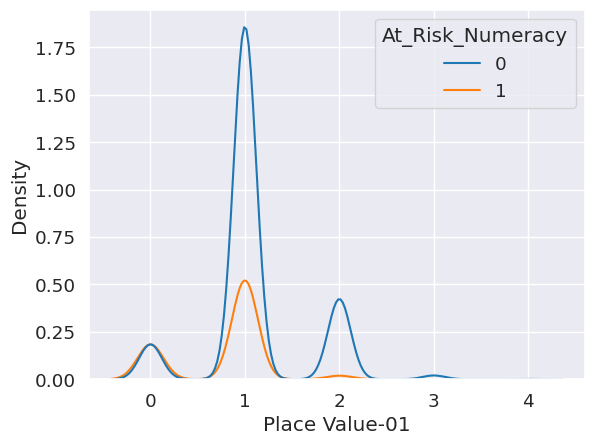

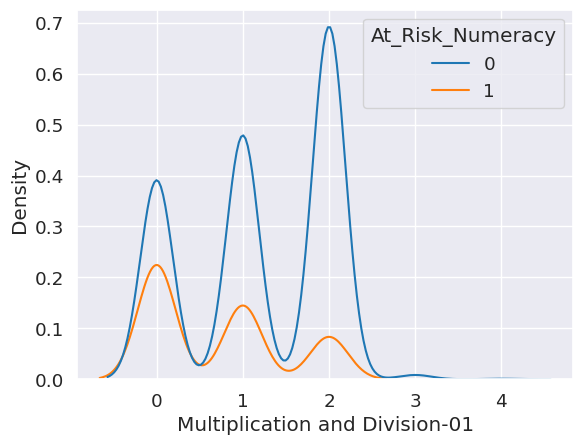

In [ ]:
for i in nums:
  plt.figure()
  # Replace None or NaN values in the 'At_Risk_Numeracy' column with a specific value (e.g., -1)
  # before calling kdeplot
  records['At_Risk_Numeracy'] = records['At_Risk_Numeracy'].fillna(-1)
  sns.kdeplot(data=records, x=i, hue='At_Risk_Numeracy')

### **3.2 Data Preparation**

In [ ]:
#convert ordinal target data to numerical
def coding_churn(x):
    if x=='TRUE': return 1
    if x=='FALSE': return 0

records['At_Risk_Numeracy'] = records['At_Risk_Numeracy'].apply(coding_churn)

In [ ]:
records

,TextLevel-01-SOY,TextLevel-01-MOY,TextLevel-01-EOY,TextLevel-02-SOY,TextLevel-02-MOY,TextLevel-02-EOY,WritingVocab-01-SOY,HRSIW-01-SOY,Counting-01,Counting-02,...,NumAbvDiploma,NumProf,Year_02,At_Risk_Numeracy,Average of Literacy Y1,Average of Literacy Y2,Average of Numeracy Y1,Average of Numeracy Y2,Average of Family Education,Average of Disability
0,16,18,25,25,30,32,20,49,4,5,...,1,2,2020,None,25.6,29.000000,2.50,3.25,1.666667,0.2
1,8,12,17,19,18,21,40,37,2,1,...,2,2,2018,None,22.8,19.333333,1.25,1.75,2.000000,0.2
2,8,12,18,18,23,22,6,30,2,1,...,0,0,2021,None,14.8,21.000000,1.75,1.25,0.666667,0.2
3,11,16,25,27,26,31,41,30,2,3,...,0,0,2021,None,24.6,28.000000,1.50,3.00,0.000000,0.2
4,9,12,17,21,24,26,26,32,2,4,...,0,0,2021,None,19.2,23.666667,1.75,2.75,0.666667,0.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,11,12,21,21,26,27,42,32,1,3,...,1,0,2016,None,23.6,24.666667,0.25,2.25,1.000000,0.2
1996,25,23,29,34,31,31,51,45,2,1,...,0,0,2021,None,34.6,32.000000,1.50,1.75,0.000000,0.2
1997,12,13,27,30,30,30,29,33,1,3,...,0,0,2016,None,22.8,30.000000,1.00,2.25,0.666667,0.2
1998,12,18,26,22,27,31,44,35,2,2,...,2,2,2021,None,27.0,26.666667,1.25,2.50,2.000000,0.2


In [ ]:
# Select relevant features for clustering

features=['TextLevel-01-MOY', 'TextLevel-02-MOY']
X = records[features]

In [ ]:
X.describe()

,TextLevel-01-MOY,TextLevel-02-MOY
count,2000.000000,2000.00000
mean,15.001500,24.07300
std,5.489496,4.69134
min,0.000000,5.00000
25%,11.000000,21.00000
50%,14.000000,24.00000
75%,18.000000,28.00000
max,33.000000,34.00000


In [ ]:
#import scaler
from sklearn.preprocessing import MinMaxScaler

In [ ]:
# Scale the features using Min-Max Scaling
scaler = MinMaxScaler()

In [ ]:
#Option 1

# Features to scale
features_to_scale = ['TextLevel-01-SOY', 'TextLevel-01-MOY', 'TextLevel-02-SOY','TextLevel-02-EOY',
                     'Textlevel-01-EOY','TextLevel-02-MOY']
# Fit and transform the features to scale on the training data
X_scaled_values = scaler.fit_transform(X)

# Create DataFrames from the scaled values
X_features_scaled = pd.DataFrame(X_scaled_values, columns=X.columns)
X_scaled = X_features_scaled

In [ ]:
X_scaled.describe()

,TextLevel-01-MOY,TextLevel-02-MOY
count,2000.000000,2000.000000
mean,0.454591,0.657690
std,0.166348,0.161770
min,0.000000,0.000000
25%,0.333333,0.551724
50%,0.424242,0.655172
75%,0.545455,0.793103
max,1.000000,1.000000


### **3.3 Model building**

In [ ]:
from sklearn.cluster import KMeans

from sklearn.metrics import mutual_info_score

In [ ]:
# Fit K-means clustering model with a 'guessed' number of clusters
k=3  #choose based on your statistics (in ASM, they require us to optimize the k)
kmeans = KMeans(n_clusters=k, n_init='auto',max_iter=300, random_state=1808)

#fit kmeans with X_scaled
kmeans.fit(X_scaled)

# Add cluster labels to original dataset
records['Cluster'] = kmeans.labels_

##3.4 Clustering Evaluation
* Within-Cluster Sum of Squares
* Silhouette score


In [ ]:
# Evaluate the model using within-cluster sum of squares (WCSS)
wcss = kmeans.inertia_
print("Within-Cluster Sum of Squares (WCSS):", '%.3f' % wcss)


Within-Cluster Sum of Squares (WCSS): 34.855


In [ ]:
from sklearn.metrics import davies_bouldin_score

# Compute the Davies-Bouldin index
dbs = davies_bouldin_score(X_scaled, kmeans.labels_)
print("Davies Bouldin index:", '%.3f' % dbs)

Davies Bouldin index: 0.846


In [ ]:
# Compute the Silhouette score for the clustering model
from sklearn.metrics import silhouette_score

silhouette_avg = silhouette_score(X_scaled, kmeans.labels_)

print('Silhouette score:', '%.3f' % silhouette_avg)

Silhouette score: 0.389


In [ ]:
#Import funtions to visualise silhouette score
from sklearn.metrics import silhouette_samples, silhouette_score
from matplotlib.ticker import FixedLocator, FixedFormatter
import matplotlib.cm as cm

In [ ]:
#fit kmeans with X_scaled to get labels
cluster_labels = kmeans.fit_predict(X_scaled)

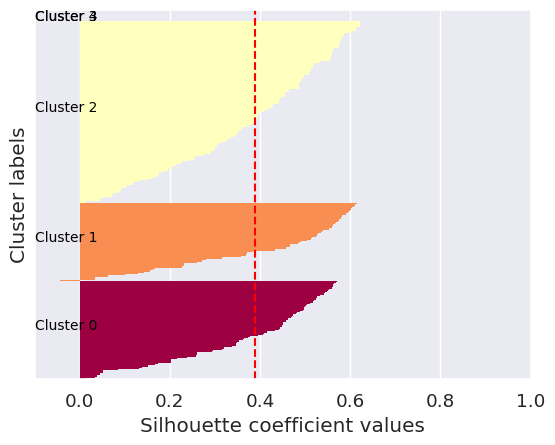

In [ ]:
# Compute silhouette scores
silhouette_avg = silhouette_score(X_scaled, cluster_labels)
sample_silhouette_values = silhouette_samples(X_scaled, cluster_labels)

# Plot silhouette diagram
n_clusters = 5
fig, ax = plt.subplots()
y_lower, y_upper = 0, 0

# Define the colormap, options include: autumn, Spectral, viridis, plasma, cool, jet
cmap = cm.Spectral

# Create a list of evenly spaced values in the range [0, 1]
values = np.linspace(0, 1, n_clusters)

for i in range(n_clusters):
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper += size_cluster_i
    color = cmap(values[i])
    ax.barh(range(y_lower, y_upper), ith_cluster_silhouette_values, height=1.0,
            edgecolor='none', color=color)
    ax.text(-0.1, (y_lower + y_upper) / 2, 'Cluster ' + str(i), color='black', fontsize=10)
    y_lower += size_cluster_i

ax.axvline(x=silhouette_avg, color="red", linestyle="--")
ax.set_xlabel("Silhouette coefficient values")
ax.set_ylabel("Cluster labels")
ax.set_yticks([])
ax.set_xlim([-0.1, 1])
ax.set_ylim([0, len(X_scaled) + (n_clusters + 1) * 10])

plt.show()

## **3.5 Optimising k**


### **Use the elbow method based on the SSE (WCSS) score**


In [ ]:
# Determine optimal number of clusters using the SSE metric
sse_scores = []
best_k=2
best_sse_score=4622.613
for i in range(2, 41):
  kmeans = KMeans(n_clusters=i, n_init=2)
  kmeans.fit(X_scaled)
  sse_score_i=kmeans.inertia_
  sse_scores.append(sse_score_i)
  if best_sse_score > sse_score_i:
    best_k = i
    best_sse_score = sse_score_i

print('Best k: ', best_k)
print('Best within cluster sum of squarred error score: ', '%.3f' %best_sse_score)

Best k:  40
Best within cluster sum of squarred error score:  3.043


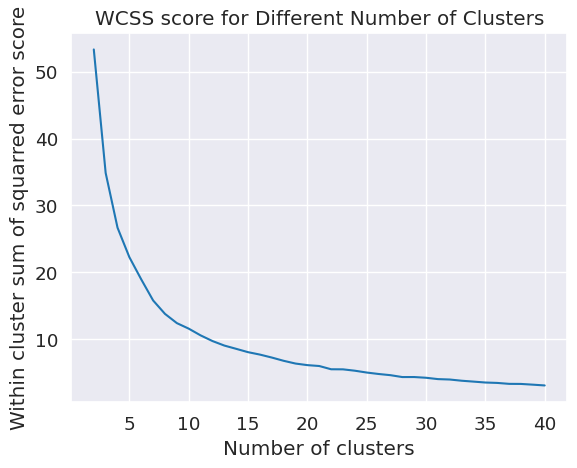

In [ ]:
# Plot the silhouette scores to determine optimal number of clusters
plt.plot(range(2,41), sse_scores)
plt.xlabel("Number of clusters")
plt.ylabel("Within cluster sum of squarred error score")
plt.title("WCSS score for Different Number of Clusters")
plt.show()

### **Optimise the number of clusters based on davies_bouldin_score**


In [ ]:
from sklearn.metrics import davies_bouldin_score

In [ ]:
# Determine optimal number of clusters using the SSE metric
dbs_scores = []
best_k=3
best_dbs_score=1
for k in range(2, 41):
  kmeans = KMeans(n_clusters=k, n_init='auto', max_iter=300, random_state=2024)
  kmeans.fit(X_scaled)
  dbs_score_k=davies_bouldin_score(X_scaled, kmeans.labels_)
  dbs_scores.append(dbs_score_k)
  if best_dbs_score > dbs_score_k:
    best_k = k
    best_dbs_score = dbs_score_k

print('Best k: ', best_k)
print('Best Davies Bouldin index: ', '%.3f' %best_dbs_score)

Best k:  8
Best Davies Bouldin index:  0.838


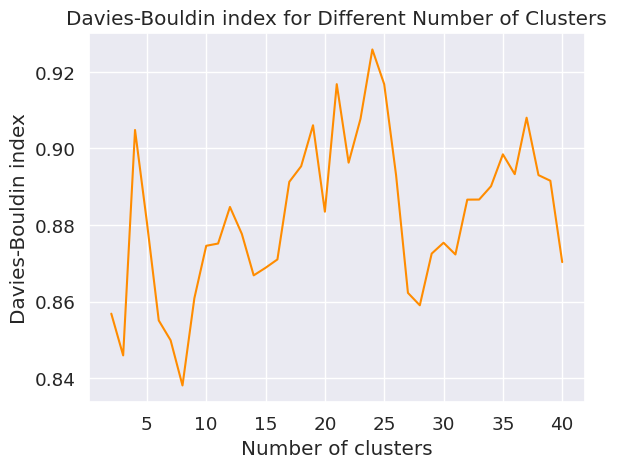

In [ ]:
# Plot the Davies-Bouldin indices to determine optimal number of clusters
plt.plot(range(2,41), dbs_scores, color='darkorange', label='Davies Bouldin index')
plt.xlabel('Number of clusters')
plt.ylabel('Davies-Bouldin index')
plt.title('Davies-Bouldin index for Different Number of Clusters')

plt.show()


### **Optimise the number of clusters based on the silhouette score**


In [ ]:
# Determine optimal number of clusters using silhouette score
sil_scores = []
best_k=3
best_sil_score=0
for i in range(2, 41):
  kmeans = KMeans(n_clusters=i, n_init=2)
  kmeans.fit(X_scaled)
  sil_score_i=silhouette_score(X_scaled, kmeans.labels_)
  sil_scores.append(sil_score_i)
  if best_sil_score < sil_score_i:
    best_k = i
    best_sil_score = sil_score_i

print('Best k: ', best_k)
print('Best silhouette score: ', '%.3f' %best_sil_score)

Best k:  2
Best silhouette score:  0.423


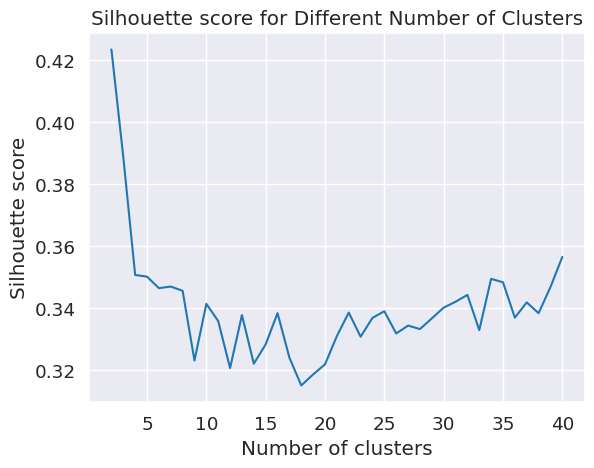

In [ ]:
# Plot the silhouette scores to determine optimal number of clusters
plt.plot(range(2,41), sil_scores)
plt.xlabel("Number of clusters")
plt.ylabel("Silhouette score")
plt.title("Silhouette score for Different Number of Clusters")
plt.show()



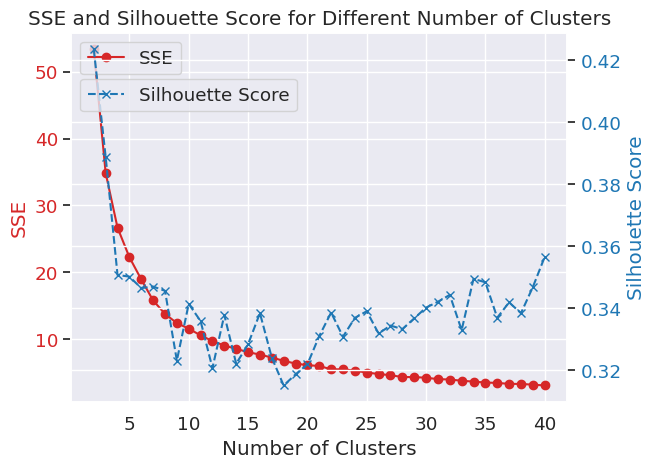

In [ ]:
# Create a figure and a set of subplots (two y-axes)
fig, ax1 = plt.subplots()

cluster_range = range(2, 41)

# Plot SSE
color = 'tab:red'
ax1.set_xlabel('Number of Clusters')
ax1.set_ylabel('SSE', color=color)
ax1.plot(cluster_range, sse_scores, marker='o', label='SSE', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# Create the second y-axis to plot Silhouette Score
ax2 = ax1.twinx()
color = 'tab:blue'
ax2.set_ylabel('Silhouette Score', color=color)
ax2.plot(cluster_range, sil_scores, marker='x', linestyle='--', label='Silhouette Score', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# Show legend
ax1.legend(loc='upper left', bbox_to_anchor=(0.0, 1.0))
ax2.legend(loc='upper left', bbox_to_anchor=(0.0, 0.9))

# Show plot
plt.title("SSE and Silhouette Score for Different Number of Clusters")
plt.show()

## **3.6 Model Selection**


In [ ]:
# let's go with k=2
n_clusters=4

In [ ]:
best_k = 4
# initialise the model object
kmeans = KMeans(n_clusters=best_k,n_init='auto', random_state=1808)

#Fit K-means clustering model with the selected number of clusters
kmeans.fit(X_scaled)


KMeans(n_clusters=4, random_state=1808)

In [ ]:
print(kmeans.n_clusters)


4


In [ ]:
# Add cluster labels to original dataset
records['Cluster'] = kmeans.labels_

In [ ]:
# Evaluate the model using within-cluster sum of squares (WCSS)
wcss = kmeans.inertia_
print("Within-Cluster Sum of Squares (WCSS):", '%.3f' % wcss)

# Compute the Davies-Bouldin index
dbs = davies_bouldin_score(X_scaled, kmeans.labels_)
print("Davies Bouldin index:", '%.3f' % dbs)

# Compute the Silhouette score for the clustering model
silhouette_avg = silhouette_score(X_scaled, kmeans.labels_)

print('Silhouette score:', '%.3f' % silhouette_avg)


Within-Cluster Sum of Squares (WCSS): 26.657
Davies Bouldin index: 0.902
Silhouette score: 0.352


**Let's create the silhouette plot**

<ipython-input-446-670b5eb3ceed>:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("Spectral") # Use the imported module to get the colormap


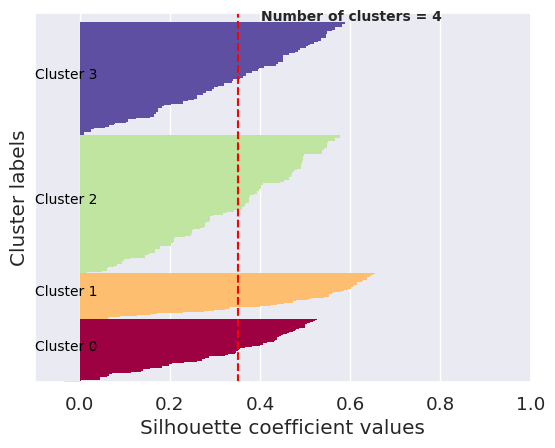

In [ ]:
# Compute sample silhouette scores
cluster_labels = kmeans.labels_
sample_silhouette_values = silhouette_samples(X_scaled, cluster_labels)

# Create a color map
import matplotlib.cm as cm # Import matplotlib.cm
# Create a color map
cmap = cm.get_cmap("Spectral") # Use the imported module to get the colormap

# Create a list of evenly spaced values in the range [0, 1]
values = np.linspace(0, 1, n_clusters)

# Plot silhouette diagram
fig, ax = plt.subplots()
y_lower, y_upper = 0, 0
for i in range(n_clusters):
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper += size_cluster_i
    color = cmap(values[i])
    ax.barh(range(y_lower, y_upper), ith_cluster_silhouette_values, height=1.0,
            edgecolor='none', color=color)
    ax.text(-0.1, (y_lower + y_upper) / 2, 'Cluster ' + str(i), color='black', fontsize=10)
    y_lower += size_cluster_i

ax.axvline(x=silhouette_avg, color="red", linestyle="--")
ax.set_xlabel("Silhouette coefficient values")
ax.set_ylabel("Cluster labels")
ax.set_yticks([])
ax.set_xlim([-0.1, 1])
ax.set_ylim([0, len(X_scaled) + (n_clusters + 1) * 10])

ax.text(silhouette_avg + 0.05, len(X_scaled) + 5, "Number of clusters = %d" % n_clusters, fontsize=10, fontweight='bold')

plt.show()

## **3.7 Post-analysis for Cluster Profiling**

### **Examine the Cluster size, centroid, and distribution**

In [ ]:
cluster_count=records.Cluster.value_counts()
cluster_count

,count
Cluster,
2,767
3,628
0,350
1,255


In [ ]:
# Get centroids of the clusters
centroids = kmeans.cluster_centers_

# Display the centroids
for idx, centroid in enumerate(centroids):
    print(f"Cluster {idx} centroid values:")
    for feature, value in zip(features, centroid):
        print(f"  {feature}: {value:.2f}")
    print("\n")

# To identify importance, you can look at the difference between centroids
for idx, feature in enumerate(features):
    print(f"Range for {feature}: {max(centroid[idx] for centroid in centroids) - min(centroid[idx] for centroid in centroids):.2f}")

Cluster 0 centroid values:
  TextLevel-01-MOY: 0.28
  TextLevel-02-MOY: 0.41


Cluster 1 centroid values:
  TextLevel-01-MOY: 0.77
  TextLevel-02-MOY: 0.84


Cluster 2 centroid values:
  TextLevel-01-MOY: 0.39
  TextLevel-02-MOY: 0.62


Cluster 3 centroid values:
  TextLevel-01-MOY: 0.50
  TextLevel-02-MOY: 0.77


Range for TextLevel-01-MOY: 0.49
Range for TextLevel-02-MOY: 0.43


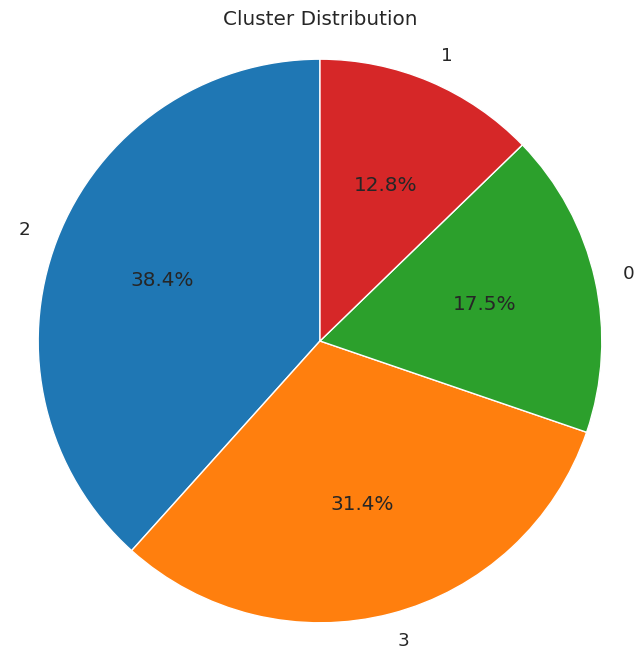

In [ ]:
# prompt: create a pie chart of cluster distribution based on the count above

# Get the counts and labels
cluster_counts = records['Cluster'].value_counts()
cluster_labels = cluster_counts.index

# Create the pie chart
plt.figure(figsize=(8, 8))
plt.pie(cluster_counts, labels=cluster_labels, autopct='%1.1f%%', startangle=90)
plt.title('Cluster Distribution')
plt.axis('equal') # Equal aspect ratio ensures the pie chart is circular.
plt.show()

### **Examine clusters based on the selected features**

**Clusters by numerical features**

In [ ]:
# compute mean, median and standard deviation per cluster
num_summary = records.groupby('Cluster')[nums] \
                .agg(['mean','median','std']) \
                .round(2)
print(num_summary)


        Counting-01              Addition and Subtraction-01               \
               mean median   std                        mean median   std   
Cluster                                                                     
0              1.24    1.0  0.81                        0.86    1.0  0.80   
1              2.42    2.0  1.01                        1.81    2.0  1.08   
2              1.66    2.0  0.81                        1.18    1.0  0.82   
3              1.89    2.0  0.92                        1.46    1.0  0.94   

        Place Value-01              Multiplication and Division-01         \
                  mean median   std                           mean median   
Cluster                                                                     
0                 0.72    1.0  0.52                           0.76    1.0   
1                 1.33    1.0  0.57                           1.36    2.0   
2                 1.00    1.0  0.46                           1.05    1.0  

In [ ]:
from sklearn.feature_selection import mutual_info_classif

# Compute MI scores
mi_scores = mutual_info_classif(
    records[nums],
    records['Cluster'] ,
    discrete_features=False,     # all features here are continuous
    n_neighbors=3,               # you can tune this
    random_state=1808
)

# Rank and display
mi = pd.Series(mi_scores, index=nums).sort_values(ascending=False).round(3)
print(mi)


Counting-01                       0.070
Place Value-01                    0.059
Addition and Subtraction-01       0.035
Multiplication and Division-01    0.025
dtype: float64


In [ ]:
records.groupby('Cluster')['TextLevel-01-MOY'].describe()

,count,mean,std,min,25%,50%,75%,max
Cluster,,,,,,,,
0,350.0,9.342857,3.285314,0.0,7.0,10.0,12.0,20.0
1,255.0,25.454902,3.209994,21.0,23.0,25.0,28.0,33.0
2,767.0,12.814863,2.682433,0.0,11.0,13.0,15.0,21.0
3,628.0,16.581210,2.537394,7.0,15.0,17.0,18.0,22.0


In [ ]:
records.groupby('Cluster')['TextLevel-02-MOY'].describe()

,count,mean,std,min,25%,50%,75%,max
Cluster,,,,,,,,
0,350.0,16.822857,3.090339,5.0,16.0,17.0,19.0,23.0
1,255.0,29.325490,1.867653,23.0,28.0,30.0,31.0,33.0
2,767.0,22.844850,1.994947,18.0,21.0,23.0,24.0,32.0
3,628.0,27.480892,2.130050,22.0,26.0,28.0,29.0,34.0


**Visualisation**

In [ ]:
records['At_Risk_Numeracy'] = y.values  # y là biến chứa nhãn 0/1
records['Cluster'] = kmeans.labels_

Text(0, 0.5, 'Count')

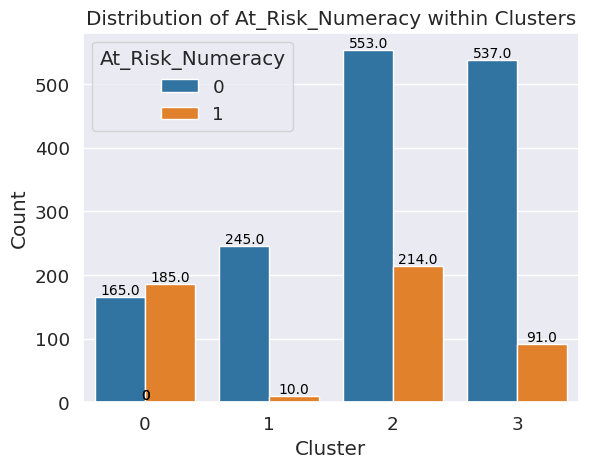

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt # Import matplotlib for plotting

# Assuming 'records' DataFrame is already loaded and processed,
# and 'Cluster' and 'At_Risk_Numeracy' columns exist.

# Create the countplot and assign it to a variable 'ax' to access patches
ax = sns.countplot(data=records, x='Cluster', hue='At_Risk_Numeracy')

# Add data labels to each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.title('Distribution of At_Risk_Numeracy within Clusters') # Add a title for clarity
plt.xlabel('Cluster') # Add an x-axis label
plt.ylabel('Count') # Add a y-axis labeplt.show() # Display the plot

In [ ]:
records.groupby('Cluster')['At_Risk_Numeracy'].value_counts(normalize=True).unstack()


At_Risk_Numeracy,0,1
Cluster,,
0,0.471429,0.528571
1,0.960784,0.039216
2,0.720991,0.279009
3,0.855096,0.144904


Text(0, 0.5, 'TextLevel_02_MOY')

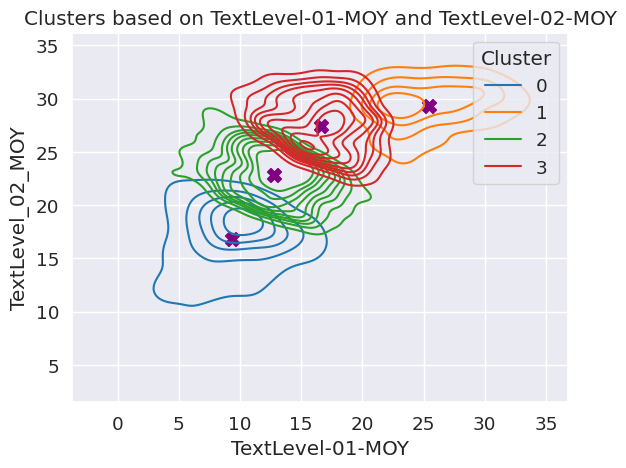

In [ ]:
# Get centroids from the kmeans model. It is based on X_scaled.
centroids = kmeans.cluster_centers_

# Reverse the scaling on the centroids. (Remember, we scaled 'MonthlyCharges' and 'tenure' ).
centroids_original = scaler.inverse_transform(centroids)

# Create the KDE plot for the records
sns.kdeplot(data=records, x='TextLevel-01-MOY', y='TextLevel-02-MOY', hue='Cluster', palette='tab10', legend='full')

# Fetch the centroids for 'MonthlyCharges' and 'tenure' columns from the reversed centroids
TextLevel_01_MOY_centroids = centroids_original[:, 0]  # 0 is the index for 'MonthlyCharges'
TextLevel_02_MOY_centroids = centroids_original[:, 1]          # 1 is the index for 'tenure'

# Overlay the centroids on the same plot
plt.scatter(TextLevel_01_MOY_centroids, TextLevel_02_MOY_centroids, c='purple', marker='X', s=100, label='Centroids')

# Setting the title and labels
plt.title('Clusters based on TextLevel-01-MOY and TextLevel-02-MOY')
plt.xlabel('TextLevel-01-MOY')
plt.ylabel('TextLevel_02_MOY')
#plt.legend(loc='upper right')



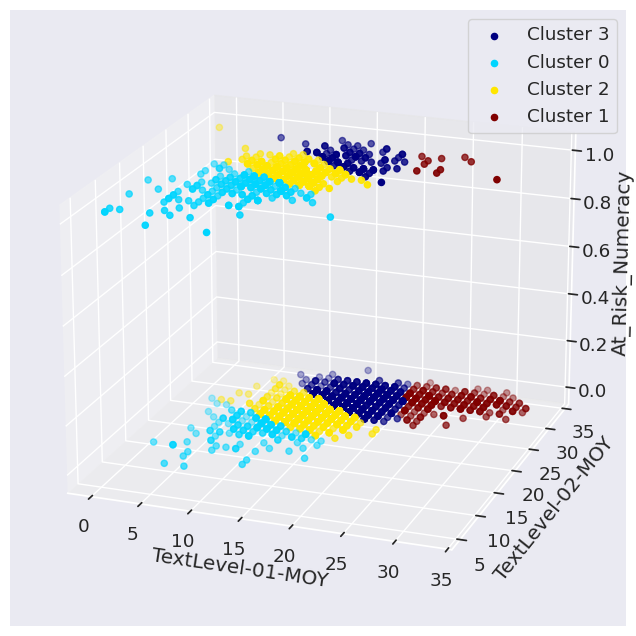

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

# Create a new figure
fig = plt.figure(figsize=(12, 8))

# Add 3D subplot
# The '111' means 1x1 grid, first subplot, similar to MATLAB-style
ax = fig.add_subplot(111, projection='3d')

# Unique cluster labels
unique_clusters = records['Cluster'].unique()

# Color map
colors = plt.cm.jet(np.linspace(0, 1, len(unique_clusters)))

# Adjusting the viewing angle for better visibility
ax.view_init(elev=20, azim=-70)  # Modify these values as needed

# Scatter plot for each cluster
for i, cluster in enumerate(unique_clusters):
    cluster_data = records[records['Cluster'] == cluster]
    ax.scatter(cluster_data['TextLevel-01-MOY'], cluster_data['TextLevel-02-MOY'], cluster_data['At_Risk_Numeracy'],
               label=f'Cluster {cluster}', c=[colors[i]])

# Legend and labels
ax.set_xlabel('TextLevel-01-MOY')
ax.set_ylabel('TextLevel-02-MOY')
ax.set_zlabel('At_Risk_Numeracy')
ax.legend()

# Show the plot
plt.show()

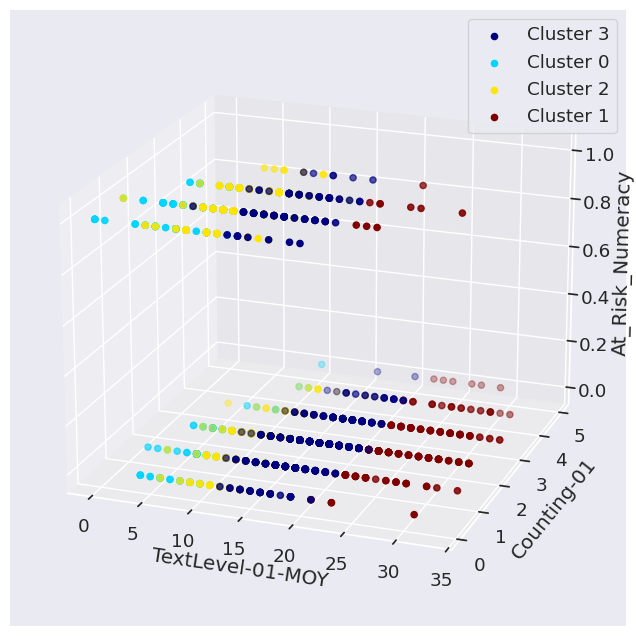

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

# Create a new figure
fig = plt.figure(figsize=(12, 8))

# Add 3D subplot
# The '111' means 1x1 grid, first subplot, similar to MATLAB-style
ax = fig.add_subplot(111, projection='3d')

# Unique cluster labels
unique_clusters = records['Cluster'].unique()

# Color map
colors = plt.cm.jet(np.linspace(0, 1, len(unique_clusters)))

# Adjusting the viewing angle for better visibility
ax.view_init(elev=20, azim=-70)  # Modify these values as needed

# Scatter plot for each cluster
for i, cluster in enumerate(unique_clusters):
    cluster_data = records[records['Cluster'] == cluster]
    ax.scatter(cluster_data['TextLevel-01-MOY'], cluster_data['Counting-01'], cluster_data['At_Risk_Numeracy'],
               label=f'Cluster {cluster}', c=[colors[i]])

# Legend and labels
ax.set_xlabel('TextLevel-01-MOY')
ax.set_ylabel('Counting-01')
ax.set_zlabel('At_Risk_Numeracy')
ax.legend()

# Show the plot
plt.show()

In [ ]:
# unique_clusters = records['Cluster'].unique()

# # Iterate over each unique cluster to create a 3D plot
# for cluster in unique_clusters:
#     fig = plt.figure(figsize=(12, 7))
#     ax = fig.add_subplot(111, projection='3d')

#     # Filter data to include only the current cluster
#     cluster_data = records[records['Cluster'] == cluster]

#     # Create 3D scatter plot
#     ax.scatter(cluster_data['Addition and Subtraction-01'], cluster_data['Multiplication and Division-01'], cluster_data['At_Risk_Numeracy'])

#     # Adjusting the viewing angle for better visibility
#     ax.view_init(elev=20, azim=-70)  # Modify these values as needed

#     # Adding title and labels
#     ax.set_title(f'Cluster {cluster}')
#     ax.set_xlabel('Addition and Subtraction-01')
#     ax.set_ylabel('Multiplication and Division-02', labelpad=10)
#     ax.set_zlabel('At-Risk_Numeracy')

#     plt.show()

TextLevel-01-MOY :

         count       mean       std   min   25%   50%   75%   max
Cluster                                                          
0        350.0   9.342857  3.285314   0.0   7.0  10.0  12.0  20.0
1        255.0  25.454902  3.209994  21.0  23.0  25.0  28.0  33.0
2        767.0  12.814863  2.682433   0.0  11.0  13.0  15.0  21.0
3        628.0  16.581210  2.537394   7.0  15.0  17.0  18.0  22.0




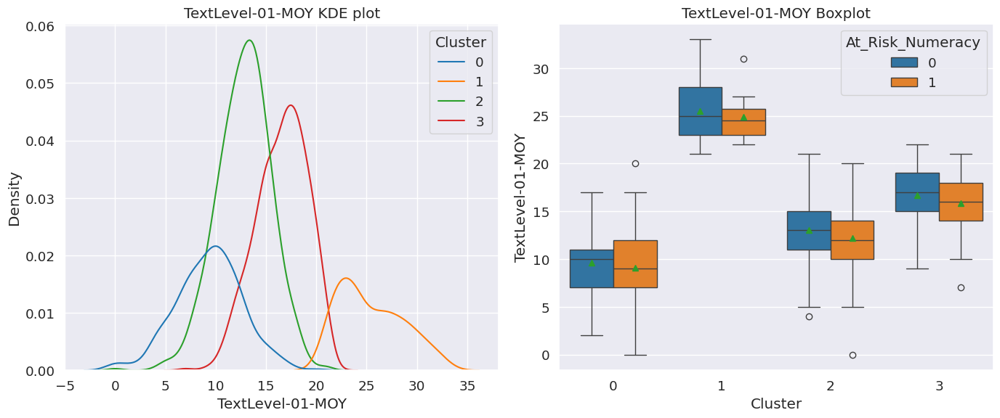

TextLevel-02-MOY :

         count       mean       std   min   25%   50%   75%   max
Cluster                                                          
0        350.0  16.822857  3.090339   5.0  16.0  17.0  19.0  23.0
1        255.0  29.325490  1.867653  23.0  28.0  30.0  31.0  33.0
2        767.0  22.844850  1.994947  18.0  21.0  23.0  24.0  32.0
3        628.0  27.480892  2.130050  22.0  26.0  28.0  29.0  34.0




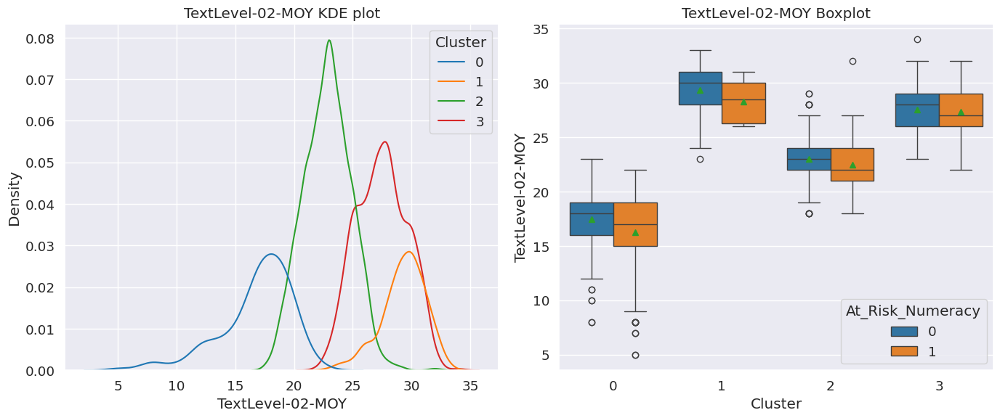

Counting-01 :

         count      mean       std  min  25%  50%  75%  max
Cluster                                                    
0        350.0  1.240000  0.811522  0.0  1.0  1.0  2.0  5.0
1        255.0  2.423529  1.008349  0.0  2.0  2.0  3.0  5.0
2        767.0  1.664928  0.813469  0.0  1.0  2.0  2.0  4.0
3        628.0  1.890127  0.920629  0.0  1.0  2.0  2.0  5.0




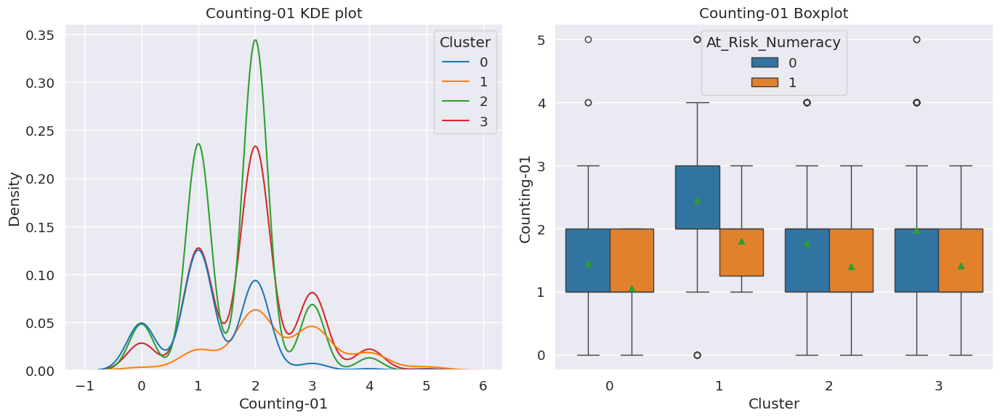

Counting-02 :

         count      mean       std  min  25%  50%  75%  max
Cluster                                                    
0        350.0  2.260000  0.983153  0.0  2.0  2.0  3.0  5.0
1        255.0  3.635294  1.029262  1.0  3.0  4.0  4.0  6.0
2        767.0  2.688396  0.977907  0.0  2.0  3.0  3.0  5.0
3        628.0  3.058917  1.006217  1.0  2.0  3.0  4.0  6.0




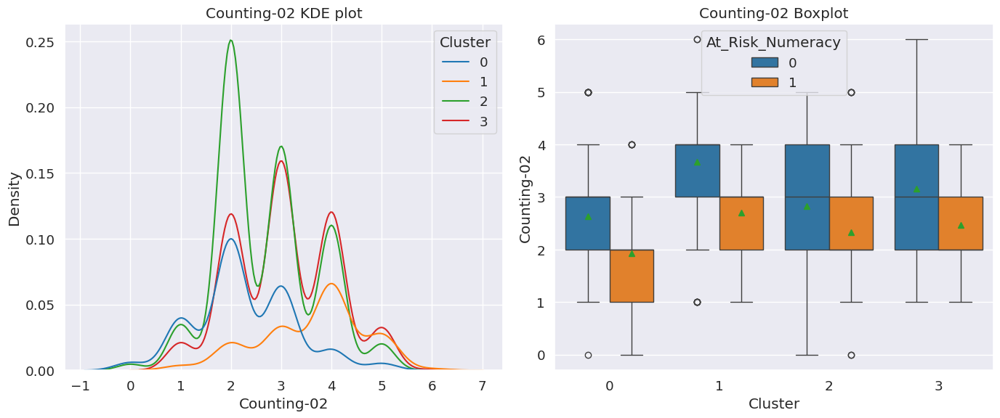

Addition and Subtraction-01 :

         count      mean       std  min  25%  50%  75%  max
Cluster                                                    
0        350.0  0.857143  0.795505  0.0  0.0  1.0  1.0  4.0
1        255.0  1.811765  1.077626  0.0  1.0  2.0  2.0  5.0
2        767.0  1.177314  0.817470  0.0  1.0  1.0  2.0  5.0
3        628.0  1.458599  0.943308  0.0  1.0  1.0  2.0  5.0




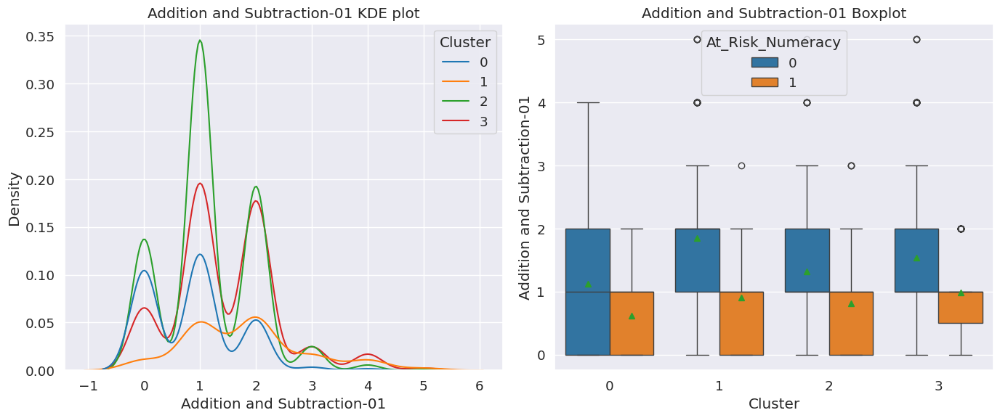

Multiplication and Division-01 :

         count      mean       std  min  25%  50%  75%  max
Cluster                                                    
0        350.0  0.757143  0.805349  0.0  0.0  1.0  1.0  2.0
1        255.0  1.356863  0.814547  0.0  1.0  2.0  2.0  3.0
2        767.0  1.053455  0.819801  0.0  0.0  1.0  2.0  4.0
3        628.0  1.165605  0.830804  0.0  0.0  1.0  2.0  3.0




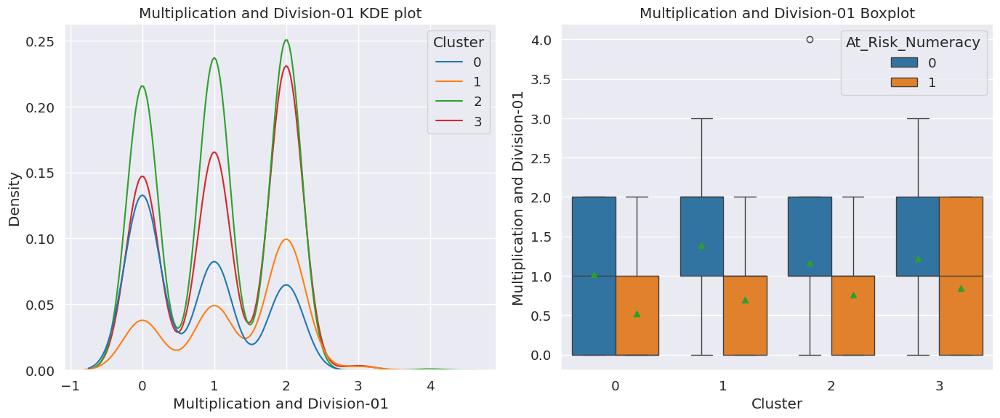

Addition and Subtraction-02 :

         count      mean       std  min  25%  50%  75%  max
Cluster                                                    
0        350.0  1.680000  0.993042  0.0  1.0  2.0  2.0  5.0
1        255.0  2.905882  1.303752  0.0  2.0  2.0  4.0  5.0
2        767.0  2.136897  1.045084  0.0  2.0  2.0  3.0  5.0
3        628.0  2.463376  1.126849  0.0  2.0  2.0  3.0  6.0




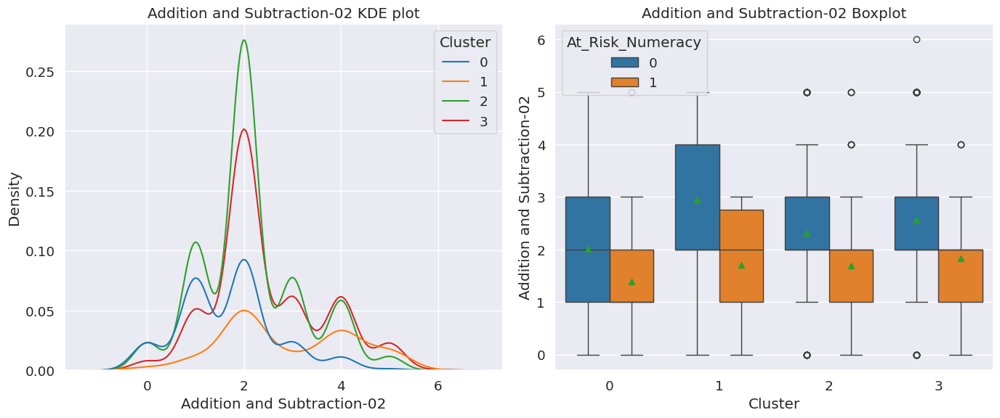

Multiplication and Division-02 :

         count      mean       std  min  25%  50%  75%  max
Cluster                                                    
0        350.0  1.491429  0.763558  0.0  1.0  2.0  2.0  4.0
1        255.0  2.164706  0.858222  0.0  2.0  2.0  2.0  5.0
2        767.0  1.766623  0.696153  0.0  2.0  2.0  2.0  4.0
3        628.0  1.856688  0.756789  0.0  2.0  2.0  2.0  5.0




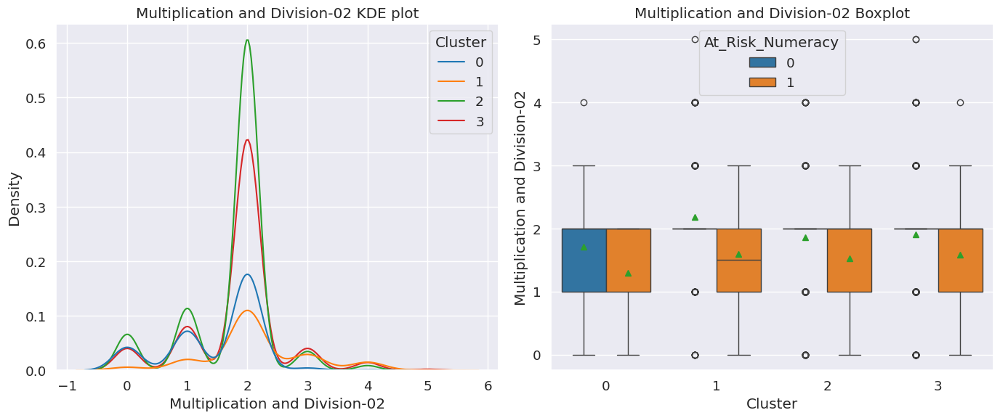

In [ ]:
nums=['TextLevel-01-MOY', 'TextLevel-02-MOY', 'Counting-01','Counting-02','Addition and Subtraction-01','Multiplication and Division-01','Addition and Subtraction-02','Multiplication and Division-02']
for i in nums:
  print(i, ':\n')
  print(records.groupby('Cluster')[i].describe())
  print('\n')

  # Create subplots
  fig, axes = plt.subplots(1, 2, figsize=(14, 6))

  # Plot KDE on the first subplot
  sns.kdeplot(data=records, x=i, hue='Cluster', palette='tab10', ax=axes[0])
  axes[0].set_title(f'{i} KDE plot')

  # Plot Boxplot on the second subplot
  sns.boxplot(data=records, x='Cluster', y=i, hue='At_Risk_Numeracy', showmeans=True, ax=axes[1])
  axes[1].set_title(f'{i} Boxplot')

  plt.tight_layout()  # Adjust layout so plots do not overlap
  plt.show()

In [ ]:
# sns.clustermap(data=records[['Counting-02','Place Value-02', 'Addition and Subtraction-01','Addition and Subtraction-02','Cluster']].corr(), cmap="Blues", linewidths=.9, annot=True)

In [ ]:
# sns.clustermap(data=records[['Counting-02','Place Value-02', 'Addition and Subtraction-01','Addition and Subtraction-02','Cluster', 'At_Risk_Numeracy']].corr(), cmap="Blues", linewidths=.9, annot=True)